In [ ]:
!pip install darts
!pip install utils

In [ ]:
# # fix python path if working locally
# from utils import fix_pythonpath_if_working_locally

# fix_pythonpath_if_working_locally()

In [ ]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import pandas as pd
import shutil
from sklearn.preprocessing import MinMaxScaler
from tqdm import tqdm_notebook as tqdm
import matplotlib.pyplot as plt

from darts import TimeSeries
from darts.dataprocessing.transformers import Scaler
from darts.models import RNNModel, ExponentialSmoothing, BlockRNNModel
from darts.metrics import mape
from darts.utils.statistics import check_seasonality, plot_acf
from darts.datasets import AirPassengersDataset, SunspotsDataset
from darts.utils.timeseries_generation import datetime_attribute_timeseries

import warnings

warnings.filterwarnings("ignore")
import logging

logging.disable(logging.CRITICAL)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
file_path = '/content/drive/MyDrive/Datasets/processed_dataset(3).csv'
data = pd.read_csv(file_path)

data = data.set_index('Date')
data.index = pd.to_datetime(data.index)

In [ ]:
split_date = pd.to_datetime('2019-12-31 23:59')
data = data[data.index >= split_date]

In [ ]:
# data['Temperature t+24'] = data['Temperature'].shift(periods=-24)
# data['Humidity t+24'] = data['Humidity'].shift(periods=-24)
data['Year'] = data.index.year
# data['Year t+24'] = data['Year'].shift(periods=-24)
data['Month'] = data.index.month

In [ ]:
data_sin = data[['SIN']]
data_cov = data[['Temperature', 'Humidity', 'Year', 'Month']]

In [ ]:
series = TimeSeries.from_dataframe(data_sin, value_cols=["SIN"])
covariates = TimeSeries.from_dataframe(data_cov, value_cols=["Temperature", "Humidity", "Year", "Month"])
series = series.astype(np.float32)
covariates = covariates.astype(np.float32)

In [ ]:
# # Create training and validation sets:
training_cutoff = pd.Timestamp("20211231T230000")
train, val = series.split_after(training_cutoff)

In [ ]:
print(train)

<TimeSeries (DataArray) (Date: 17544, component: 1, sample: 1)>
array([[[2195.]],

       [[2254.]],

       [[2308.]],

       ...,

       [[3216.]],

       [[2854.]],

       [[2725.]]], dtype=float32)
Coordinates:
  * Date       (Date) datetime64[ns] 2020-01-01 ... 2021-12-31T23:00:00
  * component  (component) object 'SIN'
Dimensions without coordinates: sample
Attributes:
    static_covariates:  None
    hierarchy:          None


In [ ]:
print(val)

<TimeSeries (DataArray) (Date: 8760, component: 1, sample: 1)>
array([[[2680.]],

       [[2651.]],

       [[2596.]],

       ...,

       [[3454.]],

       [[3120.]],

       [[2922.]]], dtype=float32)
Coordinates:
  * Date       (Date) datetime64[ns] 2022-01-01 ... 2022-12-31T23:00:00
  * component  (component) object 'SIN'
Dimensions without coordinates: sample
Attributes:
    static_covariates:  None
    hierarchy:          None


In [ ]:
# Normalize the time series (note: we avoid fitting the transformer on the validation set)
transformer = Scaler()
train_transformed = transformer.fit_transform(train)
val_transformed = transformer.transform(val)
series_transformed = transformer.transform(series)

In [ ]:
covariates = covariates.stack(
    TimeSeries.from_times_and_values(
        times=series.time_index,
        values=np.arange(len(series)),
        columns=["linear_increase"],
    )
)
covariates = covariates.astype(np.float32)
cov_train, cov_val = covariates.split_after(training_cutoff)

In [ ]:
# transform covariates (note: we fit the transformer on train split and can then transform the entire covariates series)
scaler_covs = Scaler()
cov_train, cov_val = covariates.split_after(training_cutoff)
scaler_covs.fit(cov_train)
covariates_transformed = scaler_covs.transform(covariates)

In [ ]:
my_model = RNNModel(
    model="LSTM",
    hidden_dim=20,
    dropout=0,
    batch_size=24,
    n_epochs=100,
    optimizer_kwargs={"lr": 1e-3},
    model_name="LSTM_Load",
    log_tensorboard=True,
    random_state=42,
    # training_length=672,
    input_chunk_length=8760,
    force_reset=True,
    save_checkpoints=True,
)

In [ ]:
my_model.fit(
    train_transformed,
    future_covariates=covariates,
    val_series=val_transformed,
    val_future_covariates=covariates,
    verbose=True,
)

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

RNNModel(model=LSTM, hidden_dim=20, n_rnn_layers=1, dropout=0, training_length=24, batch_size=24, n_epochs=100, optimizer_kwargs={'lr': 0.001}, model_name=LSTM_Load, log_tensorboard=True, random_state=42, input_chunk_length=8760, force_reset=True, save_checkpoints=True)

In [ ]:
def eval_model(model):
    pred_series = model.predict(n=24, future_covariates=covariates)
    plt.figure(figsize=(20, 5))
    train_transformed.plot(label="actual")
    pred_series.plot(label="forecast")
    plt.title("MAPE: {:.2f}%".format(mape(pred_series, val_transformed)))
    plt.legend()


eval_model(my_model)

In [ ]:
not_used, plot_val_trans = val_transformed.split_after(pd.Timestamp("20220101T000000"))
plot_val_trans, not_used = val_transformed.split_after(pd.Timestamp("20220101T230000"))
print(plot_val_trans)

<TimeSeries (DataArray) (Date: 24, component: 1, sample: 1)>
array([[[0.6127379 ]],

       [[0.602123  ]],

       [[0.5819912 ]],

       [[0.5512445 ]],

       [[0.45607612]],

       [[0.42679355]],

       [[0.44289896]],

       [[0.46229866]],

       [[0.49084917]],

       [[0.50475836]],

...

       [[0.6153002 ]],

       [[0.5592972 ]],

       [[0.5468521 ]],

       [[0.51537335]],

       [[0.59919477]],

       [[0.75      ]],

       [[0.7829429 ]],

       [[0.80380666]],

       [[0.7803806 ]],

       [[0.80380666]]], dtype=float32)
Coordinates:
  * Date       (Date) datetime64[ns] 2022-01-01 ... 2022-01-01T23:00:00
  * component  (component) object 'SIN'
Dimensions without coordinates: sample
Attributes:
    static_covariates:  None
    hierarchy:          None


Predicting: 0it [00:00, ?it/s]

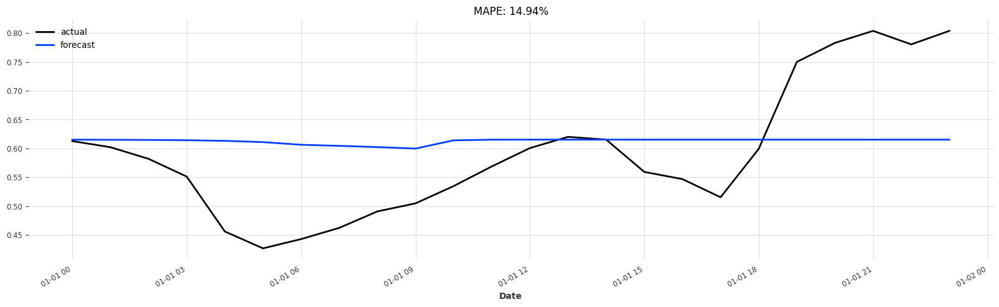

In [ ]:
pred_series = my_model.predict(n=24, future_covariates=covariates)
plt.figure(figsize=(20, 5))
plot_val_trans.plot(label="actual")
pred_series.plot(label="forecast")
plt.title("MAPE: {:.2f}%".format(mape(pred_series, val_transformed)))
plt.legend()


In [ ]:
print(pred_series)

<TimeSeries (DataArray) (Date: 24, component: 1, sample: 1)>
array([[[0.61515594]],

       [[0.6150015 ]],

       [[0.61474884]],

       [[0.6142424 ]],

       [[0.6131661 ]],

       [[0.6109476 ]],

       [[0.6063906 ]],

       [[0.60449016]],

       [[0.60234225]],

       [[0.5997703 ]],

...

       [[0.61525273]],

       [[0.61525285]],

       [[0.61525285]],

       [[0.61525285]],

       [[0.61525285]],

       [[0.61525285]],

       [[0.61525285]],

       [[0.61525285]],

       [[0.6152525 ]],

       [[0.6152487 ]]], dtype=float32)
Coordinates:
  * Date       (Date) datetime64[ns] 2022-01-01 ... 2022-01-01T23:00:00
  * component  (component) object 'SIN'
Dimensions without coordinates: sample
Attributes:
    static_covariates:  None
    hierarchy:          None


Predicting: 0it [00:00, ?it/s]

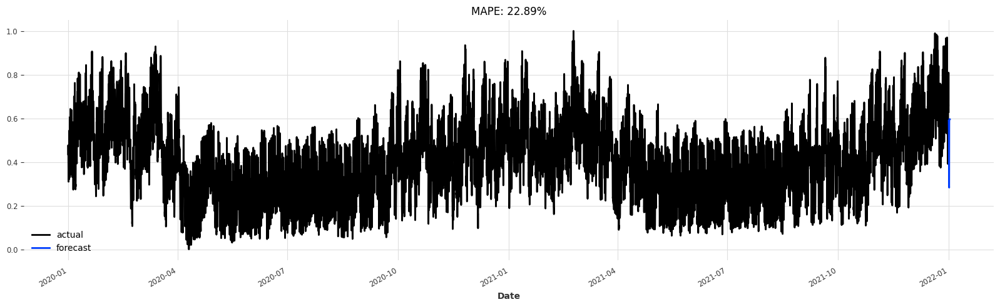

In [ ]:
best_model = RNNModel.load_from_checkpoint(model_name="LSTM_Load", best=True)
eval_model(best_model)

In [ ]:
backtest_series = my_model.historical_forecasts(
    series_transformed,
    future_covariates=covariates,
    start=pd.Timestamp("20220101"),
    forecast_horizon=6,
    retrain=False,
    verbose=True,
)

  0%|          | 0/8755 [00:00<?, ?it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 1/8755 [00:00<16:28,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 2/8755 [00:00<16:33,  8.81it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 3/8755 [00:00<17:28,  8.35it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 4/8755 [00:00<16:57,  8.60it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 5/8755 [00:00<16:57,  8.60it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 7/8755 [00:00<15:39,  9.32it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 8/8755 [00:00<16:21,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 9/8755 [00:01<16:28,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 10/8755 [00:01<17:44,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 11/8755 [00:01<17:59,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 12/8755 [00:01<18:33,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 13/8755 [00:01<19:54,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 14/8755 [00:01<19:24,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 15/8755 [00:01<20:21,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 16/8755 [00:01<19:07,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 17/8755 [00:02<17:58,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 18/8755 [00:02<17:03,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 19/8755 [00:02<17:35,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 20/8755 [00:02<18:25,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 21/8755 [00:02<17:25,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 22/8755 [00:02<16:37,  8.75it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 23/8755 [00:02<16:20,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 24/8755 [00:02<16:09,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 25/8755 [00:02<16:01,  9.08it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 26/8755 [00:03<17:26,  8.34it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 27/8755 [00:03<16:57,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 28/8755 [00:03<17:09,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 29/8755 [00:03<18:29,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 30/8755 [00:03<20:19,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 31/8755 [00:03<19:40,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 32/8755 [00:03<19:03,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 33/8755 [00:04<18:05,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 34/8755 [00:04<17:20,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 35/8755 [00:04<17:31,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 36/8755 [00:04<17:22,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 37/8755 [00:04<16:38,  8.73it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 38/8755 [00:04<16:50,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 39/8755 [00:04<16:13,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 40/8755 [00:04<15:54,  9.13it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 41/8755 [00:04<15:35,  9.32it/s]

Predicting: 0it [00:00, ?it/s]

  0%|          | 42/8755 [00:05<15:33,  9.34it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 44/8755 [00:05<14:59,  9.68it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 45/8755 [00:05<15:07,  9.60it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 46/8755 [00:05<16:45,  8.66it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 47/8755 [00:05<16:32,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 48/8755 [00:05<17:50,  8.14it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 49/8755 [00:05<17:30,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 50/8755 [00:05<17:05,  8.49it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 51/8755 [00:06<16:46,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 52/8755 [00:06<17:34,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 53/8755 [00:06<18:34,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 54/8755 [00:06<18:21,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 55/8755 [00:06<19:32,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 56/8755 [00:06<19:48,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 57/8755 [00:06<19:46,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 58/8755 [00:07<19:36,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 59/8755 [00:07<18:55,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 60/8755 [00:07<18:01,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 61/8755 [00:07<19:01,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 62/8755 [00:07<20:47,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 63/8755 [00:07<21:00,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 64/8755 [00:07<20:59,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 65/8755 [00:08<21:09,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 66/8755 [00:08<20:30,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 67/8755 [00:08<21:06,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 68/8755 [00:08<21:46,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 69/8755 [00:08<21:49,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 70/8755 [00:08<21:47,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 71/8755 [00:08<22:26,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 72/8755 [00:09<21:47,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 73/8755 [00:09<21:39,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 74/8755 [00:09<22:20,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 75/8755 [00:09<21:44,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 76/8755 [00:09<21:28,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 77/8755 [00:09<22:23,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 78/8755 [00:09<22:27,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 79/8755 [00:10<22:40,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 80/8755 [00:10<23:53,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 81/8755 [00:10<24:20,  5.94it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 82/8755 [00:10<24:18,  5.95it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 83/8755 [00:10<24:52,  5.81it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 84/8755 [00:11<23:49,  6.06it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 85/8755 [00:11<21:53,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 86/8755 [00:11<20:53,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 87/8755 [00:11<21:42,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 88/8755 [00:11<20:38,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 89/8755 [00:11<19:59,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 90/8755 [00:11<18:45,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 91/8755 [00:11<18:01,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 92/8755 [00:12<17:25,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 93/8755 [00:12<18:07,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 94/8755 [00:12<17:32,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 95/8755 [00:12<17:11,  8.40it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 96/8755 [00:12<16:48,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 97/8755 [00:12<16:46,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 98/8755 [00:12<17:38,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 99/8755 [00:12<17:00,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 100/8755 [00:13<18:45,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 101/8755 [00:13<19:53,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 102/8755 [00:13<20:56,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 103/8755 [00:13<22:33,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 104/8755 [00:13<24:10,  5.96it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 105/8755 [00:13<23:01,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 106/8755 [00:13<21:56,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 107/8755 [00:14<22:33,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 108/8755 [00:14<21:35,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

  1%|          | 109/8755 [00:14<21:07,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 110/8755 [00:14<20:18,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 111/8755 [00:14<19:40,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 112/8755 [00:14<20:56,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 113/8755 [00:14<19:59,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 114/8755 [00:15<19:41,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 115/8755 [00:15<19:14,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 116/8755 [00:15<20:14,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 117/8755 [00:15<20:10,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 118/8755 [00:15<19:22,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 119/8755 [00:15<18:21,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 120/8755 [00:15<17:38,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 121/8755 [00:15<16:59,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 122/8755 [00:16<16:40,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 123/8755 [00:16<16:26,  8.75it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 124/8755 [00:16<18:02,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 125/8755 [00:16<17:43,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 126/8755 [00:16<17:44,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 127/8755 [00:16<17:16,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 128/8755 [00:16<16:58,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 129/8755 [00:16<16:34,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 130/8755 [00:17<16:05,  8.93it/s]

Predicting: 0it [00:00, ?it/s]

  1%|▏         | 131/8755 [00:17<15:55,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 132/8755 [00:17<15:59,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 133/8755 [00:17<16:52,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 134/8755 [00:17<16:46,  8.57it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 135/8755 [00:17<17:06,  8.40it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 136/8755 [00:17<16:46,  8.56it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 137/8755 [00:17<16:23,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 138/8755 [00:17<16:02,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 139/8755 [00:18<15:46,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 140/8755 [00:18<15:48,  9.08it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 141/8755 [00:18<15:57,  9.00it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 142/8755 [00:18<16:13,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 143/8755 [00:18<16:30,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 144/8755 [00:18<16:15,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 145/8755 [00:18<17:55,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 146/8755 [00:18<19:43,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 147/8755 [00:19<19:17,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 148/8755 [00:19<20:42,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 149/8755 [00:19<21:32,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 150/8755 [00:19<21:20,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 151/8755 [00:19<21:01,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 152/8755 [00:19<21:09,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 153/8755 [00:19<20:32,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 154/8755 [00:20<19:18,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 155/8755 [00:20<18:51,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 156/8755 [00:20<18:11,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 157/8755 [00:20<19:13,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 158/8755 [00:20<18:17,  7.83it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 159/8755 [00:20<17:32,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 160/8755 [00:20<17:24,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 161/8755 [00:20<18:12,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 162/8755 [00:21<19:52,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 163/8755 [00:21<21:02,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 164/8755 [00:21<19:12,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 166/8755 [00:21<18:46,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 167/8755 [00:21<19:27,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 168/8755 [00:21<20:14,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 169/8755 [00:22<20:52,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 170/8755 [00:22<20:16,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 171/8755 [00:22<19:19,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 172/8755 [00:22<18:01,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 173/8755 [00:22<17:17,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 174/8755 [00:22<17:07,  8.35it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 175/8755 [00:22<16:53,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 176/8755 [00:22<18:24,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 177/8755 [00:23<17:35,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 178/8755 [00:23<17:19,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 179/8755 [00:23<18:29,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 180/8755 [00:23<19:59,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 181/8755 [00:23<21:10,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 182/8755 [00:23<20:32,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 183/8755 [00:23<21:15,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 184/8755 [00:24<21:29,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 185/8755 [00:24<21:24,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 186/8755 [00:24<20:27,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 187/8755 [00:24<19:03,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 188/8755 [00:24<17:54,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 189/8755 [00:24<18:51,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 190/8755 [00:24<18:20,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 191/8755 [00:24<17:42,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 192/8755 [00:25<17:59,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 193/8755 [00:25<16:53,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 194/8755 [00:25<16:06,  8.86it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 196/8755 [00:25<15:08,  9.42it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 197/8755 [00:25<15:21,  9.28it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 198/8755 [00:25<15:14,  9.36it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 199/8755 [00:25<17:03,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 200/8755 [00:26<19:05,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 201/8755 [00:26<19:35,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 202/8755 [00:26<20:16,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 203/8755 [00:26<19:42,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 205/8755 [00:26<20:17,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 206/8755 [00:26<21:27,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 207/8755 [00:27<21:35,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 208/8755 [00:27<21:51,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 209/8755 [00:27<22:41,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 210/8755 [00:27<21:47,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 211/8755 [00:27<20:56,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 212/8755 [00:27<20:15,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 213/8755 [00:27<20:49,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 214/8755 [00:28<20:46,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 215/8755 [00:28<21:13,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 216/8755 [00:28<21:39,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 217/8755 [00:28<21:20,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

  2%|▏         | 218/8755 [00:28<20:47,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 219/8755 [00:28<20:56,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 224/8755 [00:29<23:05,  6.16it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 225/8755 [00:29<22:18,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 226/8755 [00:30<22:30,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 227/8755 [00:30<22:09,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 228/8755 [00:30<21:25,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 229/8755 [00:30<20:12,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 230/8755 [00:30<19:52,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 231/8755 [00:30<19:50,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 232/8755 [00:30<18:57,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 233/8755 [00:30<18:13,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 234/8755 [00:31<46:36,  3.05it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 235/8755 [00:31<40:07,  3.54it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 236/8755 [00:32<35:27,  4.00it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 237/8755 [00:32<30:17,  4.69it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 238/8755 [00:32<25:38,  5.53it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 239/8755 [00:32<23:18,  6.09it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 240/8755 [00:32<21:56,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 241/8755 [00:32<21:28,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 242/8755 [00:32<20:53,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 243/8755 [00:32<19:52,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 244/8755 [00:33<19:44,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 245/8755 [00:33<20:44,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 246/8755 [00:33<21:30,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 247/8755 [00:33<20:59,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 248/8755 [00:33<20:08,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 249/8755 [00:33<19:46,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 250/8755 [00:33<20:34,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 251/8755 [00:34<20:23,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 252/8755 [00:34<21:06,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 253/8755 [00:34<21:11,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 254/8755 [00:34<22:57,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 255/8755 [00:34<21:37,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 256/8755 [00:34<22:16,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 257/8755 [00:35<21:52,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 258/8755 [00:35<21:48,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 259/8755 [00:35<21:55,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 260/8755 [00:35<21:43,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 261/8755 [00:35<20:59,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 262/8755 [00:35<20:56,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 263/8755 [00:35<20:09,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 264/8755 [00:36<19:01,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 265/8755 [00:36<17:59,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 266/8755 [00:36<17:54,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 267/8755 [00:36<18:30,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 268/8755 [00:36<18:56,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 269/8755 [00:36<19:22,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 270/8755 [00:36<19:34,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 271/8755 [00:37<19:48,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 272/8755 [00:37<20:03,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 273/8755 [00:37<20:39,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 274/8755 [00:37<20:41,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 275/8755 [00:37<20:22,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 276/8755 [00:37<21:35,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 277/8755 [00:37<19:59,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 278/8755 [00:38<18:32,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 279/8755 [00:38<17:29,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 280/8755 [00:38<17:23,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 281/8755 [00:38<16:41,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 282/8755 [00:38<16:48,  8.40it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 283/8755 [00:38<16:48,  8.40it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 284/8755 [00:38<16:35,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 285/8755 [00:38<16:46,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 286/8755 [00:38<16:22,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 287/8755 [00:39<16:14,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 288/8755 [00:39<17:05,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 289/8755 [00:39<17:36,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 290/8755 [00:39<19:49,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 291/8755 [00:39<20:54,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 292/8755 [00:39<20:45,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 293/8755 [00:39<20:29,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 294/8755 [00:40<21:32,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 295/8755 [00:40<21:30,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 296/8755 [00:40<21:32,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 297/8755 [00:40<21:04,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 298/8755 [00:40<21:55,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 299/8755 [00:40<21:42,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 300/8755 [00:41<21:35,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 301/8755 [00:41<20:34,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 302/8755 [00:41<19:48,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 303/8755 [00:41<19:13,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 304/8755 [00:41<18:59,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 305/8755 [00:41<18:35,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

  3%|▎         | 306/8755 [00:41<19:35,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 307/8755 [00:41<19:28,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 308/8755 [00:42<18:43,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 309/8755 [00:42<18:52,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 310/8755 [00:42<19:15,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 311/8755 [00:42<19:33,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 312/8755 [00:42<19:21,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 313/8755 [00:42<19:09,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 314/8755 [00:42<20:11,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 315/8755 [00:43<19:41,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 316/8755 [00:43<21:26,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 317/8755 [00:43<21:57,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 318/8755 [00:43<20:10,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 319/8755 [00:43<18:24,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 320/8755 [00:43<18:02,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 321/8755 [00:43<18:37,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 322/8755 [00:44<17:49,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 323/8755 [00:44<17:21,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 324/8755 [00:44<17:59,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 325/8755 [00:44<17:08,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 326/8755 [00:44<16:16,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 327/8755 [00:44<17:12,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▎         | 328/8755 [00:44<16:36,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 329/8755 [00:44<17:01,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 330/8755 [00:44<17:18,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 331/8755 [00:45<18:05,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 332/8755 [00:45<17:48,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 333/8755 [00:45<17:57,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 346/8755 [00:47<19:41,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 347/8755 [00:47<19:31,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 348/8755 [00:47<20:24,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 349/8755 [00:47<21:29,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 350/8755 [00:47<21:53,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 351/8755 [00:47<22:15,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 352/8755 [00:48<21:56,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 353/8755 [00:48<21:50,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 354/8755 [00:48<21:23,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 355/8755 [00:48<22:01,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 356/8755 [00:48<22:11,  6.31it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 357/8755 [00:48<22:51,  6.12it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 358/8755 [00:49<22:13,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 359/8755 [00:49<22:08,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 360/8755 [00:49<21:55,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 365/8755 [00:50<19:40,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 366/8755 [00:50<18:31,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 367/8755 [00:50<17:31,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 368/8755 [00:50<16:42,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 369/8755 [00:50<16:13,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 370/8755 [00:50<16:10,  8.64it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 371/8755 [00:50<15:54,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 372/8755 [00:50<15:51,  8.81it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 373/8755 [00:51<15:31,  9.00it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 374/8755 [00:51<15:29,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 375/8755 [00:51<15:35,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 376/8755 [00:51<15:23,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 377/8755 [00:51<15:32,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 378/8755 [00:51<15:31,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 379/8755 [00:51<15:22,  9.08it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 380/8755 [00:51<15:09,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 391/8755 [00:53<15:12,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 392/8755 [00:53<14:58,  9.31it/s]

Predicting: 0it [00:00, ?it/s]

  4%|▍         | 393/8755 [00:53<15:00,  9.28it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 394/8755 [00:53<15:42,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 395/8755 [00:53<15:26,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 396/8755 [00:53<15:13,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 397/8755 [00:53<15:29,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 398/8755 [00:53<15:12,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 399/8755 [00:53<15:24,  9.04it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 400/8755 [00:54<16:40,  8.35it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 401/8755 [00:54<17:07,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 402/8755 [00:54<18:49,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 403/8755 [00:54<19:29,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 404/8755 [00:54<18:57,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 405/8755 [00:54<18:30,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 406/8755 [00:54<18:53,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 408/8755 [00:55<20:23,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 409/8755 [00:55<19:22,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 410/8755 [00:55<19:17,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 411/8755 [00:55<19:50,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 412/8755 [00:55<19:00,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 413/8755 [00:55<18:17,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 414/8755 [00:55<17:25,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 415/8755 [00:56<16:48,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 416/8755 [00:56<16:19,  8.52it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 417/8755 [00:56<16:06,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 418/8755 [00:56<17:01,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 419/8755 [00:56<16:46,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 420/8755 [00:56<17:10,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 421/8755 [00:56<17:36,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 422/8755 [00:56<17:41,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 424/8755 [00:57<19:25,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 425/8755 [00:57<19:06,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 426/8755 [00:57<19:34,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 427/8755 [00:57<20:25,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 428/8755 [00:57<20:43,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 429/8755 [00:57<20:26,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 430/8755 [00:58<20:27,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 431/8755 [00:58<18:53,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 432/8755 [00:58<18:30,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 433/8755 [00:58<18:16,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 434/8755 [00:58<18:28,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 435/8755 [00:58<17:59,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 436/8755 [00:58<18:01,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▍         | 437/8755 [00:59<18:02,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 438/8755 [00:59<17:16,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 439/8755 [00:59<16:53,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 440/8755 [00:59<17:29,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 441/8755 [00:59<18:13,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 442/8755 [00:59<20:43,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 443/8755 [00:59<19:37,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 444/8755 [00:59<18:50,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 445/8755 [01:00<18:38,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 446/8755 [01:00<18:59,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 447/8755 [01:00<18:55,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 448/8755 [01:00<18:17,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 449/8755 [01:00<19:21,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 450/8755 [01:00<19:49,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 451/8755 [01:00<20:42,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 452/8755 [01:01<19:25,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 453/8755 [01:01<19:39,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 456/8755 [01:01<18:39,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 457/8755 [01:01<18:39,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 458/8755 [01:01<18:47,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 459/8755 [01:02<18:20,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 460/8755 [01:02<17:37,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 461/8755 [01:02<16:55,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 462/8755 [01:02<18:55,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 463/8755 [01:02<18:32,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 464/8755 [01:02<17:14,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 465/8755 [01:02<16:48,  8.22it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 466/8755 [01:02<16:49,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 467/8755 [01:02<16:01,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 469/8755 [01:03<15:33,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

  5%|▌         | 470/8755 [01:03<15:28,  8.93it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 490/8755 [01:05<18:35,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 491/8755 [01:05<19:21,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 492/8755 [01:06<19:51,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 493/8755 [01:06<19:58,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 494/8755 [01:06<20:12,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 495/8755 [01:06<20:35,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 496/8755 [01:06<20:12,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 497/8755 [01:06<20:40,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 498/8755 [01:06<21:16,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 499/8755 [01:07<20:47,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 500/8755 [01:07<21:27,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 501/8755 [01:07<21:33,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 502/8755 [01:07<21:42,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 503/8755 [01:07<22:26,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 504/8755 [01:07<21:13,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 505/8755 [01:08<21:05,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 511/8755 [01:08<21:01,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 512/8755 [01:09<21:47,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 513/8755 [01:09<21:17,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 514/8755 [01:09<19:47,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 515/8755 [01:09<18:23,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 516/8755 [01:09<17:11,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 517/8755 [01:09<16:44,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 518/8755 [01:09<18:41,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 519/8755 [01:10<17:54,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 520/8755 [01:10<18:12,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 521/8755 [01:10<17:29,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 522/8755 [01:10<17:00,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 523/8755 [01:10<16:33,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 524/8755 [01:10<16:21,  8.39it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 525/8755 [01:10<16:15,  8.43it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 527/8755 [01:10<15:53,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 528/8755 [01:11<15:48,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 529/8755 [01:11<17:58,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 530/8755 [01:11<17:44,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 531/8755 [01:11<17:40,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 532/8755 [01:11<16:44,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 533/8755 [01:11<16:11,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 534/8755 [01:11<15:45,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 535/8755 [01:11<15:32,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 536/8755 [01:12<15:11,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 537/8755 [01:12<14:52,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 538/8755 [01:12<15:55,  8.60it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 539/8755 [01:12<16:17,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 540/8755 [01:12<15:47,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 541/8755 [01:12<15:23,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 544/8755 [01:12<17:08,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 545/8755 [01:13<16:33,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 546/8755 [01:13<18:14,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▌         | 547/8755 [01:13<18:12,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 549/8755 [01:13<16:28,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 550/8755 [01:13<16:10,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 551/8755 [01:13<15:43,  8.70it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 552/8755 [01:13<16:48,  8.14it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 553/8755 [01:14<16:26,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 554/8755 [01:14<16:22,  8.35it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 555/8755 [01:14<17:50,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 556/8755 [01:14<19:17,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 557/8755 [01:14<19:49,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 558/8755 [01:14<19:16,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 559/8755 [01:14<19:03,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 560/8755 [01:15<19:14,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 561/8755 [01:15<19:54,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 562/8755 [01:15<20:26,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 563/8755 [01:15<21:00,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 564/8755 [01:15<21:35,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 565/8755 [01:15<22:02,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 566/8755 [01:16<21:11,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 567/8755 [01:16<20:51,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 568/8755 [01:16<20:42,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

  6%|▋         | 569/8755 [01:16<19:36,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 570/8755 [01:16<19:04,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 571/8755 [01:16<19:46,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 572/8755 [01:16<19:12,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 573/8755 [01:17<19:14,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 574/8755 [01:17<19:18,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 575/8755 [01:17<19:32,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 576/8755 [01:17<19:28,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 577/8755 [01:17<20:18,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 578/8755 [01:17<20:46,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 579/8755 [01:17<19:52,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 580/8755 [01:18<18:49,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 581/8755 [01:18<18:04,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 582/8755 [01:18<19:07,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 583/8755 [01:18<18:17,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 584/8755 [01:18<19:20,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 585/8755 [01:18<18:24,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 586/8755 [01:18<19:15,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 587/8755 [01:19<20:15,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 588/8755 [01:19<20:09,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 589/8755 [01:19<21:06,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 590/8755 [01:19<19:37,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 591/8755 [01:19<18:18,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 592/8755 [01:19<18:11,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 593/8755 [01:19<18:25,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 594/8755 [01:19<18:34,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 595/8755 [01:20<18:11,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 596/8755 [01:20<16:55,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 597/8755 [01:20<16:22,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 598/8755 [01:20<18:25,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 599/8755 [01:20<18:25,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 600/8755 [01:20<17:17,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 602/8755 [01:20<15:42,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 603/8755 [01:21<16:05,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 604/8755 [01:21<16:52,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 605/8755 [01:21<17:50,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 606/8755 [01:21<17:40,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 607/8755 [01:21<17:27,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 608/8755 [01:21<17:13,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 609/8755 [01:21<18:32,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 610/8755 [01:22<19:33,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 611/8755 [01:22<18:16,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 612/8755 [01:22<17:30,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 613/8755 [01:22<17:33,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 614/8755 [01:22<18:06,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 615/8755 [01:22<17:36,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 616/8755 [01:22<17:00,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 617/8755 [01:22<16:01,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 618/8755 [01:23<17:45,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 619/8755 [01:23<17:21,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 620/8755 [01:23<17:15,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 621/8755 [01:23<16:28,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 632/8755 [01:24<20:31,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 633/8755 [01:25<20:40,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 634/8755 [01:25<20:31,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 635/8755 [01:25<20:39,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 636/8755 [01:25<19:47,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 637/8755 [01:25<19:14,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 638/8755 [01:25<19:37,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 639/8755 [01:25<20:06,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 640/8755 [01:26<19:45,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 641/8755 [01:26<19:52,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 642/8755 [01:26<19:14,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 643/8755 [01:26<20:09,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 644/8755 [01:26<20:28,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 645/8755 [01:26<19:33,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 646/8755 [01:27<19:10,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 647/8755 [01:27<18:54,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 653/8755 [01:28<20:35,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 654/8755 [01:28<20:09,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 655/8755 [01:28<20:11,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  7%|▋         | 656/8755 [01:28<20:18,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 657/8755 [01:28<18:40,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 658/8755 [01:28<17:33,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 659/8755 [01:28<17:07,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 660/8755 [01:28<16:57,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 661/8755 [01:29<17:08,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 662/8755 [01:29<18:08,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 663/8755 [01:29<17:24,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 664/8755 [01:29<16:33,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 665/8755 [01:29<17:00,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 666/8755 [01:29<18:16,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 667/8755 [01:29<19:05,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 670/8755 [01:30<19:30,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 671/8755 [01:30<18:28,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 672/8755 [01:30<18:26,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 673/8755 [01:30<18:54,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 674/8755 [01:30<19:53,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 675/8755 [01:31<19:23,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 676/8755 [01:31<19:05,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 677/8755 [01:31<19:39,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 678/8755 [01:31<20:18,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 679/8755 [01:31<20:58,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 680/8755 [01:31<20:06,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 681/8755 [01:31<18:21,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 682/8755 [01:32<18:21,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 683/8755 [01:32<17:09,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 684/8755 [01:32<17:53,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 685/8755 [01:32<17:29,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 686/8755 [01:32<16:25,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 687/8755 [01:32<16:23,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 688/8755 [01:32<17:13,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 689/8755 [01:32<17:24,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 690/8755 [01:33<18:15,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 691/8755 [01:33<19:17,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 692/8755 [01:33<18:51,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 693/8755 [01:33<19:33,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 694/8755 [01:33<19:53,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 695/8755 [01:33<20:11,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 696/8755 [01:34<20:40,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 697/8755 [01:34<20:22,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 698/8755 [01:34<19:49,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 699/8755 [01:34<20:04,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 700/8755 [01:34<20:13,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 701/8755 [01:34<20:27,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 702/8755 [01:34<20:25,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 703/8755 [01:35<19:42,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 704/8755 [01:35<20:15,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 705/8755 [01:35<20:03,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 706/8755 [01:35<20:07,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 707/8755 [01:35<21:26,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 708/8755 [01:35<20:09,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 709/8755 [01:36<20:13,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 710/8755 [01:36<20:30,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 711/8755 [01:36<19:17,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 712/8755 [01:36<18:02,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 713/8755 [01:36<17:34,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 714/8755 [01:36<17:33,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 715/8755 [01:36<16:42,  8.02it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 716/8755 [01:36<16:31,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 717/8755 [01:37<18:17,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 718/8755 [01:37<18:42,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 719/8755 [01:37<20:04,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 720/8755 [01:37<20:12,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 721/8755 [01:37<19:43,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 722/8755 [01:37<20:02,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 723/8755 [01:37<19:38,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 724/8755 [01:38<20:17,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 725/8755 [01:38<20:13,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 726/8755 [01:38<21:14,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 727/8755 [01:38<21:01,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 728/8755 [01:38<21:03,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 729/8755 [01:38<20:43,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 730/8755 [01:39<19:49,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 731/8755 [01:39<19:25,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 732/8755 [01:39<19:16,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 733/8755 [01:39<20:01,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 734/8755 [01:39<19:24,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 735/8755 [01:39<18:12,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 736/8755 [01:39<17:58,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 737/8755 [01:40<18:48,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 738/8755 [01:40<17:47,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 739/8755 [01:40<18:23,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 740/8755 [01:40<17:39,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 741/8755 [01:40<18:49,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 742/8755 [01:40<20:05,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 743/8755 [01:40<18:50,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

  8%|▊         | 744/8755 [01:40<17:27,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 746/8755 [01:41<16:17,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 747/8755 [01:41<16:01,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 748/8755 [01:41<16:40,  8.00it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 749/8755 [01:41<16:09,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 750/8755 [01:41<15:29,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 751/8755 [01:41<16:46,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 752/8755 [01:41<16:29,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 753/8755 [01:42<17:44,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 754/8755 [01:42<17:38,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 755/8755 [01:42<18:09,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 756/8755 [01:42<17:25,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 757/8755 [01:42<17:42,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 758/8755 [01:42<17:48,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 759/8755 [01:42<16:48,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 760/8755 [01:42<16:46,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 761/8755 [01:43<48:47,  2.73it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 762/8755 [01:44<39:57,  3.33it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 763/8755 [01:44<33:48,  3.94it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 764/8755 [01:44<29:50,  4.46it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 765/8755 [01:44<26:33,  5.01it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▊         | 766/8755 [01:44<24:39,  5.40it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 767/8755 [01:44<24:05,  5.53it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 768/8755 [01:44<22:55,  5.81it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 769/8755 [01:45<21:55,  6.07it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 770/8755 [01:45<20:39,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 771/8755 [01:45<20:36,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 772/8755 [01:45<20:09,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 773/8755 [01:45<20:24,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 774/8755 [01:45<20:12,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 775/8755 [01:46<20:26,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 776/8755 [01:46<20:22,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 777/8755 [01:46<20:30,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 778/8755 [01:46<20:35,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 779/8755 [01:46<20:33,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 780/8755 [01:46<20:22,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 781/8755 [01:46<20:11,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 782/8755 [01:47<19:17,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 783/8755 [01:47<19:37,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 784/8755 [01:47<19:19,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 785/8755 [01:47<19:47,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 786/8755 [01:47<19:56,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 787/8755 [01:47<20:16,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 788/8755 [01:47<19:24,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 789/8755 [01:48<19:37,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 790/8755 [01:48<20:05,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 791/8755 [01:48<20:16,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 792/8755 [01:48<18:44,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 793/8755 [01:48<18:59,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 794/8755 [01:48<18:35,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 795/8755 [01:48<18:07,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 796/8755 [01:49<19:02,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 797/8755 [01:49<19:43,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 798/8755 [01:49<19:47,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 799/8755 [01:49<18:40,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 800/8755 [01:49<18:04,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 801/8755 [01:49<18:12,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 802/8755 [01:49<20:00,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 803/8755 [01:50<19:24,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 804/8755 [01:50<19:54,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 805/8755 [01:50<20:37,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 806/8755 [01:50<20:02,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 807/8755 [01:50<20:19,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 808/8755 [01:50<20:55,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 809/8755 [01:51<19:47,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 810/8755 [01:51<18:49,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 811/8755 [01:51<19:27,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 812/8755 [01:51<19:52,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 813/8755 [01:51<19:51,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 814/8755 [01:51<19:28,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 815/8755 [01:51<21:02,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 816/8755 [01:52<20:22,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 817/8755 [01:52<20:16,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 818/8755 [01:52<18:33,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 819/8755 [01:52<17:25,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 820/8755 [01:52<16:50,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 821/8755 [01:52<17:41,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 822/8755 [01:52<17:53,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 823/8755 [01:53<17:34,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 824/8755 [01:53<16:40,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 825/8755 [01:53<17:02,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 826/8755 [01:53<16:46,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 827/8755 [01:53<16:35,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 828/8755 [01:53<15:57,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 829/8755 [01:53<15:55,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 830/8755 [01:53<16:10,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

  9%|▉         | 831/8755 [01:53<16:25,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 832/8755 [01:54<16:38,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 833/8755 [01:54<18:01,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 834/8755 [01:54<18:54,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 835/8755 [01:54<18:27,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 836/8755 [01:54<18:57,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 837/8755 [01:54<18:46,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 838/8755 [01:54<18:34,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 839/8755 [01:55<18:42,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 840/8755 [01:55<18:54,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 841/8755 [01:55<18:35,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 842/8755 [01:55<18:37,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 843/8755 [01:55<18:55,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 844/8755 [01:55<17:36,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 845/8755 [01:56<19:35,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 846/8755 [01:56<19:40,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 847/8755 [01:56<21:00,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 848/8755 [01:56<19:33,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 849/8755 [01:56<18:43,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 850/8755 [01:56<19:44,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 851/8755 [01:56<19:27,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 852/8755 [01:57<18:13,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 853/8755 [01:57<19:33,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 854/8755 [01:57<19:39,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 855/8755 [01:57<19:01,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 856/8755 [01:57<17:18,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 857/8755 [01:57<16:27,  8.00it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 858/8755 [01:57<16:55,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 859/8755 [01:57<16:33,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 860/8755 [01:58<17:06,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 861/8755 [01:58<16:13,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 862/8755 [01:58<15:59,  8.22it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 863/8755 [01:58<16:40,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 864/8755 [01:58<17:04,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 865/8755 [01:58<16:07,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 866/8755 [01:58<17:38,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 867/8755 [01:59<18:45,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 868/8755 [01:59<17:46,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 869/8755 [01:59<18:19,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 870/8755 [01:59<19:11,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 871/8755 [01:59<19:18,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 872/8755 [01:59<18:25,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 873/8755 [01:59<17:15,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 874/8755 [01:59<16:41,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 10%|▉         | 875/8755 [02:00<17:20,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 876/8755 [02:00<17:15,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 877/8755 [02:00<17:41,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 878/8755 [02:00<16:57,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 879/8755 [02:00<16:52,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 880/8755 [02:00<18:31,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 881/8755 [02:00<19:16,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 882/8755 [02:01<19:00,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 883/8755 [02:01<19:46,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 884/8755 [02:01<18:29,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 885/8755 [02:01<18:12,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 886/8755 [02:01<17:10,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 887/8755 [02:01<17:13,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 888/8755 [02:01<18:11,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 889/8755 [02:02<18:37,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 890/8755 [02:02<18:19,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 891/8755 [02:02<18:44,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 892/8755 [02:02<18:33,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 893/8755 [02:02<19:25,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 894/8755 [02:02<19:46,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 895/8755 [02:02<20:09,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 896/8755 [02:03<19:32,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 897/8755 [02:03<19:02,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 898/8755 [02:03<18:34,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 899/8755 [02:03<18:55,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 900/8755 [02:03<18:49,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 901/8755 [02:03<19:24,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 902/8755 [02:03<19:57,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 903/8755 [02:04<20:28,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 906/8755 [02:04<20:07,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 907/8755 [02:04<19:53,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 908/8755 [02:04<19:44,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 909/8755 [02:05<19:28,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 910/8755 [02:05<19:38,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 911/8755 [02:05<19:25,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 912/8755 [02:05<18:57,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 913/8755 [02:05<19:02,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 914/8755 [02:05<19:57,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 915/8755 [02:05<19:22,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 916/8755 [02:06<19:57,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 917/8755 [02:06<18:18,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 918/8755 [02:06<17:09,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 10%|█         | 919/8755 [02:06<17:20,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 920/8755 [02:06<18:36,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 924/8755 [02:07<16:51,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 925/8755 [02:07<15:59,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 926/8755 [02:07<15:59,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 927/8755 [02:07<16:04,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 928/8755 [02:07<16:36,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 929/8755 [02:07<16:02,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 930/8755 [02:07<15:43,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 931/8755 [02:07<15:57,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 932/8755 [02:08<16:40,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 933/8755 [02:08<17:17,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 934/8755 [02:08<16:45,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 935/8755 [02:08<16:26,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 936/8755 [02:08<16:46,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 937/8755 [02:08<17:07,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 938/8755 [02:08<16:56,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 942/8755 [02:09<17:19,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 943/8755 [02:09<17:18,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 944/8755 [02:09<17:53,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 945/8755 [02:09<17:35,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 946/8755 [02:09<17:56,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 947/8755 [02:10<18:10,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 948/8755 [02:10<18:16,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 949/8755 [02:10<17:59,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 950/8755 [02:10<16:51,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 951/8755 [02:10<15:48,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 952/8755 [02:10<15:08,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 953/8755 [02:10<15:14,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 954/8755 [02:10<15:48,  8.22it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 955/8755 [02:11<16:30,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 956/8755 [02:11<17:09,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 957/8755 [02:11<17:27,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 959/8755 [02:11<19:56,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 960/8755 [02:11<18:45,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 961/8755 [02:11<17:07,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 962/8755 [02:12<16:16,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 963/8755 [02:12<15:30,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 964/8755 [02:12<15:30,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 965/8755 [02:12<15:23,  8.43it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 966/8755 [02:12<14:52,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 967/8755 [02:12<14:46,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 968/8755 [02:12<14:36,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 969/8755 [02:12<14:42,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 970/8755 [02:12<14:36,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 971/8755 [02:13<14:26,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 972/8755 [02:13<14:15,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 973/8755 [02:13<14:35,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 979/8755 [02:13<14:50,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 980/8755 [02:14<14:38,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 981/8755 [02:14<14:46,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 982/8755 [02:14<14:58,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 983/8755 [02:14<15:34,  8.32it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█         | 984/8755 [02:14<15:26,  8.39it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 985/8755 [02:14<15:12,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 986/8755 [02:14<15:15,  8.49it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 987/8755 [02:14<15:08,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 988/8755 [02:15<14:37,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 989/8755 [02:15<14:16,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 990/8755 [02:15<13:53,  9.32it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 991/8755 [02:15<13:49,  9.36it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 992/8755 [02:15<14:26,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 993/8755 [02:15<14:24,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 11%|█▏        | 1006/8755 [02:17<17:20,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1007/8755 [02:17<16:14,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1008/8755 [02:17<15:25,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1009/8755 [02:17<14:45,  8.75it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1010/8755 [02:17<16:10,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1011/8755 [02:17<16:59,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1012/8755 [02:17<17:11,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1013/8755 [02:18<18:03,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1014/8755 [02:18<17:34,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1015/8755 [02:18<16:38,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1016/8755 [02:18<17:51,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1017/8755 [02:18<19:13,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1018/8755 [02:18<18:08,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1019/8755 [02:18<16:54,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1020/8755 [02:19<15:47,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1039/8755 [02:21<18:51,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1040/8755 [02:21<17:36,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1041/8755 [02:21<17:23,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1042/8755 [02:21<18:23,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1043/8755 [02:21<18:58,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1044/8755 [02:22<19:18,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1045/8755 [02:22<19:26,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1046/8755 [02:22<19:37,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1047/8755 [02:22<19:32,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1048/8755 [02:22<19:26,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1049/8755 [02:22<18:39,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1050/8755 [02:22<18:42,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1051/8755 [02:23<19:26,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1052/8755 [02:23<19:09,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1053/8755 [02:23<19:56,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1062/8755 [02:24<19:44,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1063/8755 [02:25<20:22,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1064/8755 [02:25<18:51,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1065/8755 [02:25<18:24,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1066/8755 [02:25<18:59,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1067/8755 [02:25<18:43,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1068/8755 [02:25<17:32,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1069/8755 [02:25<18:44,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1070/8755 [02:26<18:32,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1071/8755 [02:26<18:25,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1072/8755 [02:26<18:19,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1073/8755 [02:26<18:48,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1074/8755 [02:26<18:49,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1075/8755 [02:26<17:47,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1076/8755 [02:26<17:04,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1077/8755 [02:27<17:50,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1078/8755 [02:27<17:02,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1079/8755 [02:27<16:34,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1080/8755 [02:27<15:46,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1081/8755 [02:27<16:04,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1082/8755 [02:27<16:44,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1083/8755 [02:27<16:12,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1084/8755 [02:27<16:27,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1085/8755 [02:28<16:47,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1086/8755 [02:28<16:55,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1087/8755 [02:28<17:59,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1088/8755 [02:28<16:49,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1089/8755 [02:28<15:48,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1090/8755 [02:28<15:25,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1091/8755 [02:28<14:57,  8.54it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1092/8755 [02:28<14:43,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1093/8755 [02:28<14:56,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 12%|█▏        | 1094/8755 [02:29<14:27,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1095/8755 [02:29<14:09,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1096/8755 [02:29<14:15,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1097/8755 [02:29<14:14,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1098/8755 [02:29<14:11,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1099/8755 [02:29<14:04,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1100/8755 [02:29<13:59,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1101/8755 [02:29<14:10,  9.00it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1102/8755 [02:30<16:08,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1103/8755 [02:30<16:57,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1104/8755 [02:30<15:55,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1105/8755 [02:30<15:51,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1106/8755 [02:30<15:09,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1107/8755 [02:30<14:38,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1109/8755 [02:30<14:14,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1110/8755 [02:30<14:08,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1111/8755 [02:31<15:25,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1112/8755 [02:31<16:11,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1113/8755 [02:31<15:28,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1114/8755 [02:31<15:17,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1115/8755 [02:31<16:15,  7.83it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1116/8755 [02:31<17:02,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1117/8755 [02:31<16:52,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1118/8755 [02:31<16:29,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1119/8755 [02:32<15:37,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1120/8755 [02:32<15:09,  8.39it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1121/8755 [02:32<15:02,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1122/8755 [02:32<14:51,  8.57it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1123/8755 [02:32<15:09,  8.39it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1131/8755 [02:33<13:49,  9.19it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1132/8755 [02:33<14:13,  8.93it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1133/8755 [02:33<14:05,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1134/8755 [02:33<13:58,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1135/8755 [02:33<14:00,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1136/8755 [02:33<13:53,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1137/8755 [02:34<13:44,  9.24it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1138/8755 [02:34<13:38,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1139/8755 [02:34<13:39,  9.29it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1140/8755 [02:34<13:34,  9.35it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1141/8755 [02:34<13:19,  9.53it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1142/8755 [02:34<14:09,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1143/8755 [02:34<14:28,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1144/8755 [02:34<15:52,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1145/8755 [02:35<16:20,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1156/8755 [02:36<16:47,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1157/8755 [02:36<17:58,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1158/8755 [02:36<17:33,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1159/8755 [02:36<17:55,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1160/8755 [02:37<18:20,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1161/8755 [02:37<18:18,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1162/8755 [02:37<18:41,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1163/8755 [02:37<17:08,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1164/8755 [02:37<15:53,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1165/8755 [02:37<16:12,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1166/8755 [02:37<15:51,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1167/8755 [02:37<16:40,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1168/8755 [02:38<17:04,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1169/8755 [02:38<17:02,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1170/8755 [02:38<17:19,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 13%|█▎        | 1171/8755 [02:38<16:11,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1184/8755 [02:40<17:14,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1185/8755 [02:40<17:07,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1186/8755 [02:40<17:11,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1187/8755 [02:40<17:33,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1188/8755 [02:40<17:45,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1189/8755 [02:40<18:13,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1190/8755 [02:41<19:08,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1191/8755 [02:41<18:51,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1192/8755 [02:41<18:51,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1193/8755 [02:41<18:36,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1194/8755 [02:41<18:19,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1195/8755 [02:41<18:33,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1196/8755 [02:41<17:56,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1197/8755 [02:42<18:26,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▎        | 1198/8755 [02:42<18:11,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1207/8755 [02:43<20:36,  6.10it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1208/8755 [02:43<19:38,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1209/8755 [02:43<18:06,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1210/8755 [02:44<16:57,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1211/8755 [02:44<16:22,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1212/8755 [02:44<15:50,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1213/8755 [02:44<15:27,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1214/8755 [02:44<15:11,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1215/8755 [02:44<15:03,  8.34it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1216/8755 [02:44<14:47,  8.50it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1217/8755 [02:44<14:30,  8.66it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1218/8755 [02:44<14:16,  8.80it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1219/8755 [02:45<14:15,  8.80it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1220/8755 [02:45<14:44,  8.52it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1221/8755 [02:45<14:43,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1229/8755 [02:46<14:50,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1230/8755 [02:46<14:47,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1231/8755 [02:46<14:22,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1232/8755 [02:46<14:16,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1233/8755 [02:46<14:11,  8.84it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1234/8755 [02:46<14:12,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1235/8755 [02:46<14:33,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1236/8755 [02:47<14:19,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1237/8755 [02:47<14:08,  8.86it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1238/8755 [02:47<14:24,  8.70it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1239/8755 [02:47<14:14,  8.80it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1240/8755 [02:47<14:06,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1241/8755 [02:47<14:10,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1242/8755 [02:47<14:06,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1243/8755 [02:47<14:09,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1252/8755 [02:48<13:50,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1253/8755 [02:48<13:43,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1254/8755 [02:49<13:27,  9.29it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1255/8755 [02:49<13:18,  9.39it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1256/8755 [02:49<13:19,  9.38it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1257/8755 [02:49<13:56,  8.97it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1258/8755 [02:49<13:48,  9.05it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1259/8755 [02:49<13:32,  9.22it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1260/8755 [02:49<13:22,  9.34it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1261/8755 [02:49<13:13,  9.44it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1262/8755 [02:49<13:22,  9.34it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1263/8755 [02:50<13:18,  9.38it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1264/8755 [02:50<13:13,  9.44it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1265/8755 [02:50<13:13,  9.44it/s]

Predicting: 0it [00:00, ?it/s]

 14%|█▍        | 1266/8755 [02:50<13:16,  9.40it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1279/8755 [02:51<13:36,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1280/8755 [02:51<13:35,  9.17it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1281/8755 [02:51<13:29,  9.23it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1282/8755 [02:52<13:19,  9.34it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1283/8755 [02:52<13:27,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1284/8755 [02:52<13:20,  9.33it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1285/8755 [02:52<13:30,  9.22it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1286/8755 [02:52<13:53,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1287/8755 [02:52<13:47,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1288/8755 [02:52<13:30,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1289/8755 [02:52<13:31,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1290/8755 [02:52<13:40,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1291/8755 [02:53<13:25,  9.26it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1292/8755 [02:53<13:08,  9.47it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1293/8755 [02:53<13:06,  9.49it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1309/8755 [02:55<15:12,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1310/8755 [02:55<14:28,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1311/8755 [02:55<15:34,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▍        | 1312/8755 [02:55<15:21,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1314/8755 [02:55<14:17,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1315/8755 [02:55<15:47,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1316/8755 [02:55<15:06,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1317/8755 [02:56<16:25,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1318/8755 [02:56<16:51,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1319/8755 [02:56<17:00,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1320/8755 [02:56<16:18,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1321/8755 [02:56<17:17,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1322/8755 [02:56<18:02,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1323/8755 [02:56<17:37,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1324/8755 [02:57<17:49,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1336/8755 [02:58<17:21,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1337/8755 [02:58<17:04,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1338/8755 [02:59<17:28,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1339/8755 [02:59<17:29,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1340/8755 [03:00<58:29,  2.11it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1341/8755 [03:00<46:06,  2.68it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1342/8755 [03:00<37:58,  3.25it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1343/8755 [03:00<32:43,  3.77it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1344/8755 [03:01<28:13,  4.38it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1345/8755 [03:01<24:35,  5.02it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1346/8755 [03:01<23:00,  5.37it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1347/8755 [03:01<22:53,  5.39it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1348/8755 [03:01<22:22,  5.52it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1349/8755 [03:01<21:16,  5.80it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1350/8755 [03:01<21:02,  5.87it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1353/8755 [03:02<20:01,  6.16it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1354/8755 [03:02<18:44,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1355/8755 [03:02<17:51,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1356/8755 [03:02<17:04,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 15%|█▌        | 1357/8755 [03:03<17:55,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1358/8755 [03:03<17:50,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1359/8755 [03:03<18:19,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1360/8755 [03:03<17:05,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1361/8755 [03:03<16:21,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1362/8755 [03:03<16:35,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1363/8755 [03:03<15:53,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1364/8755 [03:03<16:43,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1365/8755 [03:04<17:03,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1366/8755 [03:04<16:57,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1367/8755 [03:04<17:19,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1368/8755 [03:04<17:52,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1369/8755 [03:04<17:59,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1370/8755 [03:04<17:27,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1371/8755 [03:04<17:18,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1372/8755 [03:05<16:57,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1373/8755 [03:05<17:03,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1374/8755 [03:05<17:18,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1375/8755 [03:05<18:25,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1376/8755 [03:05<17:12,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1377/8755 [03:05<16:27,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1378/8755 [03:05<15:59,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1379/8755 [03:06<15:50,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1380/8755 [03:06<16:10,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1381/8755 [03:06<16:42,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1382/8755 [03:06<16:25,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1383/8755 [03:06<16:51,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1384/8755 [03:06<16:05,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1385/8755 [03:06<15:09,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1386/8755 [03:06<15:14,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1387/8755 [03:07<15:22,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1388/8755 [03:07<15:48,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1389/8755 [03:07<16:43,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1390/8755 [03:07<16:35,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1391/8755 [03:07<18:05,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1392/8755 [03:07<17:44,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1393/8755 [03:07<17:22,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1394/8755 [03:08<16:55,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1395/8755 [03:08<17:26,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1396/8755 [03:08<16:55,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1397/8755 [03:08<16:49,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1398/8755 [03:08<16:22,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1399/8755 [03:08<17:08,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1400/8755 [03:08<17:55,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1401/8755 [03:09<17:13,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1402/8755 [03:09<18:13,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1403/8755 [03:09<18:43,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1404/8755 [03:09<18:23,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1405/8755 [03:09<18:11,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1406/8755 [03:09<18:55,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1407/8755 [03:09<18:32,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1408/8755 [03:10<18:05,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1409/8755 [03:10<18:53,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1410/8755 [03:10<19:18,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1411/8755 [03:10<20:04,  6.10it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1412/8755 [03:10<19:06,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1413/8755 [03:10<18:16,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1414/8755 [03:11<18:49,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1415/8755 [03:11<17:55,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1416/8755 [03:11<17:29,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1417/8755 [03:11<17:43,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1418/8755 [03:11<17:06,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1419/8755 [03:11<16:30,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1420/8755 [03:11<16:03,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1421/8755 [03:11<16:40,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▌        | 1422/8755 [03:12<16:52,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1423/8755 [03:12<15:44,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1424/8755 [03:12<15:53,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1425/8755 [03:12<17:17,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1426/8755 [03:12<18:24,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1427/8755 [03:12<17:54,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1428/8755 [03:13<18:12,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1429/8755 [03:13<18:12,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1430/8755 [03:13<17:29,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1431/8755 [03:13<17:06,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1432/8755 [03:13<17:15,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1433/8755 [03:13<17:07,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1434/8755 [03:13<17:09,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1435/8755 [03:13<16:56,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1436/8755 [03:14<17:06,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1437/8755 [03:14<16:53,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1438/8755 [03:14<16:52,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1439/8755 [03:14<17:32,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1440/8755 [03:14<18:21,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1441/8755 [03:14<18:14,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1442/8755 [03:14<17:38,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1443/8755 [03:15<17:54,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 16%|█▋        | 1444/8755 [03:15<16:48,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1445/8755 [03:15<16:46,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1446/8755 [03:15<16:00,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1447/8755 [03:15<15:38,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1448/8755 [03:15<16:24,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1449/8755 [03:15<17:10,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1450/8755 [03:16<15:54,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1451/8755 [03:16<15:35,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1452/8755 [03:16<15:55,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1453/8755 [03:16<16:50,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1454/8755 [03:16<16:48,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1455/8755 [03:16<16:51,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1456/8755 [03:16<16:54,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1457/8755 [03:17<17:04,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1458/8755 [03:17<16:45,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1459/8755 [03:17<16:01,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1460/8755 [03:17<15:29,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1461/8755 [03:17<16:29,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1464/8755 [03:17<17:32,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1465/8755 [03:18<18:04,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1466/8755 [03:18<18:35,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1467/8755 [03:18<19:25,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1468/8755 [03:18<19:41,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1469/8755 [03:18<19:40,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1470/8755 [03:18<18:25,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1471/8755 [03:19<17:52,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1472/8755 [03:19<18:10,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1473/8755 [03:19<18:52,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1474/8755 [03:19<18:21,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1475/8755 [03:19<18:15,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1476/8755 [03:19<18:51,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1477/8755 [03:20<18:21,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1478/8755 [03:20<17:31,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1483/8755 [03:20<19:36,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1484/8755 [03:21<19:35,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1485/8755 [03:21<18:25,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1486/8755 [03:21<17:42,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1487/8755 [03:21<18:15,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1488/8755 [03:21<17:35,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1489/8755 [03:21<18:26,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1490/8755 [03:21<18:11,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1491/8755 [03:22<16:59,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1492/8755 [03:22<16:03,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1493/8755 [03:22<15:42,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1494/8755 [03:22<15:11,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1495/8755 [03:22<14:59,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1496/8755 [03:22<14:52,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1497/8755 [03:22<14:27,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1499/8755 [03:23<14:08,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1500/8755 [03:23<13:54,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1501/8755 [03:23<13:55,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1502/8755 [03:23<13:50,  8.73it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1503/8755 [03:23<15:26,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1504/8755 [03:23<15:09,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1505/8755 [03:23<15:01,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1506/8755 [03:23<15:17,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1507/8755 [03:24<15:27,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1508/8755 [03:24<16:49,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1509/8755 [03:24<16:32,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1510/8755 [03:24<17:09,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1511/8755 [03:24<17:45,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1512/8755 [03:24<18:04,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1513/8755 [03:24<17:59,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1514/8755 [03:25<18:20,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1515/8755 [03:25<18:33,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1516/8755 [03:25<18:21,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1517/8755 [03:25<17:53,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1518/8755 [03:25<17:32,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1519/8755 [03:25<17:34,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1520/8755 [03:25<17:03,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1521/8755 [03:26<17:00,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1522/8755 [03:26<16:41,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1523/8755 [03:26<15:51,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1524/8755 [03:26<16:03,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1525/8755 [03:26<15:57,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1526/8755 [03:26<15:04,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1527/8755 [03:26<15:08,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1528/8755 [03:26<14:42,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1529/8755 [03:27<14:29,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1530/8755 [03:27<14:14,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1531/8755 [03:27<14:02,  8.57it/s]

Predicting: 0it [00:00, ?it/s]

 17%|█▋        | 1532/8755 [03:27<14:04,  8.56it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1533/8755 [03:27<14:02,  8.57it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1534/8755 [03:27<13:46,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1535/8755 [03:27<13:42,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1536/8755 [03:27<13:42,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1537/8755 [03:28<14:00,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1538/8755 [03:28<14:00,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1539/8755 [03:28<13:57,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1540/8755 [03:28<13:49,  8.70it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1541/8755 [03:28<13:27,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1542/8755 [03:28<13:03,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1543/8755 [03:28<13:07,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1544/8755 [03:28<12:51,  9.35it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1545/8755 [03:28<14:34,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1547/8755 [03:29<15:28,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1548/8755 [03:29<15:20,  7.83it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1549/8755 [03:29<14:28,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1550/8755 [03:29<15:02,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1551/8755 [03:29<14:49,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1552/8755 [03:29<14:11,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1553/8755 [03:29<13:54,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1554/8755 [03:30<13:34,  8.84it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1555/8755 [03:30<14:36,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1556/8755 [03:30<15:06,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1557/8755 [03:30<14:23,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1558/8755 [03:30<14:08,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1559/8755 [03:30<14:18,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1560/8755 [03:30<14:48,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1561/8755 [03:30<15:45,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1563/8755 [03:31<17:32,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1564/8755 [03:31<18:47,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1565/8755 [03:31<18:29,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1566/8755 [03:31<17:58,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1567/8755 [03:31<17:28,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1568/8755 [03:31<17:24,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1569/8755 [03:32<16:53,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1570/8755 [03:32<16:58,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1571/8755 [03:32<17:35,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1572/8755 [03:32<17:07,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1573/8755 [03:32<16:30,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1574/8755 [03:32<16:43,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1575/8755 [03:32<15:59,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1576/8755 [03:33<15:32,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1577/8755 [03:33<15:30,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1582/8755 [03:33<15:42,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1583/8755 [03:34<16:51,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1584/8755 [03:34<16:16,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1585/8755 [03:34<16:25,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1586/8755 [03:34<15:46,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1587/8755 [03:34<17:00,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1588/8755 [03:34<16:50,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1589/8755 [03:34<16:51,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1590/8755 [03:35<18:40,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1591/8755 [03:35<18:43,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1592/8755 [03:35<18:38,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1593/8755 [03:35<17:22,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1594/8755 [03:35<17:54,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1595/8755 [03:35<17:08,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1596/8755 [03:35<16:31,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1603/8755 [03:36<15:55,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1604/8755 [03:36<16:08,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1605/8755 [03:37<16:50,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1606/8755 [03:37<16:52,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1607/8755 [03:37<17:40,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1608/8755 [03:37<18:37,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1609/8755 [03:37<18:38,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1610/8755 [03:37<18:17,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1611/8755 [03:37<17:42,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1612/8755 [03:38<17:44,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1613/8755 [03:38<17:46,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1614/8755 [03:38<18:15,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1615/8755 [03:38<18:21,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1616/8755 [03:38<17:56,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1617/8755 [03:38<18:10,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 18%|█▊        | 1618/8755 [03:39<18:37,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1625/8755 [03:40<18:28,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1626/8755 [03:40<18:32,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1627/8755 [03:40<18:56,  6.27it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1628/8755 [03:40<18:04,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1629/8755 [03:40<18:21,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1630/8755 [03:40<17:27,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1631/8755 [03:41<16:40,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1632/8755 [03:41<16:31,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1633/8755 [03:41<16:24,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1634/8755 [03:41<16:35,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1635/8755 [03:41<16:36,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1636/8755 [03:41<17:00,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1637/8755 [03:41<17:07,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1638/8755 [03:42<16:26,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1639/8755 [03:42<16:50,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1640/8755 [03:42<16:54,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▊        | 1641/8755 [03:42<16:33,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1642/8755 [03:42<17:21,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1643/8755 [03:42<18:18,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1644/8755 [03:42<18:02,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1645/8755 [03:43<17:59,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1646/8755 [03:43<17:33,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1647/8755 [03:43<17:13,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1648/8755 [03:43<17:35,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1649/8755 [03:43<17:21,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1650/8755 [03:43<17:44,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1651/8755 [03:43<17:03,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1652/8755 [03:44<18:05,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1653/8755 [03:44<17:34,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1654/8755 [03:44<18:23,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1655/8755 [03:44<17:54,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1656/8755 [03:44<17:26,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1657/8755 [03:44<16:15,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1658/8755 [03:44<15:15,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1659/8755 [03:45<14:40,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1660/8755 [03:45<14:02,  8.42it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1661/8755 [03:45<14:13,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1662/8755 [03:45<15:46,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1663/8755 [03:45<15:30,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1664/8755 [03:45<15:59,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1665/8755 [03:45<16:28,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1666/8755 [03:45<16:27,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1667/8755 [03:46<16:28,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1668/8755 [03:46<16:15,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1669/8755 [03:46<16:19,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1670/8755 [03:46<16:52,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1671/8755 [03:46<17:06,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1672/8755 [03:46<17:53,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1673/8755 [03:46<16:34,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1674/8755 [03:47<17:09,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1675/8755 [03:47<17:36,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1676/8755 [03:47<17:01,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1677/8755 [03:47<17:35,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1678/8755 [03:47<16:18,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1679/8755 [03:47<16:49,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1680/8755 [03:47<16:38,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1681/8755 [03:48<17:00,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1682/8755 [03:48<17:34,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1683/8755 [03:48<17:14,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1684/8755 [03:48<17:56,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1685/8755 [03:48<17:20,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1686/8755 [03:48<18:27,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1687/8755 [03:49<17:20,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1688/8755 [03:49<17:07,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1689/8755 [03:49<16:23,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1690/8755 [03:49<15:30,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1691/8755 [03:49<15:07,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1692/8755 [03:49<14:37,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1693/8755 [03:49<14:17,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1694/8755 [03:49<15:08,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1695/8755 [03:50<14:39,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1696/8755 [03:50<14:01,  8.39it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1697/8755 [03:50<15:30,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1698/8755 [03:50<15:50,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1699/8755 [03:50<15:17,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1700/8755 [03:50<15:25,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1701/8755 [03:50<15:08,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1702/8755 [03:50<15:02,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1703/8755 [03:51<14:32,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1704/8755 [03:51<15:08,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1705/8755 [03:51<14:48,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1706/8755 [03:51<14:20,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

 19%|█▉        | 1707/8755 [03:51<15:06,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1708/8755 [03:51<15:39,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1709/8755 [03:51<16:49,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1710/8755 [03:52<16:16,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1711/8755 [03:52<15:17,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1712/8755 [03:52<15:49,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1713/8755 [03:52<15:33,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1714/8755 [03:52<15:53,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1715/8755 [03:52<16:43,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1716/8755 [03:52<17:35,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1717/8755 [03:53<17:59,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1718/8755 [03:53<17:56,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1719/8755 [03:53<17:46,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1720/8755 [03:53<16:44,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1721/8755 [03:53<16:24,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1722/8755 [03:53<16:04,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1723/8755 [03:53<15:56,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1724/8755 [03:54<16:34,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1725/8755 [03:54<15:33,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1726/8755 [03:54<14:33,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1727/8755 [03:54<14:55,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1728/8755 [03:54<15:55,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1729/8755 [03:54<15:12,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1730/8755 [03:54<14:34,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1731/8755 [03:54<15:38,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1732/8755 [03:55<16:52,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1733/8755 [03:55<15:51,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1734/8755 [03:55<15:30,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1735/8755 [03:55<16:48,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1736/8755 [03:55<17:42,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1737/8755 [03:55<18:02,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1738/8755 [03:55<18:56,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1739/8755 [03:56<17:46,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1740/8755 [03:56<17:47,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1741/8755 [03:56<18:08,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1742/8755 [03:56<18:00,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1743/8755 [03:56<18:49,  6.21it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1744/8755 [03:56<18:53,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1745/8755 [03:57<18:11,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1746/8755 [03:57<18:09,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1747/8755 [03:57<17:49,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1748/8755 [03:57<18:00,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1749/8755 [03:57<18:23,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 20%|█▉        | 1750/8755 [03:57<19:06,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1751/8755 [03:58<19:14,  6.06it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1752/8755 [03:58<18:55,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1753/8755 [03:58<19:04,  6.12it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1754/8755 [03:58<18:53,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1755/8755 [03:58<18:12,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1756/8755 [03:58<18:04,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1757/8755 [03:58<17:52,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1758/8755 [03:59<17:37,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1759/8755 [03:59<17:36,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1760/8755 [03:59<17:32,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1761/8755 [03:59<16:37,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1762/8755 [03:59<17:36,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1763/8755 [03:59<17:22,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1764/8755 [03:59<16:43,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1765/8755 [04:00<16:45,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1766/8755 [04:00<15:41,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1767/8755 [04:00<14:56,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1768/8755 [04:00<14:57,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1769/8755 [04:00<15:15,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1770/8755 [04:00<15:16,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1771/8755 [04:00<15:41,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1772/8755 [04:01<15:56,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1773/8755 [04:01<15:24,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1774/8755 [04:01<14:27,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1775/8755 [04:01<13:42,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1776/8755 [04:01<13:11,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1777/8755 [04:01<13:03,  8.90it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1778/8755 [04:01<14:22,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1779/8755 [04:01<15:45,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1780/8755 [04:01<14:49,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1781/8755 [04:02<14:03,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1782/8755 [04:02<13:33,  8.57it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1783/8755 [04:02<13:10,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1784/8755 [04:02<12:59,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1785/8755 [04:02<12:42,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1786/8755 [04:02<12:34,  9.23it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1787/8755 [04:02<12:40,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1788/8755 [04:02<12:42,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1789/8755 [04:02<13:46,  8.43it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1790/8755 [04:03<14:57,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1791/8755 [04:03<14:25,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1792/8755 [04:03<14:58,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1793/8755 [04:03<14:21,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 20%|██        | 1794/8755 [04:03<13:39,  8.49it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1795/8755 [04:03<13:05,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1796/8755 [04:03<12:59,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1797/8755 [04:03<14:26,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1798/8755 [04:04<15:40,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1799/8755 [04:04<15:39,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1800/8755 [04:04<15:06,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1801/8755 [04:04<14:16,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1802/8755 [04:04<14:14,  8.14it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1803/8755 [04:04<14:57,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1804/8755 [04:04<15:46,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1805/8755 [04:05<15:01,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1806/8755 [04:05<14:41,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1807/8755 [04:05<14:36,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1808/8755 [04:05<13:52,  8.35it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1809/8755 [04:05<13:26,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1810/8755 [04:05<13:23,  8.64it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1811/8755 [04:05<13:14,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1812/8755 [04:05<13:13,  8.75it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1813/8755 [04:05<14:00,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1814/8755 [04:06<14:54,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1815/8755 [04:06<15:32,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1816/8755 [04:06<14:48,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1817/8755 [04:06<15:31,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1818/8755 [04:06<15:44,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1819/8755 [04:06<14:57,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1820/8755 [04:06<15:16,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1821/8755 [04:07<14:51,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1822/8755 [04:07<14:32,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1823/8755 [04:07<14:56,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1824/8755 [04:07<14:41,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1825/8755 [04:07<14:39,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1826/8755 [04:07<15:33,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1827/8755 [04:07<14:31,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1828/8755 [04:07<15:46,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1829/8755 [04:08<15:51,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1830/8755 [04:08<16:10,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1831/8755 [04:08<15:51,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1832/8755 [04:08<15:27,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1833/8755 [04:08<14:57,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1834/8755 [04:08<14:55,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1835/8755 [04:08<15:33,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1836/8755 [04:09<16:19,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1837/8755 [04:09<15:18,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1838/8755 [04:09<14:39,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1840/8755 [04:09<14:06,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1841/8755 [04:09<14:08,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1842/8755 [04:09<14:27,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1843/8755 [04:09<15:34,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1844/8755 [04:10<16:41,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1845/8755 [04:10<16:18,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1846/8755 [04:10<15:48,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1847/8755 [04:10<16:23,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1848/8755 [04:10<15:49,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1849/8755 [04:10<15:30,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1850/8755 [04:10<16:02,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1851/8755 [04:11<15:58,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1852/8755 [04:11<16:19,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1853/8755 [04:11<15:38,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1854/8755 [04:11<15:27,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1855/8755 [04:11<16:04,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1856/8755 [04:11<17:01,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1857/8755 [04:11<16:42,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1858/8755 [04:12<17:02,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1859/8755 [04:12<16:59,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██        | 1860/8755 [04:12<16:37,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1861/8755 [04:12<17:12,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1862/8755 [04:12<16:54,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1863/8755 [04:12<16:27,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1864/8755 [04:12<15:55,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1865/8755 [04:13<15:04,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1866/8755 [04:13<14:51,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1867/8755 [04:13<15:09,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1868/8755 [04:13<14:13,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1869/8755 [04:13<14:36,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1870/8755 [04:13<15:04,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1871/8755 [04:13<15:28,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1872/8755 [04:13<14:27,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1873/8755 [04:14<13:49,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1874/8755 [04:14<14:14,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1878/8755 [04:14<16:11,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1879/8755 [04:14<17:30,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1880/8755 [04:15<17:56,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1881/8755 [04:15<17:15,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 21%|██▏       | 1882/8755 [04:15<17:50,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1883/8755 [04:15<18:10,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1884/8755 [04:15<18:29,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1885/8755 [04:15<18:35,  6.16it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1886/8755 [04:16<18:13,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1887/8755 [04:16<17:42,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1888/8755 [04:16<17:54,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1889/8755 [04:16<17:54,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1890/8755 [04:16<17:30,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1891/8755 [04:16<17:08,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1892/8755 [04:16<16:41,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1897/8755 [04:17<16:26,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1898/8755 [04:17<16:47,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1899/8755 [04:17<17:21,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1900/8755 [04:18<16:57,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1901/8755 [04:18<16:51,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1902/8755 [04:18<16:29,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1903/8755 [04:18<15:27,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1904/8755 [04:18<16:09,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1905/8755 [04:18<16:42,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1906/8755 [04:18<16:18,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1907/8755 [04:19<16:42,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1908/8755 [04:19<16:24,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1909/8755 [04:19<16:31,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1910/8755 [04:19<16:41,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1911/8755 [04:19<16:26,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1912/8755 [04:19<16:05,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1913/8755 [04:19<15:44,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1914/8755 [04:20<14:51,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1915/8755 [04:20<14:17,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1916/8755 [04:20<13:51,  8.22it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1917/8755 [04:20<13:30,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1918/8755 [04:20<13:13,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1919/8755 [04:20<13:06,  8.70it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1920/8755 [04:20<13:14,  8.60it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1921/8755 [04:20<12:55,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1922/8755 [04:20<12:48,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1923/8755 [04:21<12:44,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1924/8755 [04:21<12:25,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1925/8755 [04:21<12:11,  9.34it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1926/8755 [04:21<12:16,  9.27it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1927/8755 [04:21<12:12,  9.32it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1928/8755 [04:21<12:14,  9.29it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1929/8755 [04:21<12:36,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1930/8755 [04:21<12:32,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1931/8755 [04:21<12:29,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1932/8755 [04:22<12:29,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1933/8755 [04:22<12:32,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1934/8755 [04:22<12:30,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1935/8755 [04:22<12:28,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1936/8755 [04:22<12:29,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1937/8755 [04:22<12:45,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1938/8755 [04:22<12:35,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1939/8755 [04:22<13:35,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1940/8755 [04:22<14:50,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1941/8755 [04:23<14:17,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1942/8755 [04:23<13:38,  8.32it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1947/8755 [04:23<12:17,  9.23it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1948/8755 [04:23<13:05,  8.66it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1949/8755 [04:23<13:03,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1950/8755 [04:24<12:44,  8.90it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1951/8755 [04:24<12:33,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1952/8755 [04:24<12:23,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1953/8755 [04:24<12:13,  9.27it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1954/8755 [04:24<12:03,  9.40it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1955/8755 [04:24<11:56,  9.50it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1956/8755 [04:24<12:06,  9.36it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1957/8755 [04:24<12:17,  9.22it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1958/8755 [04:24<13:59,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1959/8755 [04:25<14:28,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1960/8755 [04:25<14:51,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1961/8755 [04:25<15:07,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1962/8755 [04:25<14:06,  8.02it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1967/8755 [04:26<15:43,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1968/8755 [04:26<16:30,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 22%|██▏       | 1969/8755 [04:26<16:34,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1970/8755 [04:26<16:58,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1971/8755 [04:26<16:24,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1972/8755 [04:26<17:10,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1973/8755 [04:27<16:22,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1974/8755 [04:27<15:26,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1975/8755 [04:27<17:12,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1976/8755 [04:27<16:59,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1977/8755 [04:27<17:08,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1978/8755 [04:27<16:50,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1979/8755 [04:27<17:04,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1980/8755 [04:28<16:11,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1981/8755 [04:28<16:19,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1982/8755 [04:28<14:56,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1983/8755 [04:28<15:00,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1984/8755 [04:28<14:00,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1985/8755 [04:28<13:13,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1986/8755 [04:28<14:11,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1987/8755 [04:28<14:46,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1988/8755 [04:29<15:35,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1989/8755 [04:29<15:02,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1990/8755 [04:29<15:17,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1991/8755 [04:29<15:25,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1992/8755 [04:29<14:17,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1993/8755 [04:29<13:48,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1994/8755 [04:29<14:54,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1995/8755 [04:30<15:00,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1996/8755 [04:30<15:54,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1997/8755 [04:30<15:51,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1998/8755 [04:30<15:36,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 1999/8755 [04:30<15:24,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2000/8755 [04:30<15:34,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2001/8755 [04:30<14:30,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2002/8755 [04:31<15:38,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2003/8755 [04:31<14:48,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2004/8755 [04:31<14:39,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2005/8755 [04:31<13:57,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2007/8755 [04:31<12:29,  9.00it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2008/8755 [04:31<12:14,  9.18it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2009/8755 [04:31<12:28,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2010/8755 [04:31<13:57,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2011/8755 [04:32<13:41,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2012/8755 [04:32<13:02,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2013/8755 [04:32<12:47,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2020/8755 [04:34<50:13,  2.23it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2021/8755 [04:34<40:56,  2.74it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2022/8755 [04:34<34:05,  3.29it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2023/8755 [04:34<28:59,  3.87it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2024/8755 [04:34<25:52,  4.34it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2025/8755 [04:35<23:17,  4.82it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2026/8755 [04:35<21:19,  5.26it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2027/8755 [04:35<20:11,  5.55it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2028/8755 [04:35<19:37,  5.71it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2029/8755 [04:35<19:00,  5.90it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2030/8755 [04:35<18:36,  6.02it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2031/8755 [04:36<18:16,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2032/8755 [04:36<18:31,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2033/8755 [04:36<18:20,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2034/8755 [04:36<18:53,  5.93it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2037/8755 [04:37<18:27,  6.07it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2038/8755 [04:37<17:38,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2039/8755 [04:37<17:41,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2040/8755 [04:37<17:28,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2041/8755 [04:37<16:54,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2042/8755 [04:37<16:44,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2043/8755 [04:37<16:34,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2044/8755 [04:38<17:24,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2045/8755 [04:38<17:33,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2046/8755 [04:38<16:51,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2047/8755 [04:38<16:55,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2048/8755 [04:38<16:04,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2049/8755 [04:38<15:46,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2050/8755 [04:38<16:15,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2051/8755 [04:39<16:32,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2052/8755 [04:39<16:01,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2053/8755 [04:39<16:50,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2054/8755 [04:39<16:14,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2055/8755 [04:39<15:27,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2056/8755 [04:39<16:30,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 23%|██▎       | 2057/8755 [04:40<16:53,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2058/8755 [04:40<17:23,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2059/8755 [04:40<17:19,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2060/8755 [04:40<17:25,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2061/8755 [04:40<17:17,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2062/8755 [04:40<17:10,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2063/8755 [04:40<17:02,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2064/8755 [04:41<17:41,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2065/8755 [04:41<16:46,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2066/8755 [04:41<16:33,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2067/8755 [04:41<15:43,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2068/8755 [04:41<15:34,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2069/8755 [04:41<15:01,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2070/8755 [04:41<14:15,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2071/8755 [04:41<13:40,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2072/8755 [04:42<13:10,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2073/8755 [04:42<12:41,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2074/8755 [04:42<12:23,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2075/8755 [04:42<12:08,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2076/8755 [04:42<11:57,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2077/8755 [04:42<12:45,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2078/8755 [04:42<12:38,  8.81it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▎       | 2079/8755 [04:42<12:34,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2080/8755 [04:42<12:27,  8.93it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2081/8755 [04:43<12:22,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2082/8755 [04:43<12:17,  9.05it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2083/8755 [04:43<12:07,  9.17it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2084/8755 [04:43<12:10,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2085/8755 [04:43<11:56,  9.31it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2086/8755 [04:43<12:08,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2087/8755 [04:43<12:50,  8.66it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2088/8755 [04:43<12:55,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2089/8755 [04:43<13:05,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2090/8755 [04:44<12:40,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2091/8755 [04:44<12:40,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2092/8755 [04:44<13:04,  8.49it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2093/8755 [04:44<12:54,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2094/8755 [04:44<12:33,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2095/8755 [04:44<12:17,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2096/8755 [04:44<13:27,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2097/8755 [04:44<14:41,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2098/8755 [04:45<15:14,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2099/8755 [04:45<15:40,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2100/8755 [04:45<16:03,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2101/8755 [04:45<15:21,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2102/8755 [04:45<15:43,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2103/8755 [04:45<16:16,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2104/8755 [04:46<16:32,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2105/8755 [04:46<16:55,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2106/8755 [04:46<17:01,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2107/8755 [04:46<16:02,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2108/8755 [04:46<16:09,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2109/8755 [04:46<15:40,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2110/8755 [04:46<16:02,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2111/8755 [04:47<16:18,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2112/8755 [04:47<16:09,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2113/8755 [04:47<16:06,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2114/8755 [04:47<15:53,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2115/8755 [04:47<15:45,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2116/8755 [04:47<15:43,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2117/8755 [04:47<16:06,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2118/8755 [04:48<15:59,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2119/8755 [04:48<16:23,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2120/8755 [04:48<16:03,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2121/8755 [04:48<14:43,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2123/8755 [04:48<13:04,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2124/8755 [04:48<12:34,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2125/8755 [04:48<12:18,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2126/8755 [04:48<12:14,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2127/8755 [04:49<12:07,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2128/8755 [04:49<12:32,  8.81it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2129/8755 [04:49<13:11,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2130/8755 [04:49<13:38,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2131/8755 [04:49<13:34,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2132/8755 [04:49<13:29,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2133/8755 [04:49<12:46,  8.64it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2134/8755 [04:49<14:22,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2135/8755 [04:50<15:02,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2136/8755 [04:50<16:15,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2137/8755 [04:50<15:20,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2138/8755 [04:50<15:10,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2139/8755 [04:50<14:39,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2140/8755 [04:50<14:55,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2141/8755 [04:50<15:18,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2142/8755 [04:51<15:42,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2143/8755 [04:51<16:36,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 24%|██▍       | 2144/8755 [04:51<16:18,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2145/8755 [04:51<16:40,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2146/8755 [04:51<16:29,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2147/8755 [04:51<15:30,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2148/8755 [04:52<16:40,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2149/8755 [04:52<16:39,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2150/8755 [04:52<17:23,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2151/8755 [04:52<17:45,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2152/8755 [04:52<17:24,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2153/8755 [04:52<17:15,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2154/8755 [04:52<18:08,  6.07it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2155/8755 [04:53<17:55,  6.14it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2156/8755 [04:53<18:09,  6.06it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2157/8755 [04:53<17:48,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2158/8755 [04:53<17:30,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2159/8755 [04:53<17:00,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2160/8755 [04:53<16:56,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2161/8755 [04:54<16:46,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2165/8755 [04:54<16:02,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2166/8755 [04:54<17:52,  6.15it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2167/8755 [04:54<17:26,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2168/8755 [04:55<17:13,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2169/8755 [04:55<16:55,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2170/8755 [04:55<16:54,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2171/8755 [04:55<17:28,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2172/8755 [04:55<16:58,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2173/8755 [04:55<17:19,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2174/8755 [04:56<16:05,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2175/8755 [04:56<14:44,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2176/8755 [04:56<14:11,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2177/8755 [04:56<14:24,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2178/8755 [04:56<14:19,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2179/8755 [04:56<15:03,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2181/8755 [04:56<15:48,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2182/8755 [04:57<16:30,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2183/8755 [04:57<16:32,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2184/8755 [04:57<16:25,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2185/8755 [04:57<16:33,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2186/8755 [04:57<16:43,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2187/8755 [04:57<16:43,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▍       | 2188/8755 [04:58<16:45,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2189/8755 [04:58<16:35,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2190/8755 [04:58<15:36,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2191/8755 [04:58<15:10,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2192/8755 [04:58<14:08,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2193/8755 [04:58<15:04,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2194/8755 [04:58<16:09,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2195/8755 [04:59<15:22,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2196/8755 [04:59<15:29,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2197/8755 [04:59<14:59,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2198/8755 [04:59<15:19,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2199/8755 [04:59<15:12,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2200/8755 [04:59<15:35,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2201/8755 [04:59<15:09,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2202/8755 [04:59<14:40,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2203/8755 [05:00<14:13,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2204/8755 [05:00<14:48,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2205/8755 [05:00<14:02,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2206/8755 [05:00<13:45,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2207/8755 [05:00<13:34,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2208/8755 [05:00<14:40,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2209/8755 [05:00<15:32,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2210/8755 [05:01<15:29,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2211/8755 [05:01<14:57,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2212/8755 [05:01<14:57,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2213/8755 [05:01<14:52,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2214/8755 [05:01<16:20,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2215/8755 [05:01<15:34,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2216/8755 [05:01<15:47,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2217/8755 [05:02<16:29,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2218/8755 [05:02<15:05,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2219/8755 [05:02<15:34,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2220/8755 [05:02<14:15,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2221/8755 [05:02<13:31,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2222/8755 [05:02<14:17,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2223/8755 [05:02<14:39,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2224/8755 [05:02<14:14,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2225/8755 [05:03<14:22,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2226/8755 [05:03<14:08,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2227/8755 [05:03<14:24,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2228/8755 [05:03<14:08,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2229/8755 [05:03<13:42,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2230/8755 [05:03<14:50,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2231/8755 [05:03<15:04,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 25%|██▌       | 2232/8755 [05:04<14:50,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2233/8755 [05:04<15:03,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2234/8755 [05:04<15:37,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2235/8755 [05:04<15:34,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2236/8755 [05:04<14:48,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2237/8755 [05:04<15:25,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2238/8755 [05:04<15:54,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2239/8755 [05:05<15:32,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2240/8755 [05:05<15:25,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2241/8755 [05:05<14:46,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2242/8755 [05:05<13:48,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2243/8755 [05:05<13:17,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2244/8755 [05:05<13:03,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2245/8755 [05:05<13:18,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2246/8755 [05:05<14:04,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2247/8755 [05:06<15:25,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2248/8755 [05:06<15:22,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2249/8755 [05:06<15:32,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2250/8755 [05:06<15:10,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2251/8755 [05:06<14:32,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2252/8755 [05:06<14:17,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2253/8755 [05:06<14:50,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2254/8755 [05:07<14:40,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2255/8755 [05:07<14:01,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2256/8755 [05:07<13:35,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2257/8755 [05:07<13:11,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2258/8755 [05:07<12:43,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2260/8755 [05:07<11:42,  9.24it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2262/8755 [05:07<11:48,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2263/8755 [05:08<12:20,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2264/8755 [05:08<13:12,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2265/8755 [05:08<13:43,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2266/8755 [05:08<14:18,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2267/8755 [05:08<14:58,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2268/8755 [05:08<14:44,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2269/8755 [05:08<14:55,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2270/8755 [05:09<14:59,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2271/8755 [05:09<15:01,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2272/8755 [05:09<14:54,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2273/8755 [05:09<14:29,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2282/8755 [05:10<14:24,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2283/8755 [05:10<14:27,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2284/8755 [05:10<15:39,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2285/8755 [05:11<15:40,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2286/8755 [05:11<15:43,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2287/8755 [05:11<15:01,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2288/8755 [05:11<15:06,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2289/8755 [05:11<15:55,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2290/8755 [05:11<16:33,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2291/8755 [05:12<16:35,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2292/8755 [05:12<16:28,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2293/8755 [05:12<15:55,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2294/8755 [05:12<16:06,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2295/8755 [05:12<16:08,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▌       | 2296/8755 [05:12<16:26,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2302/8755 [05:13<16:46,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2303/8755 [05:13<16:48,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2304/8755 [05:14<17:33,  6.12it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2305/8755 [05:14<17:34,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2306/8755 [05:14<17:21,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2307/8755 [05:14<17:03,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2308/8755 [05:14<17:17,  6.21it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2309/8755 [05:14<17:03,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2310/8755 [05:15<17:09,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2311/8755 [05:15<16:48,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2312/8755 [05:15<16:15,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2313/8755 [05:15<16:06,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2314/8755 [05:15<17:09,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2315/8755 [05:15<17:18,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2316/8755 [05:15<17:08,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2317/8755 [05:16<16:14,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2318/8755 [05:16<16:08,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2319/8755 [05:16<16:29,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 26%|██▋       | 2320/8755 [05:16<16:51,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2321/8755 [05:16<16:00,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2322/8755 [05:16<15:18,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2323/8755 [05:16<15:40,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2324/8755 [05:17<15:38,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2325/8755 [05:17<15:52,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2326/8755 [05:17<16:24,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2327/8755 [05:17<17:03,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2328/8755 [05:17<16:15,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2329/8755 [05:17<16:34,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2330/8755 [05:18<16:00,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2331/8755 [05:18<16:28,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2332/8755 [05:18<16:58,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2333/8755 [05:18<17:10,  6.23it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2334/8755 [05:18<16:44,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2335/8755 [05:18<16:57,  6.31it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2336/8755 [05:18<16:09,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2337/8755 [05:19<15:52,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2338/8755 [05:19<16:32,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2339/8755 [05:19<15:56,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2340/8755 [05:19<16:51,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2341/8755 [05:19<16:54,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2342/8755 [05:19<17:13,  6.21it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2343/8755 [05:20<16:47,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2344/8755 [05:20<16:22,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2345/8755 [05:20<16:56,  6.31it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2346/8755 [05:20<16:19,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2347/8755 [05:20<17:04,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2348/8755 [05:20<17:33,  6.08it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2349/8755 [05:20<15:53,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2350/8755 [05:21<14:53,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2351/8755 [05:21<13:57,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2352/8755 [05:21<13:16,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2353/8755 [05:21<13:03,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2354/8755 [05:21<12:31,  8.52it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2355/8755 [05:21<12:50,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2356/8755 [05:21<12:20,  8.64it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2357/8755 [05:21<12:06,  8.81it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2358/8755 [05:22<12:08,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2359/8755 [05:22<13:17,  8.02it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2360/8755 [05:22<14:04,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2361/8755 [05:22<13:56,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2362/8755 [05:22<15:07,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2363/8755 [05:22<14:59,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2364/8755 [05:22<15:01,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2365/8755 [05:23<15:08,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2366/8755 [05:23<15:15,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2367/8755 [05:23<15:23,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2368/8755 [05:23<14:19,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2369/8755 [05:23<15:17,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2370/8755 [05:23<15:50,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2371/8755 [05:23<14:46,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2372/8755 [05:23<13:40,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2373/8755 [05:24<12:54,  8.24it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2374/8755 [05:24<12:28,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2375/8755 [05:24<12:12,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2376/8755 [05:24<12:36,  8.43it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2377/8755 [05:24<12:22,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2378/8755 [05:24<12:15,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2379/8755 [05:24<13:06,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2380/8755 [05:24<14:42,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2381/8755 [05:25<14:00,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2382/8755 [05:25<14:20,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2383/8755 [05:25<14:41,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2384/8755 [05:25<15:02,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2385/8755 [05:25<15:32,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2386/8755 [05:25<14:45,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2387/8755 [05:25<13:42,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2388/8755 [05:26<14:13,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2389/8755 [05:26<13:15,  8.00it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2390/8755 [05:26<14:01,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2391/8755 [05:26<13:08,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2392/8755 [05:26<13:22,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2393/8755 [05:26<14:12,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2394/8755 [05:26<13:09,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2395/8755 [05:26<14:02,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2396/8755 [05:27<14:15,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2397/8755 [05:27<14:43,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2398/8755 [05:27<15:16,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2399/8755 [05:27<15:21,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2400/8755 [05:27<14:54,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2401/8755 [05:27<14:48,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2402/8755 [05:27<15:19,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2403/8755 [05:28<16:11,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2404/8755 [05:28<15:45,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2405/8755 [05:28<14:23,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 27%|██▋       | 2407/8755 [05:28<13:07,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2408/8755 [05:28<12:41,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2409/8755 [05:28<12:23,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2410/8755 [05:28<13:51,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2411/8755 [05:29<13:27,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2412/8755 [05:29<13:39,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2413/8755 [05:29<13:13,  8.00it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2414/8755 [05:29<13:41,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2415/8755 [05:29<14:15,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2416/8755 [05:29<13:51,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2417/8755 [05:29<14:28,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2418/8755 [05:30<14:45,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2419/8755 [05:30<14:55,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2420/8755 [05:30<14:47,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2421/8755 [05:30<14:51,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2422/8755 [05:30<15:41,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2423/8755 [05:30<15:54,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2424/8755 [05:30<15:28,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2425/8755 [05:31<15:38,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2426/8755 [05:31<16:01,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2427/8755 [05:31<15:33,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2428/8755 [05:31<15:43,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2429/8755 [05:31<15:51,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2430/8755 [05:31<15:56,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2431/8755 [05:32<16:00,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2432/8755 [05:32<15:47,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2433/8755 [05:32<16:15,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2434/8755 [05:32<15:41,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2435/8755 [05:32<15:39,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2436/8755 [05:32<15:45,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2437/8755 [05:32<16:30,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2438/8755 [05:33<16:46,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2439/8755 [05:33<17:16,  6.10it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2440/8755 [05:33<17:51,  5.89it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2441/8755 [05:33<17:47,  5.91it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2442/8755 [05:33<17:02,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2446/8755 [05:34<13:27,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2447/8755 [05:34<13:03,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2448/8755 [05:34<13:58,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2449/8755 [05:34<13:54,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2450/8755 [05:34<15:06,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2451/8755 [05:35<16:14,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2452/8755 [05:35<16:12,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2453/8755 [05:35<16:10,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2454/8755 [05:35<16:02,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2455/8755 [05:35<16:34,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2456/8755 [05:35<16:59,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2457/8755 [05:35<16:24,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2458/8755 [05:36<16:49,  6.24it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2459/8755 [05:36<17:00,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2460/8755 [05:36<16:53,  6.21it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2461/8755 [05:36<16:06,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2462/8755 [05:36<15:24,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2463/8755 [05:36<14:36,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2464/8755 [05:36<14:33,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2465/8755 [05:37<13:52,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2466/8755 [05:37<13:10,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2467/8755 [05:37<14:00,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2468/8755 [05:37<15:10,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2469/8755 [05:37<15:14,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2470/8755 [05:37<14:55,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2471/8755 [05:37<14:48,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2472/8755 [05:38<15:35,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2473/8755 [05:38<15:34,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2474/8755 [05:38<15:57,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2475/8755 [05:38<16:36,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2476/8755 [05:38<16:16,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2477/8755 [05:38<17:05,  6.12it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2478/8755 [05:39<15:52,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2479/8755 [05:39<16:45,  6.24it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2480/8755 [05:39<16:15,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2481/8755 [05:39<16:29,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2482/8755 [05:39<15:51,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2483/8755 [05:39<15:46,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2484/8755 [05:39<16:06,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2485/8755 [05:40<16:19,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2486/8755 [05:40<16:02,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2487/8755 [05:40<15:47,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2488/8755 [05:40<15:51,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2489/8755 [05:40<15:15,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2490/8755 [05:40<15:25,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2491/8755 [05:41<15:30,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2492/8755 [05:41<15:42,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2493/8755 [05:41<15:50,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2494/8755 [05:41<15:09,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 28%|██▊       | 2495/8755 [05:41<14:35,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2496/8755 [05:41<14:56,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2497/8755 [05:41<15:05,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2498/8755 [05:42<15:46,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2499/8755 [05:42<15:10,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2500/8755 [05:42<15:14,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2501/8755 [05:42<14:36,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2502/8755 [05:42<13:57,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2503/8755 [05:42<14:19,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2504/8755 [05:42<14:55,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2505/8755 [05:43<15:57,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2506/8755 [05:43<16:14,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2507/8755 [05:43<15:56,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2508/8755 [05:43<15:50,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2509/8755 [05:43<16:08,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2510/8755 [05:43<15:31,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2511/8755 [05:43<14:55,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2512/8755 [05:44<15:11,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2513/8755 [05:44<14:47,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2514/8755 [05:44<15:08,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2515/8755 [05:44<14:55,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2516/8755 [05:44<14:07,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▊       | 2517/8755 [05:44<13:44,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2518/8755 [05:44<13:14,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2519/8755 [05:44<12:48,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2520/8755 [05:45<12:32,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2521/8755 [05:45<12:14,  8.49it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2522/8755 [05:45<12:20,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2523/8755 [05:45<12:52,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2524/8755 [05:45<12:16,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2525/8755 [05:45<11:59,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2526/8755 [05:45<12:53,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2527/8755 [05:45<13:09,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2528/8755 [05:46<12:55,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2529/8755 [05:46<12:35,  8.24it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2530/8755 [05:46<13:33,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2531/8755 [05:46<14:00,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2532/8755 [05:46<14:34,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2533/8755 [05:46<14:13,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2534/8755 [05:46<13:52,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2535/8755 [05:47<13:13,  7.83it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2536/8755 [05:47<12:37,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2537/8755 [05:47<12:56,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2538/8755 [05:47<13:01,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2539/8755 [05:47<12:20,  8.40it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2540/8755 [05:47<12:48,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2541/8755 [05:47<12:15,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2542/8755 [05:47<13:37,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2543/8755 [05:48<14:15,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2544/8755 [05:48<14:32,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2545/8755 [05:48<15:16,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2546/8755 [05:48<15:31,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2547/8755 [05:48<15:09,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2548/8755 [05:48<13:53,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2549/8755 [05:48<14:05,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2550/8755 [05:49<14:16,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2551/8755 [05:49<14:34,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2552/8755 [05:49<13:44,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2553/8755 [05:49<13:57,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2554/8755 [05:49<14:46,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2555/8755 [05:49<13:51,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2556/8755 [05:49<13:46,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2557/8755 [05:49<14:00,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2558/8755 [05:50<15:00,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2559/8755 [05:50<15:25,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2560/8755 [05:50<15:13,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2561/8755 [05:50<15:39,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2562/8755 [05:50<16:23,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2563/8755 [05:50<15:39,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2564/8755 [05:51<15:28,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2565/8755 [05:51<15:04,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2566/8755 [05:51<15:24,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2567/8755 [05:51<15:27,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2568/8755 [05:51<15:36,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2569/8755 [05:51<16:11,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2570/8755 [05:51<16:07,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2571/8755 [05:52<16:02,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2572/8755 [05:52<16:08,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2573/8755 [05:52<16:36,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2574/8755 [05:52<16:27,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2575/8755 [05:52<16:46,  6.14it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2576/8755 [05:52<16:47,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2577/8755 [05:53<16:29,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2578/8755 [05:53<16:36,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2579/8755 [05:53<16:05,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2580/8755 [05:53<15:49,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2581/8755 [05:53<14:30,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 29%|██▉       | 2582/8755 [05:53<13:43,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2583/8755 [05:53<14:00,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2584/8755 [05:54<14:24,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2585/8755 [05:54<14:38,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2586/8755 [05:54<15:08,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2587/8755 [05:54<15:06,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2588/8755 [05:54<14:12,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2589/8755 [05:54<13:08,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2590/8755 [05:54<13:24,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2591/8755 [05:55<13:47,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2592/8755 [05:55<14:16,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2593/8755 [05:55<15:17,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2594/8755 [05:55<14:46,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2595/8755 [05:55<15:15,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2596/8755 [05:55<14:51,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2597/8755 [05:55<14:38,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2598/8755 [05:56<15:03,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2599/8755 [05:56<14:46,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2600/8755 [05:56<15:01,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2601/8755 [05:56<14:53,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2602/8755 [05:56<15:07,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2603/8755 [05:56<14:00,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2604/8755 [05:56<13:47,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2605/8755 [05:57<13:33,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2606/8755 [05:57<13:48,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2607/8755 [05:57<13:39,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2608/8755 [05:57<12:54,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2609/8755 [05:57<12:59,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2610/8755 [05:57<12:54,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2611/8755 [05:57<13:18,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2612/8755 [05:57<13:58,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2613/8755 [05:58<14:02,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2614/8755 [05:58<14:23,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2615/8755 [05:58<14:31,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2616/8755 [05:58<14:53,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2617/8755 [05:58<14:13,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2618/8755 [05:58<13:14,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2619/8755 [05:58<13:54,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2620/8755 [05:59<13:28,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2621/8755 [05:59<13:13,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2622/8755 [05:59<12:45,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2623/8755 [05:59<12:42,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2624/8755 [05:59<12:50,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2625/8755 [05:59<12:32,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 30%|██▉       | 2626/8755 [05:59<13:25,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2627/8755 [05:59<12:55,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2628/8755 [06:00<13:47,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2629/8755 [06:00<14:04,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2630/8755 [06:00<14:24,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2631/8755 [06:00<14:53,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2632/8755 [06:00<14:50,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2633/8755 [06:00<13:58,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2634/8755 [06:00<13:09,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2635/8755 [06:01<14:02,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2636/8755 [06:01<13:59,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2637/8755 [06:01<14:12,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2638/8755 [06:01<14:22,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2639/8755 [06:01<13:44,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2640/8755 [06:01<14:17,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2641/8755 [06:01<14:24,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2642/8755 [06:02<13:48,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2643/8755 [06:02<13:31,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2644/8755 [06:02<14:15,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2645/8755 [06:02<13:26,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2646/8755 [06:02<13:10,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2647/8755 [06:02<13:02,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2648/8755 [06:02<12:16,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2649/8755 [06:02<12:45,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2650/8755 [06:03<12:16,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2651/8755 [06:03<11:53,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2652/8755 [06:03<12:51,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2653/8755 [06:03<13:20,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2654/8755 [06:03<13:37,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2655/8755 [06:03<14:15,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2656/8755 [06:03<15:05,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2657/8755 [06:04<15:20,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2658/8755 [06:04<15:35,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2659/8755 [06:04<15:28,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2660/8755 [06:04<15:39,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2661/8755 [06:04<14:40,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2662/8755 [06:04<14:30,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2663/8755 [06:04<15:39,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2664/8755 [06:05<14:45,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2665/8755 [06:05<15:16,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2666/8755 [06:05<13:59,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2667/8755 [06:05<14:35,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2668/8755 [06:05<14:05,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2669/8755 [06:05<13:26,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 30%|███       | 2670/8755 [06:05<13:16,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2671/8755 [06:05<12:36,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2672/8755 [06:06<13:00,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2673/8755 [06:06<12:35,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2674/8755 [06:06<12:33,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2675/8755 [06:06<12:24,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2676/8755 [06:06<12:42,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2677/8755 [06:06<12:29,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2678/8755 [06:06<13:06,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2679/8755 [06:07<13:22,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2680/8755 [06:07<13:34,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2681/8755 [06:07<14:08,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2682/8755 [06:07<13:51,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2683/8755 [06:07<13:46,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2684/8755 [06:07<13:52,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2685/8755 [06:07<13:08,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2686/8755 [06:07<13:49,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2687/8755 [06:08<14:49,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2688/8755 [06:08<14:21,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2689/8755 [06:08<14:12,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2690/8755 [06:08<14:43,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2691/8755 [06:08<15:06,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2692/8755 [06:08<15:22,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2693/8755 [06:09<15:32,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2694/8755 [06:09<15:09,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2695/8755 [06:09<15:35,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2696/8755 [06:09<16:06,  6.27it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2697/8755 [06:09<16:27,  6.14it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2698/8755 [06:09<16:30,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2699/8755 [06:10<16:17,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2700/8755 [06:10<16:18,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2701/8755 [06:10<16:20,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2702/8755 [06:10<16:13,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2703/8755 [06:10<16:03,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2704/8755 [06:10<16:05,  6.27it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2705/8755 [06:10<16:08,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2706/8755 [06:11<15:13,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2707/8755 [06:11<15:36,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2708/8755 [06:11<15:39,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2709/8755 [06:11<16:08,  6.24it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2710/8755 [06:11<15:07,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2711/8755 [06:11<13:57,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2712/8755 [06:11<13:54,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2713/8755 [06:12<13:53,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2714/8755 [06:12<13:27,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2715/8755 [06:12<13:28,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2716/8755 [06:12<13:39,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2717/8755 [06:12<13:06,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2718/8755 [06:12<12:39,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2719/8755 [06:12<12:01,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2720/8755 [06:12<12:35,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2721/8755 [06:13<12:19,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2722/8755 [06:13<13:10,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2723/8755 [06:13<13:58,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2724/8755 [06:13<14:38,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2725/8755 [06:13<13:39,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2726/8755 [06:13<12:55,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2727/8755 [06:13<12:14,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2728/8755 [06:14<12:30,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2729/8755 [06:14<12:13,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2730/8755 [06:14<12:32,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2731/8755 [06:14<12:07,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2732/8755 [06:14<11:39,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2733/8755 [06:14<11:30,  8.73it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2734/8755 [06:14<11:08,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███       | 2735/8755 [06:14<10:53,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2736/8755 [06:14<10:49,  9.27it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2737/8755 [06:15<11:11,  8.97it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2738/8755 [06:15<11:07,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2739/8755 [06:15<11:24,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2740/8755 [06:15<11:43,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2741/8755 [06:15<11:36,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2742/8755 [06:15<11:25,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2743/8755 [06:15<11:07,  9.00it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2744/8755 [06:15<11:02,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2745/8755 [06:15<11:10,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2746/8755 [06:16<12:00,  8.34it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2747/8755 [06:16<12:56,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2748/8755 [06:16<12:58,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2749/8755 [06:16<13:49,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2750/8755 [06:16<14:26,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2751/8755 [06:16<15:33,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2752/8755 [06:16<14:06,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2753/8755 [06:17<13:05,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2754/8755 [06:17<14:20,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2755/8755 [06:17<15:47,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2756/8755 [06:17<14:56,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 31%|███▏      | 2757/8755 [06:17<16:13,  6.16it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2758/8755 [06:17<16:22,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2759/8755 [06:18<15:54,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2760/8755 [06:18<16:03,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2761/8755 [06:18<15:40,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2762/8755 [06:18<15:29,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2763/8755 [06:18<15:00,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2764/8755 [06:18<14:32,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2765/8755 [06:18<15:05,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2766/8755 [06:19<14:49,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2767/8755 [06:19<15:28,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2768/8755 [06:19<14:52,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2769/8755 [06:19<15:03,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2770/8755 [06:19<14:54,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2771/8755 [06:19<15:20,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2772/8755 [06:20<14:47,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2773/8755 [06:20<15:27,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2774/8755 [06:20<14:48,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2775/8755 [06:20<14:09,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2776/8755 [06:20<15:12,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2777/8755 [06:20<14:03,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2778/8755 [06:20<13:15,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2779/8755 [06:20<12:34,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2780/8755 [06:21<11:57,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2781/8755 [06:21<11:33,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2782/8755 [06:21<11:26,  8.70it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2783/8755 [06:21<11:20,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2784/8755 [06:21<11:15,  8.84it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2785/8755 [06:21<11:56,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2786/8755 [06:21<11:58,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2787/8755 [06:21<12:02,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2788/8755 [06:22<11:58,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2789/8755 [06:22<11:46,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2790/8755 [06:22<12:44,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2791/8755 [06:22<13:04,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2792/8755 [06:23<49:25,  2.01it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2793/8755 [06:23<38:08,  2.60it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2794/8755 [06:24<31:02,  3.20it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2795/8755 [06:24<25:21,  3.92it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2796/8755 [06:24<21:45,  4.57it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2797/8755 [06:24<19:05,  5.20it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2798/8755 [06:24<16:44,  5.93it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2800/8755 [06:24<13:45,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2801/8755 [06:24<13:22,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2802/8755 [06:25<13:23,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2803/8755 [06:25<13:25,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2804/8755 [06:25<13:25,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2805/8755 [06:25<13:39,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2806/8755 [06:25<13:17,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2807/8755 [06:25<13:43,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2808/8755 [06:25<13:36,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2809/8755 [06:25<12:57,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2810/8755 [06:26<12:06,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2811/8755 [06:26<12:56,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2812/8755 [06:26<14:03,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2813/8755 [06:26<14:24,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2814/8755 [06:26<15:08,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2815/8755 [06:26<15:25,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2816/8755 [06:27<15:55,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2817/8755 [06:27<15:49,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2818/8755 [06:27<16:16,  6.08it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2819/8755 [06:27<15:59,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2820/8755 [06:27<16:14,  6.09it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2821/8755 [06:27<16:09,  6.12it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2822/8755 [06:28<16:17,  6.07it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2823/8755 [06:28<16:23,  6.03it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2824/8755 [06:28<16:15,  6.08it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2825/8755 [06:28<16:20,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2826/8755 [06:28<15:21,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2827/8755 [06:28<15:24,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2828/8755 [06:28<15:19,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2829/8755 [06:29<14:54,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2830/8755 [06:29<15:17,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2831/8755 [06:29<15:01,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2832/8755 [06:29<15:11,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2833/8755 [06:29<15:30,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2834/8755 [06:29<14:42,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2835/8755 [06:30<14:53,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2836/8755 [06:30<14:39,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2837/8755 [06:30<14:07,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2838/8755 [06:30<13:06,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2839/8755 [06:30<12:32,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2840/8755 [06:30<12:27,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2841/8755 [06:30<12:03,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2842/8755 [06:30<12:11,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2843/8755 [06:30<11:55,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2844/8755 [06:31<11:53,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 32%|███▏      | 2845/8755 [06:31<11:29,  8.57it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2846/8755 [06:31<11:20,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2847/8755 [06:31<11:15,  8.75it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2848/8755 [06:31<11:05,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2849/8755 [06:31<11:00,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2850/8755 [06:31<10:51,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2851/8755 [06:31<10:59,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2852/8755 [06:32<12:02,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2853/8755 [06:32<13:10,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2854/8755 [06:32<12:42,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2855/8755 [06:32<12:26,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2856/8755 [06:32<11:52,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2857/8755 [06:32<11:24,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2858/8755 [06:32<11:12,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2859/8755 [06:32<11:04,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2860/8755 [06:32<10:56,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2861/8755 [06:33<10:50,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2862/8755 [06:33<11:07,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2863/8755 [06:33<11:10,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2864/8755 [06:33<11:03,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2865/8755 [06:33<11:08,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2866/8755 [06:33<11:10,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2867/8755 [06:33<10:57,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2868/8755 [06:33<10:57,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2869/8755 [06:33<10:53,  9.00it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2870/8755 [06:34<10:45,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2871/8755 [06:34<10:43,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2872/8755 [06:34<11:39,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2873/8755 [06:34<12:49,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2874/8755 [06:34<13:30,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2875/8755 [06:34<13:07,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2876/8755 [06:34<12:34,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2877/8755 [06:35<12:01,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2878/8755 [06:35<11:30,  8.52it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2879/8755 [06:35<11:11,  8.75it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2880/8755 [06:35<11:24,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2881/8755 [06:35<11:14,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2882/8755 [06:35<12:10,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2883/8755 [06:35<11:41,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2885/8755 [06:35<11:10,  8.75it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2886/8755 [06:36<11:02,  8.86it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2887/8755 [06:36<10:54,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2888/8755 [06:36<10:46,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2889/8755 [06:36<11:07,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2890/8755 [06:36<11:02,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2891/8755 [06:36<10:48,  9.04it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2892/8755 [06:36<10:49,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2893/8755 [06:36<10:37,  9.19it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2894/8755 [06:36<10:46,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2895/8755 [06:37<10:47,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2896/8755 [06:37<10:44,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2897/8755 [06:37<10:36,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2898/8755 [06:37<10:30,  9.29it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2899/8755 [06:37<11:07,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2911/8755 [06:38<11:05,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2912/8755 [06:38<10:57,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2913/8755 [06:39<11:04,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2914/8755 [06:39<11:10,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2915/8755 [06:39<11:05,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2916/8755 [06:39<11:09,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2917/8755 [06:39<11:19,  8.60it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2918/8755 [06:39<11:08,  8.73it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2919/8755 [06:39<10:55,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2920/8755 [06:39<11:03,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2921/8755 [06:39<10:58,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2922/8755 [06:40<10:51,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2923/8755 [06:40<10:42,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2924/8755 [06:40<11:58,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 33%|███▎      | 2925/8755 [06:40<12:01,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▎      | 2947/8755 [06:43<13:17,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▎      | 2948/8755 [06:43<13:40,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▎      | 2949/8755 [06:43<13:36,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▎      | 2950/8755 [06:43<14:03,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▎      | 2951/8755 [06:43<13:43,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▎      | 2952/8755 [06:43<14:08,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▎      | 2953/8755 [06:43<14:10,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▎      | 2954/8755 [06:44<14:22,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2955/8755 [06:44<14:48,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2956/8755 [06:44<14:27,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2957/8755 [06:44<14:08,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2958/8755 [06:44<14:23,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2959/8755 [06:44<13:54,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2960/8755 [06:44<13:48,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2961/8755 [06:45<13:28,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2968/8755 [06:46<14:20,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2969/8755 [06:46<14:29,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2970/8755 [06:46<14:21,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2971/8755 [06:46<14:14,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2972/8755 [06:46<13:52,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2973/8755 [06:46<13:53,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2974/8755 [06:46<14:09,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2975/8755 [06:47<13:52,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2976/8755 [06:47<14:03,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2977/8755 [06:47<13:59,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2978/8755 [06:47<14:35,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2979/8755 [06:47<14:53,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2980/8755 [06:47<14:19,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2981/8755 [06:47<14:29,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2982/8755 [06:48<14:12,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2994/8755 [06:49<13:10,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2995/8755 [06:50<13:39,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2996/8755 [06:50<13:18,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2997/8755 [06:50<13:01,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2998/8755 [06:50<13:12,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 2999/8755 [06:50<12:36,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3000/8755 [06:50<13:03,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3001/8755 [06:50<12:22,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3002/8755 [06:50<13:39,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3003/8755 [06:51<13:50,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3004/8755 [06:51<13:56,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3005/8755 [06:51<13:26,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3006/8755 [06:51<14:44,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3007/8755 [06:51<13:55,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3008/8755 [06:51<14:04,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3009/8755 [06:52<13:57,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3010/8755 [06:52<14:23,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3011/8755 [06:52<14:07,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3012/8755 [06:52<14:21,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3013/8755 [06:52<13:19,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3014/8755 [06:52<12:30,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3015/8755 [06:52<12:06,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3016/8755 [06:52<12:12,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3017/8755 [06:53<11:45,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3018/8755 [06:53<11:27,  8.34it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3019/8755 [06:53<11:38,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 34%|███▍      | 3020/8755 [06:53<11:17,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3021/8755 [06:53<11:00,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3022/8755 [06:53<10:49,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3023/8755 [06:53<10:44,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3024/8755 [06:53<10:50,  8.81it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3025/8755 [06:53<11:28,  8.32it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3026/8755 [06:54<12:00,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3027/8755 [06:54<12:29,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3028/8755 [06:54<12:25,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3029/8755 [06:54<11:47,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3030/8755 [06:54<11:17,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3031/8755 [06:54<10:59,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3032/8755 [06:54<10:48,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3033/8755 [06:54<11:16,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3034/8755 [06:55<11:04,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3035/8755 [06:55<10:48,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3036/8755 [06:55<10:35,  9.00it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3037/8755 [06:55<10:55,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3038/8755 [06:55<11:01,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3039/8755 [06:55<11:53,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3040/8755 [06:55<12:16,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3041/8755 [06:55<13:24,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3042/8755 [06:56<14:10,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3043/8755 [06:56<14:10,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3044/8755 [06:56<14:05,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3045/8755 [06:56<13:40,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3046/8755 [06:56<14:34,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3047/8755 [06:56<14:32,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3048/8755 [06:57<13:55,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3049/8755 [06:57<13:49,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3050/8755 [06:57<14:31,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3051/8755 [06:57<13:57,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3052/8755 [06:57<13:15,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3053/8755 [06:57<12:23,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3054/8755 [06:57<12:34,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3055/8755 [06:57<13:02,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3056/8755 [06:58<13:11,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3057/8755 [06:58<13:31,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3058/8755 [06:58<13:54,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3059/8755 [06:58<14:44,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3060/8755 [06:58<14:08,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3061/8755 [06:58<14:11,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3062/8755 [06:59<14:20,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3063/8755 [06:59<14:00,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▍      | 3064/8755 [06:59<14:02,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3065/8755 [06:59<14:16,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3066/8755 [06:59<14:52,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3067/8755 [06:59<13:58,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3068/8755 [06:59<12:51,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3069/8755 [07:00<12:09,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3070/8755 [07:00<11:29,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3071/8755 [07:00<11:45,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3072/8755 [07:00<12:18,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3073/8755 [07:00<11:59,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3074/8755 [07:00<11:47,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3075/8755 [07:00<11:10,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3076/8755 [07:00<11:15,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3077/8755 [07:00<11:32,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3078/8755 [07:01<11:26,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3079/8755 [07:01<12:13,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3080/8755 [07:01<11:55,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3081/8755 [07:01<13:01,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3082/8755 [07:01<13:29,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3083/8755 [07:01<13:50,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3084/8755 [07:02<14:09,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3085/8755 [07:02<14:14,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3086/8755 [07:02<14:22,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3087/8755 [07:02<14:25,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3088/8755 [07:02<13:33,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3089/8755 [07:02<13:21,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3090/8755 [07:02<13:32,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3091/8755 [07:03<13:13,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3092/8755 [07:03<13:35,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3093/8755 [07:03<13:52,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3094/8755 [07:03<13:18,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3095/8755 [07:03<13:49,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3096/8755 [07:03<13:24,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3097/8755 [07:03<13:58,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3098/8755 [07:04<14:12,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3099/8755 [07:04<14:17,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3100/8755 [07:04<14:32,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3101/8755 [07:04<14:20,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3102/8755 [07:04<14:18,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3103/8755 [07:04<14:31,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3104/8755 [07:04<14:48,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3105/8755 [07:05<14:28,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3106/8755 [07:05<14:32,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3107/8755 [07:05<14:46,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 35%|███▌      | 3108/8755 [07:05<15:03,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3109/8755 [07:05<15:14,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3110/8755 [07:05<15:28,  6.08it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3111/8755 [07:06<15:32,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3112/8755 [07:06<14:51,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3113/8755 [07:06<15:07,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3114/8755 [07:06<15:22,  6.12it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3115/8755 [07:06<15:30,  6.06it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3116/8755 [07:06<15:46,  5.96it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3117/8755 [07:07<16:08,  5.82it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3118/8755 [07:07<16:20,  5.75it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3119/8755 [07:07<16:45,  5.60it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3120/8755 [07:07<16:43,  5.62it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3121/8755 [07:07<15:50,  5.93it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3122/8755 [07:07<14:37,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3123/8755 [07:08<13:06,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3124/8755 [07:08<13:26,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3125/8755 [07:08<12:49,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3126/8755 [07:08<12:51,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3127/8755 [07:08<12:47,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3128/8755 [07:08<12:37,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3129/8755 [07:08<12:28,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3130/8755 [07:08<12:54,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3131/8755 [07:09<13:00,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3132/8755 [07:09<13:10,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3133/8755 [07:09<13:11,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3134/8755 [07:09<13:15,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3135/8755 [07:09<13:34,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3136/8755 [07:09<13:28,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3137/8755 [07:10<13:20,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3138/8755 [07:10<12:49,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3139/8755 [07:10<13:34,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3140/8755 [07:10<12:38,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3141/8755 [07:10<12:06,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3142/8755 [07:10<11:43,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3143/8755 [07:10<12:01,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3144/8755 [07:10<12:16,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3145/8755 [07:11<12:39,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3146/8755 [07:11<12:06,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3147/8755 [07:11<11:26,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3148/8755 [07:11<11:19,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3149/8755 [07:11<10:55,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3150/8755 [07:11<10:45,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3151/8755 [07:11<10:51,  8.60it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3152/8755 [07:11<10:41,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3153/8755 [07:12<12:05,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3154/8755 [07:12<12:36,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3155/8755 [07:12<11:46,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3156/8755 [07:12<12:30,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3157/8755 [07:12<12:30,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3158/8755 [07:12<12:27,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3159/8755 [07:12<11:38,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3160/8755 [07:12<12:27,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3161/8755 [07:13<12:42,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3162/8755 [07:13<12:28,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3163/8755 [07:13<11:47,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3164/8755 [07:13<11:31,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3165/8755 [07:13<11:47,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3166/8755 [07:13<11:55,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3167/8755 [07:13<12:32,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3168/8755 [07:13<12:50,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3169/8755 [07:14<12:39,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3170/8755 [07:14<12:44,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3171/8755 [07:14<12:17,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3172/8755 [07:14<12:13,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▌      | 3173/8755 [07:14<11:53,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3174/8755 [07:14<11:42,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3175/8755 [07:14<11:30,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3176/8755 [07:14<11:19,  8.22it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3177/8755 [07:15<11:55,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3178/8755 [07:15<13:03,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3179/8755 [07:15<13:26,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3180/8755 [07:15<13:02,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3181/8755 [07:15<12:38,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3182/8755 [07:15<12:25,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3183/8755 [07:15<12:45,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3184/8755 [07:16<12:44,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3185/8755 [07:16<12:48,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3186/8755 [07:16<13:05,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3187/8755 [07:16<12:49,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3188/8755 [07:16<13:28,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3189/8755 [07:16<13:31,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3190/8755 [07:16<13:18,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3191/8755 [07:17<13:03,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3192/8755 [07:17<13:01,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3193/8755 [07:17<12:46,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3194/8755 [07:17<13:29,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 36%|███▋      | 3195/8755 [07:17<13:33,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3196/8755 [07:17<13:43,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3197/8755 [07:18<13:48,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3198/8755 [07:18<13:38,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3199/8755 [07:18<13:33,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3200/8755 [07:18<13:07,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3201/8755 [07:18<13:04,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3202/8755 [07:18<12:30,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3203/8755 [07:18<12:52,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3204/8755 [07:18<13:18,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3205/8755 [07:19<13:23,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3206/8755 [07:19<13:44,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3207/8755 [07:19<12:55,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3208/8755 [07:19<13:06,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3209/8755 [07:19<13:22,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3210/8755 [07:19<12:40,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3211/8755 [07:19<13:04,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3212/8755 [07:20<13:20,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3213/8755 [07:20<12:48,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3214/8755 [07:20<12:58,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3215/8755 [07:20<12:44,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3216/8755 [07:20<12:14,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3217/8755 [07:20<11:47,  7.83it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3218/8755 [07:20<12:15,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3219/8755 [07:21<11:49,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3220/8755 [07:21<11:12,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3221/8755 [07:21<11:47,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3222/8755 [07:21<12:09,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3223/8755 [07:21<12:34,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3224/8755 [07:21<12:27,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3225/8755 [07:21<12:12,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3226/8755 [07:21<12:10,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3236/8755 [07:23<13:28,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3237/8755 [07:23<14:05,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3238/8755 [07:23<14:39,  6.27it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3239/8755 [07:23<15:11,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3240/8755 [07:24<15:42,  5.85it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3241/8755 [07:24<15:01,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3242/8755 [07:24<15:23,  5.97it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3243/8755 [07:24<15:30,  5.92it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3244/8755 [07:24<15:11,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3245/8755 [07:24<15:19,  5.99it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3246/8755 [07:25<15:20,  5.99it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3247/8755 [07:25<15:20,  5.99it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3248/8755 [07:25<15:36,  5.88it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3249/8755 [07:25<15:37,  5.87it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3250/8755 [07:25<15:19,  5.98it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3251/8755 [07:25<15:12,  6.03it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3257/8755 [07:26<12:30,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3258/8755 [07:26<12:25,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3259/8755 [07:26<12:28,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3260/8755 [07:27<11:47,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3261/8755 [07:27<11:07,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3262/8755 [07:27<10:38,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3263/8755 [07:27<10:23,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3264/8755 [07:27<10:19,  8.86it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3265/8755 [07:27<10:11,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3266/8755 [07:27<10:06,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3267/8755 [07:27<10:13,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3268/8755 [07:27<10:01,  9.13it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3269/8755 [07:28<09:53,  9.24it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3270/8755 [07:28<09:51,  9.27it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3271/8755 [07:28<09:56,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3278/8755 [07:29<09:59,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3279/8755 [07:29<10:04,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3280/8755 [07:29<09:59,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3281/8755 [07:29<09:58,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3282/8755 [07:29<09:54,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 37%|███▋      | 3283/8755 [07:29<10:00,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3284/8755 [07:29<10:00,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3285/8755 [07:29<09:53,  9.22it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3286/8755 [07:29<10:15,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3287/8755 [07:30<10:05,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3288/8755 [07:30<09:54,  9.19it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3289/8755 [07:30<09:54,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3290/8755 [07:30<09:52,  9.22it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3291/8755 [07:30<09:47,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3292/8755 [07:30<09:53,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3293/8755 [07:30<09:50,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3302/8755 [07:31<10:03,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3303/8755 [07:31<09:56,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3304/8755 [07:31<09:52,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3305/8755 [07:31<10:02,  9.05it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3306/8755 [07:32<09:51,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3307/8755 [07:32<09:42,  9.35it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3308/8755 [07:32<09:45,  9.31it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3309/8755 [07:32<09:49,  9.24it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3310/8755 [07:32<09:49,  9.24it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3311/8755 [07:32<09:59,  9.08it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3312/8755 [07:32<09:56,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3313/8755 [07:32<09:54,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3314/8755 [07:32<10:00,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3315/8755 [07:33<10:06,  8.97it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3316/8755 [07:33<09:56,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3323/8755 [07:33<10:19,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3324/8755 [07:34<11:47,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3325/8755 [07:34<11:15,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3326/8755 [07:34<12:19,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3327/8755 [07:34<12:31,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3328/8755 [07:34<12:30,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3329/8755 [07:34<13:29,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3330/8755 [07:35<13:13,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3331/8755 [07:35<13:01,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3332/8755 [07:35<12:55,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3333/8755 [07:35<12:41,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3334/8755 [07:35<12:06,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3335/8755 [07:35<12:18,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3336/8755 [07:35<12:18,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3337/8755 [07:35<12:10,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3338/8755 [07:36<12:53,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3339/8755 [07:36<12:38,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3340/8755 [07:36<12:40,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3341/8755 [07:36<13:04,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3342/8755 [07:36<13:08,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3343/8755 [07:36<12:06,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3344/8755 [07:36<12:13,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3345/8755 [07:37<12:25,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3346/8755 [07:37<12:23,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3347/8755 [07:37<11:40,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3348/8755 [07:37<11:48,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3349/8755 [07:37<11:40,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3350/8755 [07:37<11:57,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3351/8755 [07:37<11:58,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3352/8755 [07:38<12:40,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3353/8755 [07:38<12:15,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3354/8755 [07:38<12:20,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3355/8755 [07:38<12:03,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3356/8755 [07:38<13:01,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3357/8755 [07:38<13:07,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3358/8755 [07:38<12:52,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3359/8755 [07:39<12:56,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3360/8755 [07:39<12:53,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3361/8755 [07:39<11:45,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3362/8755 [07:39<12:00,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3363/8755 [07:39<12:38,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3364/8755 [07:39<11:55,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3366/8755 [07:39<11:39,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3367/8755 [07:40<12:10,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3368/8755 [07:40<11:56,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 38%|███▊      | 3369/8755 [07:40<11:47,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3378/8755 [07:41<12:36,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3379/8755 [07:41<13:26,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3380/8755 [07:41<13:26,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3381/8755 [07:41<12:47,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3382/8755 [07:42<13:07,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3383/8755 [07:42<13:25,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3384/8755 [07:42<14:04,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3385/8755 [07:42<14:31,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3386/8755 [07:42<13:53,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3387/8755 [07:42<13:55,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3388/8755 [07:43<13:52,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3389/8755 [07:43<13:46,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3390/8755 [07:43<13:28,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3391/8755 [07:43<13:21,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▊      | 3392/8755 [07:43<13:35,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3393/8755 [07:43<13:31,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3399/8755 [07:44<14:31,  6.14it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3400/8755 [07:44<13:53,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3401/8755 [07:45<13:04,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3402/8755 [07:45<13:11,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3403/8755 [07:45<12:14,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3404/8755 [07:45<12:38,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3405/8755 [07:45<12:24,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3406/8755 [07:45<12:00,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3407/8755 [07:45<11:32,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3408/8755 [07:45<11:15,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3409/8755 [07:46<10:57,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3410/8755 [07:46<10:33,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3411/8755 [07:46<11:04,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3412/8755 [07:46<10:54,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3413/8755 [07:46<11:07,  8.00it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3414/8755 [07:46<11:14,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3415/8755 [07:46<11:44,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3416/8755 [07:47<11:35,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3417/8755 [07:47<11:20,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3418/8755 [07:47<12:04,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3419/8755 [07:47<12:00,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3420/8755 [07:47<12:24,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3421/8755 [07:47<11:38,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3422/8755 [07:47<11:29,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3423/8755 [07:47<12:03,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3424/8755 [07:48<11:46,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3425/8755 [07:48<11:50,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3426/8755 [07:48<11:41,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3427/8755 [07:48<11:48,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3428/8755 [07:48<11:28,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3429/8755 [07:48<11:43,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3430/8755 [07:48<12:13,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3431/8755 [07:49<12:54,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3432/8755 [07:49<12:39,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3433/8755 [07:49<13:03,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3434/8755 [07:49<13:07,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3435/8755 [07:49<13:27,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3436/8755 [07:49<12:56,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3437/8755 [07:49<13:10,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3438/8755 [07:50<12:53,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3439/8755 [07:50<12:59,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3440/8755 [07:50<13:18,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3441/8755 [07:50<13:14,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3442/8755 [07:50<12:44,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3443/8755 [07:50<12:32,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3444/8755 [07:50<11:46,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3445/8755 [07:51<11:06,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3446/8755 [07:51<12:10,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3447/8755 [07:51<11:27,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3448/8755 [07:51<10:47,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3449/8755 [07:51<10:35,  8.35it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3450/8755 [07:51<10:28,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3451/8755 [07:51<11:25,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3452/8755 [07:51<11:48,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3453/8755 [07:52<11:54,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3454/8755 [07:52<11:45,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3455/8755 [07:52<12:33,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3456/8755 [07:52<11:51,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3457/8755 [07:52<12:24,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 39%|███▉      | 3458/8755 [07:52<12:34,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3459/8755 [07:52<12:30,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3460/8755 [07:53<12:51,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3461/8755 [07:53<12:17,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3462/8755 [07:53<11:34,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3463/8755 [07:53<11:47,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3464/8755 [07:53<12:11,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3465/8755 [07:53<11:35,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3466/8755 [07:53<11:49,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3467/8755 [07:53<12:04,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3468/8755 [07:54<12:03,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3469/8755 [07:54<12:30,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3470/8755 [07:54<12:52,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3471/8755 [07:54<12:42,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3472/8755 [07:54<13:15,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3473/8755 [07:54<13:26,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3474/8755 [07:55<12:57,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3475/8755 [07:55<13:02,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3476/8755 [07:55<12:24,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3477/8755 [07:55<11:57,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3478/8755 [07:55<11:31,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3479/8755 [07:55<11:41,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3480/8755 [07:55<11:50,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3481/8755 [07:55<12:14,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3482/8755 [07:56<11:51,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3483/8755 [07:56<12:07,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3484/8755 [07:56<11:48,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3485/8755 [07:56<11:39,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3486/8755 [07:56<11:29,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3487/8755 [07:56<11:35,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3488/8755 [07:56<11:40,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3489/8755 [07:57<12:19,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3490/8755 [07:57<12:18,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3491/8755 [07:57<11:50,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3492/8755 [07:57<12:03,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3493/8755 [07:57<11:49,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3494/8755 [07:57<12:09,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3495/8755 [07:57<11:32,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3496/8755 [07:58<12:17,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3497/8755 [07:58<11:56,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3498/8755 [07:58<12:48,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3499/8755 [07:58<11:50,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3500/8755 [07:58<11:41,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 40%|███▉      | 3501/8755 [07:58<12:38,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3502/8755 [07:58<11:53,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3503/8755 [07:58<11:40,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3504/8755 [07:59<11:29,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3505/8755 [07:59<11:41,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3506/8755 [07:59<12:59,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3507/8755 [07:59<12:26,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3508/8755 [07:59<12:18,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3509/8755 [07:59<12:32,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3510/8755 [07:59<12:34,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3511/8755 [08:00<11:59,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3512/8755 [08:00<12:33,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3513/8755 [08:00<13:06,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3514/8755 [08:00<13:35,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3515/8755 [08:00<13:34,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3516/8755 [08:00<13:34,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3517/8755 [08:01<13:39,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3518/8755 [08:01<13:11,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3519/8755 [08:01<13:31,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3520/8755 [08:01<13:48,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3521/8755 [08:01<13:53,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3522/8755 [08:01<13:22,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3523/8755 [08:01<13:29,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3524/8755 [08:02<12:59,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3525/8755 [08:02<13:16,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3526/8755 [08:02<13:05,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3527/8755 [08:02<12:59,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3528/8755 [08:02<12:56,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3529/8755 [08:02<13:14,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3530/8755 [08:03<12:34,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3531/8755 [08:03<11:58,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3532/8755 [08:03<12:14,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3533/8755 [08:03<12:33,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3534/8755 [08:03<12:37,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3535/8755 [08:03<13:14,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3536/8755 [08:03<13:37,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3537/8755 [08:04<13:16,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3538/8755 [08:04<13:54,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3540/8755 [08:04<13:40,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3541/8755 [08:04<13:40,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3542/8755 [08:04<14:02,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3543/8755 [08:05<13:16,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3544/8755 [08:05<12:13,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 40%|████      | 3545/8755 [08:05<11:20,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3546/8755 [08:05<10:42,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3547/8755 [08:05<10:16,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3548/8755 [08:05<10:13,  8.49it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3549/8755 [08:05<09:52,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3550/8755 [08:05<09:39,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3551/8755 [08:05<09:59,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3552/8755 [08:06<10:36,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3553/8755 [08:06<10:56,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3554/8755 [08:06<11:15,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3555/8755 [08:06<11:26,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3557/8755 [08:06<11:56,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3558/8755 [08:06<11:58,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3559/8755 [08:07<12:36,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3560/8755 [08:07<12:42,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3561/8755 [08:07<11:50,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3562/8755 [08:07<11:04,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3563/8755 [08:07<10:45,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3564/8755 [08:07<10:41,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3565/8755 [08:07<10:17,  8.40it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3566/8755 [08:07<10:24,  8.32it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3567/8755 [08:07<10:09,  8.52it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3568/8755 [08:08<09:49,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3569/8755 [08:08<09:41,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3570/8755 [08:08<09:30,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3571/8755 [08:08<09:25,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3573/8755 [08:08<09:20,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3574/8755 [08:08<09:38,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3575/8755 [08:08<09:40,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3576/8755 [08:08<09:40,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3577/8755 [08:09<09:44,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3578/8755 [08:09<09:33,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3579/8755 [08:09<09:20,  9.23it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3580/8755 [08:09<09:21,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3581/8755 [08:09<09:12,  9.36it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3582/8755 [08:09<09:17,  9.28it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3583/8755 [08:09<09:37,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3584/8755 [08:09<09:43,  8.86it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3585/8755 [08:10<10:59,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3586/8755 [08:10<12:00,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3587/8755 [08:10<11:51,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3588/8755 [08:10<12:30,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3589/8755 [08:10<12:20,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3590/8755 [08:10<12:22,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3591/8755 [08:10<12:27,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3592/8755 [08:11<11:30,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3593/8755 [08:11<11:05,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3594/8755 [08:11<11:12,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3595/8755 [08:11<11:26,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3596/8755 [08:11<11:25,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3597/8755 [08:11<10:41,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3598/8755 [08:11<10:52,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3599/8755 [08:11<11:33,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3600/8755 [08:12<11:06,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3601/8755 [08:12<11:21,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3602/8755 [08:12<11:42,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3603/8755 [08:12<11:47,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3604/8755 [08:12<11:55,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3605/8755 [08:12<12:09,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3606/8755 [08:12<11:52,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3607/8755 [08:12<11:07,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3608/8755 [08:13<10:55,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3609/8755 [08:13<11:21,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3610/8755 [08:13<11:08,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████      | 3611/8755 [08:13<11:45,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3612/8755 [08:13<11:51,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3613/8755 [08:13<11:36,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3614/8755 [08:13<11:46,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3615/8755 [08:14<12:35,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3616/8755 [08:14<12:02,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3617/8755 [08:14<11:34,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3618/8755 [08:14<12:10,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3619/8755 [08:14<13:05,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3620/8755 [08:14<12:59,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3621/8755 [08:14<11:57,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3622/8755 [08:15<11:23,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3623/8755 [08:15<10:48,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3624/8755 [08:15<10:24,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3625/8755 [08:15<09:53,  8.64it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3626/8755 [08:15<09:34,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3627/8755 [08:15<09:58,  8.57it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3628/8755 [08:15<09:53,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3629/8755 [08:15<10:29,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3630/8755 [08:16<10:24,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3631/8755 [08:16<11:05,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3632/8755 [08:16<10:57,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 41%|████▏     | 3633/8755 [08:16<10:28,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3634/8755 [08:16<10:43,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3655/8755 [08:18<08:43,  9.74it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3657/8755 [08:19<08:30,  9.98it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3659/8755 [08:19<08:40,  9.78it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3661/8755 [08:19<08:44,  9.72it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3662/8755 [08:19<08:59,  9.44it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3663/8755 [08:19<09:46,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3664/8755 [08:19<10:15,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3666/8755 [08:20<10:14,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3667/8755 [08:20<10:53,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3668/8755 [08:20<11:08,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3669/8755 [08:20<11:38,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3676/8755 [08:23<59:50,  1.41it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3677/8755 [08:23<46:04,  1.84it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3678/8755 [08:23<35:59,  2.35it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3679/8755 [08:24<29:39,  2.85it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3680/8755 [08:24<24:25,  3.46it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3681/8755 [08:24<20:08,  4.20it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3682/8755 [08:24<17:18,  4.89it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3683/8755 [08:24<14:48,  5.71it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3684/8755 [08:24<13:04,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3685/8755 [08:24<11:48,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3686/8755 [08:24<11:08,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3687/8755 [08:25<10:37,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3688/8755 [08:25<10:12,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3689/8755 [08:25<09:58,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3690/8755 [08:25<09:59,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3691/8755 [08:25<10:13,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3692/8755 [08:25<09:54,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3693/8755 [08:25<09:43,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3694/8755 [08:25<09:37,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3695/8755 [08:25<09:29,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3696/8755 [08:26<09:29,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3697/8755 [08:26<09:26,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3698/8755 [08:26<09:23,  8.97it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3699/8755 [08:26<09:24,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3700/8755 [08:26<09:29,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3701/8755 [08:26<09:44,  8.64it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3702/8755 [08:26<09:34,  8.80it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3703/8755 [08:26<09:27,  8.90it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3704/8755 [08:26<09:18,  9.04it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3705/8755 [08:27<09:12,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3706/8755 [08:27<09:06,  9.24it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3712/8755 [08:27<09:25,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3713/8755 [08:27<09:16,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3714/8755 [08:28<09:10,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3715/8755 [08:28<09:09,  9.17it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3716/8755 [08:28<09:08,  9.19it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3717/8755 [08:28<09:07,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3718/8755 [08:28<09:01,  9.31it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3719/8755 [08:28<09:13,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 42%|████▏     | 3720/8755 [08:28<09:34,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3721/8755 [08:28<09:30,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3722/8755 [08:28<09:24,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3723/8755 [08:29<09:20,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3724/8755 [08:29<09:18,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3725/8755 [08:29<09:11,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3726/8755 [08:29<09:03,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3736/8755 [08:30<09:14,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3737/8755 [08:30<09:18,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3738/8755 [08:30<09:42,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3739/8755 [08:30<09:40,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3740/8755 [08:30<09:44,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3741/8755 [08:31<09:25,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3742/8755 [08:31<09:15,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3743/8755 [08:31<09:09,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3744/8755 [08:31<09:01,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3745/8755 [08:31<08:56,  9.33it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3746/8755 [08:31<09:04,  9.19it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3747/8755 [08:31<09:07,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3748/8755 [08:31<09:38,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3749/8755 [08:31<10:03,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3750/8755 [08:32<09:45,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3759/8755 [08:33<09:13,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3760/8755 [08:33<09:14,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3761/8755 [08:33<09:13,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3762/8755 [08:33<09:11,  9.05it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3763/8755 [08:33<09:08,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3764/8755 [08:33<09:04,  9.17it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3765/8755 [08:33<09:16,  8.97it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3766/8755 [08:33<09:26,  8.80it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3767/8755 [08:33<09:35,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3768/8755 [08:34<09:27,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3769/8755 [08:34<09:18,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3770/8755 [08:34<09:32,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3771/8755 [08:34<10:32,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3772/8755 [08:34<11:45,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3773/8755 [08:34<11:05,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3774/8755 [08:34<10:24,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3794/8755 [08:37<10:10,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3795/8755 [08:37<11:12,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3796/8755 [08:37<10:52,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3797/8755 [08:37<10:48,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3798/8755 [08:37<10:14,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3800/8755 [08:37<09:23,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3801/8755 [08:37<09:11,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3802/8755 [08:38<09:00,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3803/8755 [08:38<08:59,  9.18it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3804/8755 [08:38<08:54,  9.27it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3805/8755 [08:38<08:46,  9.40it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3806/8755 [08:38<08:50,  9.33it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3807/8755 [08:38<08:43,  9.45it/s]

Predicting: 0it [00:00, ?it/s]

 43%|████▎     | 3808/8755 [08:38<09:39,  8.54it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▎     | 3825/8755 [08:40<12:31,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▎     | 3826/8755 [08:41<12:21,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▎     | 3827/8755 [08:41<12:20,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▎     | 3828/8755 [08:41<12:56,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▎     | 3829/8755 [08:41<13:16,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▎     | 3830/8755 [08:41<13:51,  5.92it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3831/8755 [08:41<13:44,  5.97it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3832/8755 [08:42<13:59,  5.87it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3833/8755 [08:42<14:01,  5.85it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3834/8755 [08:42<13:45,  5.96it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3835/8755 [08:42<13:42,  5.98it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3836/8755 [08:42<13:44,  5.97it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3837/8755 [08:42<13:12,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3838/8755 [08:43<12:34,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3839/8755 [08:43<12:33,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3843/8755 [08:43<13:06,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3844/8755 [08:43<13:32,  6.04it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3845/8755 [08:44<13:45,  5.95it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3846/8755 [08:44<12:28,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3847/8755 [08:44<11:39,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3848/8755 [08:44<11:10,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3849/8755 [08:44<10:31,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3850/8755 [08:44<10:01,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3851/8755 [08:44<09:42,  8.42it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3852/8755 [08:44<09:30,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3853/8755 [08:45<09:24,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3854/8755 [08:45<09:16,  8.81it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3855/8755 [08:45<09:07,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3856/8755 [08:45<08:58,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3857/8755 [08:45<09:37,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3858/8755 [08:45<09:26,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3867/8755 [08:46<09:20,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3868/8755 [08:46<09:11,  8.86it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3869/8755 [08:46<09:12,  8.84it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3870/8755 [08:46<09:22,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3871/8755 [08:47<09:09,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3872/8755 [08:47<09:00,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3873/8755 [08:47<08:50,  9.21it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3874/8755 [08:47<08:44,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3875/8755 [08:47<08:58,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3876/8755 [08:47<09:25,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3877/8755 [08:47<09:38,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3878/8755 [08:47<09:41,  8.39it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3879/8755 [08:48<10:27,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3880/8755 [08:48<10:08,  8.02it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3881/8755 [08:48<09:58,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3887/8755 [08:48<09:34,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3888/8755 [08:49<09:26,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3889/8755 [08:49<10:11,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3890/8755 [08:49<09:55,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3891/8755 [08:49<09:34,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3892/8755 [08:49<09:24,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3893/8755 [08:49<09:21,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3894/8755 [08:49<09:17,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 44%|████▍     | 3895/8755 [08:49<09:40,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3896/8755 [08:50<09:29,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3897/8755 [08:50<09:18,  8.70it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3898/8755 [08:50<09:17,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3899/8755 [08:50<09:12,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3900/8755 [08:50<09:08,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3901/8755 [08:50<09:20,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3909/8755 [08:51<09:08,  8.84it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3910/8755 [08:51<09:02,  8.93it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3911/8755 [08:51<09:20,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3912/8755 [08:51<09:23,  8.60it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3913/8755 [08:52<09:15,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3914/8755 [08:52<09:13,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3915/8755 [08:52<08:58,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3916/8755 [08:52<08:52,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3917/8755 [08:52<08:52,  9.08it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3918/8755 [08:52<08:44,  9.22it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3919/8755 [08:52<08:48,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3920/8755 [08:52<08:50,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3921/8755 [08:52<09:11,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3922/8755 [08:53<09:01,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3923/8755 [08:53<08:50,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3924/8755 [08:53<08:42,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3932/8755 [08:54<10:41,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3933/8755 [08:54<10:53,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3934/8755 [08:54<11:29,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3935/8755 [08:54<11:49,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3936/8755 [08:54<11:37,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3937/8755 [08:54<11:08,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3938/8755 [08:55<10:56,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▍     | 3939/8755 [08:55<11:16,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3940/8755 [08:55<11:23,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3941/8755 [08:55<12:17,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3942/8755 [08:55<11:47,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3943/8755 [08:55<11:13,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3944/8755 [08:55<10:42,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3945/8755 [08:56<10:36,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3946/8755 [08:56<10:04,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3951/8755 [08:56<11:57,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3952/8755 [08:56<11:22,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3953/8755 [08:57<11:24,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3954/8755 [08:57<11:02,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3955/8755 [08:57<11:07,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3956/8755 [08:57<11:36,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3957/8755 [08:57<11:24,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3958/8755 [08:57<10:59,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3959/8755 [08:57<11:14,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3960/8755 [08:58<11:01,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3961/8755 [08:58<10:52,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3962/8755 [08:58<10:29,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3963/8755 [08:58<11:19,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3964/8755 [08:58<11:07,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3965/8755 [08:58<10:55,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3966/8755 [08:58<10:39,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3976/8755 [09:00<12:03,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3977/8755 [09:00<12:41,  6.27it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3978/8755 [09:00<13:32,  5.88it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3979/8755 [09:00<13:17,  5.99it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3980/8755 [09:01<13:23,  5.94it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3981/8755 [09:01<13:49,  5.75it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3982/8755 [09:01<13:59,  5.69it/s]

Predicting: 0it [00:00, ?it/s]

 45%|████▌     | 3983/8755 [09:01<14:08,  5.62it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3984/8755 [09:01<14:04,  5.65it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3985/8755 [09:01<13:58,  5.69it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3986/8755 [09:02<13:30,  5.88it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3987/8755 [09:02<12:47,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3988/8755 [09:02<12:19,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3989/8755 [09:02<11:33,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3990/8755 [09:02<11:03,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3995/8755 [09:03<11:01,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3996/8755 [09:03<10:53,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3997/8755 [09:03<11:05,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3998/8755 [09:03<10:34,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 3999/8755 [09:03<10:24,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4000/8755 [09:04<10:55,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4001/8755 [09:04<10:50,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4002/8755 [09:04<11:25,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4003/8755 [09:04<11:39,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4004/8755 [09:04<11:10,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4005/8755 [09:04<11:01,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4006/8755 [09:04<10:45,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4007/8755 [09:05<10:57,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4008/8755 [09:05<10:18,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4009/8755 [09:05<09:43,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4010/8755 [09:05<09:28,  8.34it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4011/8755 [09:05<10:06,  7.83it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4012/8755 [09:05<10:32,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4013/8755 [09:05<10:43,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4014/8755 [09:05<11:06,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4015/8755 [09:06<11:25,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4016/8755 [09:06<11:38,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4017/8755 [09:06<11:58,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4018/8755 [09:06<11:56,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4019/8755 [09:06<11:56,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4020/8755 [09:06<12:03,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4021/8755 [09:07<11:45,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4022/8755 [09:07<11:19,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4023/8755 [09:07<11:19,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4024/8755 [09:07<11:18,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4025/8755 [09:07<10:48,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4026/8755 [09:07<11:05,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4027/8755 [09:07<11:13,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4028/8755 [09:07<11:00,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4029/8755 [09:08<11:19,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4030/8755 [09:08<11:47,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4031/8755 [09:08<12:30,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4032/8755 [09:08<11:41,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4033/8755 [09:08<11:32,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4034/8755 [09:08<11:02,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4035/8755 [09:08<10:33,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4036/8755 [09:09<09:55,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4037/8755 [09:09<09:31,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4038/8755 [09:09<09:20,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4039/8755 [09:09<09:09,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4040/8755 [09:09<09:09,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4041/8755 [09:09<09:54,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4042/8755 [09:09<09:36,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4043/8755 [09:09<09:26,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4044/8755 [09:10<09:23,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4045/8755 [09:10<09:23,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4046/8755 [09:10<10:13,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4047/8755 [09:10<11:02,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4048/8755 [09:10<10:49,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▌     | 4049/8755 [09:10<10:14,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4050/8755 [09:10<10:03,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4051/8755 [09:10<09:54,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4052/8755 [09:11<09:45,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4053/8755 [09:11<09:18,  8.42it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4054/8755 [09:11<09:21,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4055/8755 [09:11<09:26,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4056/8755 [09:11<09:10,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4057/8755 [09:11<09:04,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4058/8755 [09:11<08:43,  8.97it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4059/8755 [09:11<08:36,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4060/8755 [09:11<08:30,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4061/8755 [09:12<08:24,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4062/8755 [09:12<08:15,  9.47it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4063/8755 [09:12<08:14,  9.48it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4064/8755 [09:12<08:13,  9.50it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4065/8755 [09:12<09:29,  8.24it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4066/8755 [09:12<09:50,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4067/8755 [09:12<11:04,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4068/8755 [09:12<10:26,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4069/8755 [09:13<09:48,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4070/8755 [09:13<09:13,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 46%|████▋     | 4071/8755 [09:13<08:54,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4072/8755 [09:13<08:44,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4085/8755 [09:14<09:22,  8.30it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4086/8755 [09:15<10:09,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4087/8755 [09:15<10:37,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4088/8755 [09:15<10:38,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4089/8755 [09:15<10:34,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4090/8755 [09:15<10:05,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4091/8755 [09:15<10:01,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4092/8755 [09:15<09:41,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4093/8755 [09:15<09:33,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4094/8755 [09:16<09:49,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4095/8755 [09:16<10:08,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4096/8755 [09:16<09:59,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4097/8755 [09:16<10:21,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4098/8755 [09:16<10:06,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4099/8755 [09:16<09:34,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4115/8755 [09:18<11:54,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4116/8755 [09:18<12:03,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4117/8755 [09:19<12:23,  6.24it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4118/8755 [09:19<12:56,  5.97it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4119/8755 [09:19<12:51,  6.01it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4120/8755 [09:19<12:50,  6.02it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4121/8755 [09:19<12:45,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4122/8755 [09:20<13:02,  5.92it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4123/8755 [09:20<13:20,  5.79it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4124/8755 [09:20<13:22,  5.77it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4125/8755 [09:20<13:30,  5.71it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4126/8755 [09:20<12:57,  5.95it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4127/8755 [09:20<12:55,  5.97it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4128/8755 [09:21<12:48,  6.02it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4129/8755 [09:21<12:58,  5.94it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4133/8755 [09:21<10:52,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4134/8755 [09:21<10:34,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4135/8755 [09:22<11:03,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4136/8755 [09:22<11:32,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4137/8755 [09:22<11:55,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4138/8755 [09:22<11:19,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4139/8755 [09:22<11:06,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4140/8755 [09:22<10:46,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4141/8755 [09:22<11:08,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4142/8755 [09:23<11:12,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4143/8755 [09:23<11:11,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4144/8755 [09:23<10:54,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4145/8755 [09:23<11:14,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4146/8755 [09:23<10:37,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4147/8755 [09:23<11:00,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4148/8755 [09:23<11:25,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4149/8755 [09:24<11:25,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4150/8755 [09:24<10:38,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4151/8755 [09:24<09:56,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4152/8755 [09:24<10:50,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4153/8755 [09:24<10:17,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4154/8755 [09:24<09:53,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4155/8755 [09:24<09:30,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4156/8755 [09:24<09:25,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4157/8755 [09:25<09:17,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 47%|████▋     | 4158/8755 [09:25<09:04,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4159/8755 [09:25<08:48,  8.70it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4160/8755 [09:25<10:07,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4161/8755 [09:25<10:05,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4162/8755 [09:25<09:32,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4163/8755 [09:25<09:18,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4164/8755 [09:25<09:38,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4165/8755 [09:26<10:28,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4166/8755 [09:26<10:40,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4167/8755 [09:26<10:25,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4168/8755 [09:26<10:13,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4169/8755 [09:26<09:49,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4170/8755 [09:26<09:20,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4171/8755 [09:26<09:57,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4172/8755 [09:26<09:57,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4173/8755 [09:27<09:40,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4174/8755 [09:27<10:42,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4175/8755 [09:27<10:50,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4176/8755 [09:27<10:52,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4177/8755 [09:27<10:57,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4178/8755 [09:27<11:14,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4179/8755 [09:28<11:12,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4180/8755 [09:28<11:16,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4181/8755 [09:28<11:26,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4182/8755 [09:28<11:36,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4183/8755 [09:28<12:08,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4184/8755 [09:28<11:39,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4185/8755 [09:28<12:02,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4186/8755 [09:29<11:40,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4187/8755 [09:29<11:37,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4188/8755 [09:29<10:50,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4189/8755 [09:29<10:09,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4190/8755 [09:29<10:49,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4191/8755 [09:29<10:07,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4192/8755 [09:29<10:39,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4193/8755 [09:30<10:13,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4194/8755 [09:30<10:16,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4195/8755 [09:30<09:54,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4196/8755 [09:30<09:47,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4197/8755 [09:30<10:01,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4198/8755 [09:30<10:17,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4199/8755 [09:30<10:23,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4200/8755 [09:31<11:11,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4201/8755 [09:31<10:51,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4202/8755 [09:31<10:45,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4203/8755 [09:31<10:18,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4204/8755 [09:31<10:40,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4205/8755 [09:31<11:02,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4206/8755 [09:31<11:19,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4207/8755 [09:32<11:35,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4208/8755 [09:32<10:26,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4209/8755 [09:32<10:08,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4210/8755 [09:32<10:47,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4211/8755 [09:32<11:16,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4212/8755 [09:32<11:52,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4213/8755 [09:32<11:25,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4214/8755 [09:33<11:04,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4215/8755 [09:33<10:20,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4216/8755 [09:33<09:36,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4217/8755 [09:33<09:38,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4218/8755 [09:33<10:12,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4219/8755 [09:33<10:35,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4220/8755 [09:33<10:33,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4221/8755 [09:34<11:00,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4222/8755 [09:34<11:14,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4223/8755 [09:34<11:07,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4224/8755 [09:34<10:55,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4225/8755 [09:34<10:06,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4226/8755 [09:34<10:20,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4227/8755 [09:34<10:40,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4228/8755 [09:34<10:05,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4229/8755 [09:35<09:35,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4230/8755 [09:35<09:49,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4231/8755 [09:35<09:46,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4232/8755 [09:35<09:58,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4233/8755 [09:35<10:40,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4234/8755 [09:35<10:15,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4235/8755 [09:35<09:55,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4236/8755 [09:36<09:50,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4237/8755 [09:36<10:26,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4238/8755 [09:36<10:08,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4239/8755 [09:36<09:33,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4240/8755 [09:36<09:37,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4241/8755 [09:36<10:29,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4242/8755 [09:36<10:03,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4243/8755 [09:36<09:58,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4244/8755 [09:37<10:04,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4245/8755 [09:37<09:55,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 48%|████▊     | 4246/8755 [09:37<10:38,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4247/8755 [09:37<11:11,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4248/8755 [09:37<11:50,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4249/8755 [09:37<11:42,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4250/8755 [09:38<11:34,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4251/8755 [09:38<11:13,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4252/8755 [09:38<11:14,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4253/8755 [09:38<11:09,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4254/8755 [09:38<11:26,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4255/8755 [09:38<12:02,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4256/8755 [09:38<12:06,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4259/8755 [09:39<11:49,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4260/8755 [09:39<12:10,  6.16it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4261/8755 [09:39<12:29,  5.99it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4262/8755 [09:39<12:20,  6.06it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4263/8755 [09:40<12:15,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4264/8755 [09:40<12:11,  6.14it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4265/8755 [09:40<11:53,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4266/8755 [09:40<12:21,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4267/8755 [09:40<11:48,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▊     | 4268/8755 [09:40<11:47,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4269/8755 [09:41<11:33,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4270/8755 [09:41<11:29,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4271/8755 [09:41<11:11,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4272/8755 [09:41<11:19,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4273/8755 [09:41<11:21,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4274/8755 [09:41<10:51,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4275/8755 [09:41<10:44,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4276/8755 [09:42<10:47,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4277/8755 [09:42<10:39,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4278/8755 [09:42<10:21,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4279/8755 [09:42<10:10,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4280/8755 [09:42<10:16,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4281/8755 [09:42<10:01,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4282/8755 [09:42<09:49,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4283/8755 [09:42<09:26,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4284/8755 [09:43<09:53,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4285/8755 [09:43<09:47,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4286/8755 [09:43<09:11,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4287/8755 [09:43<09:47,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4288/8755 [09:43<09:42,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4289/8755 [09:43<09:49,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4290/8755 [09:43<10:08,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4291/8755 [09:44<10:33,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4292/8755 [09:44<10:29,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4293/8755 [09:44<10:46,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4294/8755 [09:44<10:51,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4295/8755 [09:44<10:46,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4296/8755 [09:44<10:36,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4297/8755 [09:44<10:51,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4298/8755 [09:45<11:20,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4299/8755 [09:45<11:09,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4300/8755 [09:45<10:52,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4301/8755 [09:45<11:11,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4302/8755 [09:45<11:14,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4303/8755 [09:45<10:58,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4304/8755 [09:45<11:03,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4305/8755 [09:46<10:40,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4306/8755 [09:46<10:46,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4307/8755 [09:46<10:29,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4308/8755 [09:46<10:23,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4309/8755 [09:46<10:05,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4310/8755 [09:46<09:44,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4311/8755 [09:46<09:39,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4312/8755 [09:47<09:14,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4313/8755 [09:47<09:16,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4314/8755 [09:47<09:32,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4315/8755 [09:47<10:16,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4316/8755 [09:47<10:22,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4317/8755 [09:47<10:05,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4318/8755 [09:47<09:43,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4319/8755 [09:47<09:15,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4320/8755 [09:48<09:15,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4321/8755 [09:48<09:25,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4322/8755 [09:48<09:41,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4323/8755 [09:48<09:43,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4324/8755 [09:48<09:29,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4325/8755 [09:48<09:26,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4326/8755 [09:48<09:01,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4327/8755 [09:48<09:20,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4328/8755 [09:49<09:16,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4329/8755 [09:49<09:12,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4330/8755 [09:49<09:10,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4331/8755 [09:49<09:10,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4332/8755 [09:49<09:48,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 49%|████▉     | 4333/8755 [09:49<09:54,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4334/8755 [09:49<09:39,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4335/8755 [09:49<09:20,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4336/8755 [09:50<09:00,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4337/8755 [09:50<08:48,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4338/8755 [09:50<08:34,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4339/8755 [09:50<08:30,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4340/8755 [09:50<09:00,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4341/8755 [09:50<08:56,  8.22it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4342/8755 [09:50<08:56,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4343/8755 [09:50<09:55,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4344/8755 [09:51<09:22,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4345/8755 [09:51<09:54,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4346/8755 [09:51<09:38,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4347/8755 [09:51<09:38,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4348/8755 [09:51<10:01,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4349/8755 [09:51<10:09,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4350/8755 [09:51<10:14,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4351/8755 [09:52<10:06,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4352/8755 [09:52<09:52,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4353/8755 [09:52<09:29,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4355/8755 [09:52<08:21,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4356/8755 [09:52<08:36,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4357/8755 [09:52<08:36,  8.52it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4358/8755 [09:52<09:18,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4359/8755 [09:53<09:55,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4360/8755 [09:53<09:48,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4361/8755 [09:53<09:11,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4362/8755 [09:53<09:58,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4363/8755 [09:53<10:32,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4364/8755 [09:53<10:42,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4365/8755 [09:53<10:47,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4366/8755 [09:54<10:48,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4367/8755 [09:54<10:16,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4368/8755 [09:54<10:33,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4369/8755 [09:54<10:25,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4370/8755 [09:54<10:53,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4371/8755 [09:54<11:17,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4372/8755 [09:54<10:27,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4373/8755 [09:55<09:30,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4374/8755 [09:55<09:43,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4375/8755 [09:55<09:21,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4376/8755 [09:55<10:05,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 50%|████▉     | 4377/8755 [09:55<09:57,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4378/8755 [09:55<09:58,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4379/8755 [09:55<10:36,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4380/8755 [09:56<10:16,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4381/8755 [09:56<10:12,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4382/8755 [09:56<10:54,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4383/8755 [09:56<10:58,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4384/8755 [09:56<11:24,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4385/8755 [09:56<11:38,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4386/8755 [09:56<11:55,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4387/8755 [09:57<12:00,  6.06it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4388/8755 [09:57<11:40,  6.23it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4389/8755 [09:57<11:38,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4390/8755 [09:57<11:34,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4391/8755 [09:57<11:02,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4392/8755 [09:57<10:41,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4393/8755 [09:58<11:11,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4394/8755 [09:58<11:01,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4395/8755 [09:58<10:44,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4396/8755 [09:58<10:41,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4397/8755 [09:58<11:01,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4398/8755 [09:58<11:24,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4399/8755 [09:58<11:27,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4402/8755 [09:59<10:10,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4403/8755 [09:59<09:58,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4404/8755 [09:59<09:21,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4405/8755 [09:59<09:00,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4406/8755 [09:59<09:05,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4407/8755 [10:00<09:09,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4408/8755 [10:00<09:46,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4409/8755 [10:00<09:54,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4410/8755 [10:00<09:59,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4411/8755 [10:00<10:01,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4412/8755 [10:00<10:43,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4413/8755 [10:00<10:39,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4414/8755 [10:01<10:43,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4415/8755 [10:01<10:52,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4416/8755 [10:01<10:04,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4417/8755 [10:01<09:39,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4418/8755 [10:01<10:12,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4419/8755 [10:01<10:00,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4420/8755 [10:01<09:54,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 50%|█████     | 4421/8755 [10:01<09:43,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4422/8755 [10:02<09:58,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4423/8755 [10:02<10:17,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4424/8755 [10:02<11:06,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4425/8755 [10:02<10:47,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4426/8755 [10:02<09:53,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4427/8755 [10:02<09:54,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4428/8755 [10:02<09:54,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4429/8755 [10:03<09:38,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4430/8755 [10:03<09:10,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4431/8755 [10:03<08:56,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4432/8755 [10:03<09:26,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4433/8755 [10:03<09:10,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4434/8755 [10:03<08:47,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4435/8755 [10:03<08:38,  8.32it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4436/8755 [10:03<08:26,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4437/8755 [10:04<08:19,  8.65it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4438/8755 [10:04<08:32,  8.42it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4439/8755 [10:04<08:18,  8.66it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4440/8755 [10:04<08:05,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4441/8755 [10:04<07:58,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4442/8755 [10:04<07:52,  9.13it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4443/8755 [10:04<08:00,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4444/8755 [10:04<07:58,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4445/8755 [10:04<07:56,  9.04it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4446/8755 [10:05<07:56,  9.04it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4447/8755 [10:05<08:05,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4449/8755 [10:05<08:16,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4450/8755 [10:05<08:10,  8.78it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4451/8755 [10:05<08:09,  8.80it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4452/8755 [10:05<08:04,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4453/8755 [10:05<08:03,  8.90it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4454/8755 [10:05<08:10,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4455/8755 [10:06<08:09,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4456/8755 [10:06<08:02,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4457/8755 [10:06<08:28,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4458/8755 [10:06<08:14,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4459/8755 [10:06<08:03,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4460/8755 [10:06<07:50,  9.13it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4461/8755 [10:06<07:45,  9.23it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4462/8755 [10:06<07:41,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4463/8755 [10:06<07:42,  9.28it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4473/8755 [10:08<07:44,  9.23it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4474/8755 [10:08<07:45,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4475/8755 [10:08<07:47,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4476/8755 [10:08<08:11,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4477/8755 [10:08<08:01,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4478/8755 [10:08<07:59,  8.93it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4479/8755 [10:08<07:50,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4480/8755 [10:08<07:51,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4481/8755 [10:08<07:47,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4482/8755 [10:09<07:40,  9.27it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4483/8755 [10:09<07:57,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4484/8755 [10:09<08:16,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4485/8755 [10:09<08:43,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████     | 4486/8755 [10:09<09:37,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████▏    | 4487/8755 [10:09<09:11,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████▏    | 4488/8755 [10:09<09:04,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████▏    | 4505/8755 [10:11<09:58,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████▏    | 4506/8755 [10:12<10:13,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████▏    | 4507/8755 [10:12<10:03,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 51%|█████▏    | 4508/8755 [10:12<09:52,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4509/8755 [10:12<09:35,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4510/8755 [10:12<09:17,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4511/8755 [10:12<09:16,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4512/8755 [10:12<09:28,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4513/8755 [10:13<09:48,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4514/8755 [10:13<09:46,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4515/8755 [10:13<10:03,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4516/8755 [10:13<10:20,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4517/8755 [10:13<10:35,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4518/8755 [10:13<10:41,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4519/8755 [10:13<09:49,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4530/8755 [10:15<09:22,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4531/8755 [10:15<10:06,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4532/8755 [10:15<10:36,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4533/8755 [10:15<10:59,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4534/8755 [10:16<11:02,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4535/8755 [10:16<11:04,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4536/8755 [10:16<10:52,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4537/8755 [10:16<11:14,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4538/8755 [10:16<11:06,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4539/8755 [10:16<11:05,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4540/8755 [10:16<10:39,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4541/8755 [10:17<11:06,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4542/8755 [10:17<11:28,  6.12it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4543/8755 [10:17<11:13,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4544/8755 [10:17<11:40,  6.01it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4545/8755 [10:17<11:37,  6.04it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4549/8755 [10:18<11:18,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4550/8755 [10:18<11:10,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4551/8755 [10:18<10:02,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4552/8755 [10:18<09:38,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4553/8755 [10:18<10:08,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4554/8755 [10:19<09:25,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4555/8755 [10:19<08:56,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4556/8755 [10:19<08:36,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4557/8755 [10:19<08:27,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4558/8755 [10:19<09:09,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4559/8755 [10:19<09:56,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4560/8755 [10:19<10:06,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4561/8755 [10:20<09:36,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4562/8755 [10:20<09:05,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4563/8755 [10:20<08:33,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4567/8755 [10:20<08:08,  8.57it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4568/8755 [10:20<07:57,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4569/8755 [10:20<08:59,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4570/8755 [10:21<09:39,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4571/8755 [10:21<09:03,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4572/8755 [10:21<08:50,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4573/8755 [10:21<08:54,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4574/8755 [10:21<09:33,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4575/8755 [10:21<09:57,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4576/8755 [10:21<09:33,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4577/8755 [10:22<09:06,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4578/8755 [10:22<08:44,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4579/8755 [10:22<09:09,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4580/8755 [10:22<08:42,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4581/8755 [10:22<08:29,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4582/8755 [10:22<08:12,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4583/8755 [10:22<07:59,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4584/8755 [10:22<07:50,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4585/8755 [10:22<07:37,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4586/8755 [10:23<07:30,  9.26it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4587/8755 [10:23<07:39,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4588/8755 [10:23<07:28,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4589/8755 [10:23<07:25,  9.34it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4590/8755 [10:23<07:24,  9.38it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4591/8755 [10:23<07:24,  9.36it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4592/8755 [10:23<07:31,  9.22it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4593/8755 [10:23<07:29,  9.26it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4594/8755 [10:23<08:50,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4595/8755 [10:24<09:04,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 52%|█████▏    | 4596/8755 [10:24<08:57,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4597/8755 [10:24<08:33,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4600/8755 [10:24<08:12,  8.44it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4601/8755 [10:24<08:08,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4602/8755 [10:24<07:56,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4603/8755 [10:25<07:47,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4604/8755 [10:25<07:45,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4605/8755 [10:25<08:03,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4606/8755 [10:25<07:48,  8.86it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4607/8755 [10:25<07:46,  8.90it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4608/8755 [10:25<07:36,  9.08it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4609/8755 [10:25<07:36,  9.08it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4610/8755 [10:25<07:45,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4611/8755 [10:25<08:38,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4612/8755 [10:26<09:03,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4613/8755 [10:26<09:11,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4614/8755 [10:26<09:02,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4617/8755 [10:26<08:56,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4618/8755 [10:26<08:57,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4619/8755 [10:27<09:23,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4620/8755 [10:27<09:16,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4621/8755 [10:27<09:26,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4622/8755 [10:27<09:39,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4623/8755 [10:27<09:18,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4624/8755 [10:27<08:53,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4625/8755 [10:27<08:30,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4626/8755 [10:27<08:21,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4627/8755 [10:28<07:59,  8.61it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4628/8755 [10:28<07:42,  8.93it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4629/8755 [10:28<07:31,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4630/8755 [10:28<07:51,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4631/8755 [10:28<08:03,  8.54it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4632/8755 [10:28<08:44,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4638/8755 [10:29<07:30,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4639/8755 [10:29<07:50,  8.75it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4640/8755 [10:29<08:01,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4641/8755 [10:29<08:08,  8.42it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4642/8755 [10:29<08:05,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4643/8755 [10:29<07:54,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4644/8755 [10:30<07:40,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4646/8755 [10:30<07:17,  9.39it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4647/8755 [10:30<07:15,  9.44it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4648/8755 [10:30<07:15,  9.43it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4649/8755 [10:30<07:19,  9.35it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4650/8755 [10:30<07:35,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4651/8755 [10:30<08:00,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4652/8755 [10:30<08:00,  8.54it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4670/8755 [10:33<09:58,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4671/8755 [10:33<10:25,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4672/8755 [10:33<09:58,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4673/8755 [10:33<09:43,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4674/8755 [10:34<09:57,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4675/8755 [10:34<09:41,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4676/8755 [10:34<09:49,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4677/8755 [10:34<10:11,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4678/8755 [10:34<10:21,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4679/8755 [10:34<10:15,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4680/8755 [10:34<10:18,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4681/8755 [10:35<10:21,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4682/8755 [10:35<10:25,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 53%|█████▎    | 4683/8755 [10:35<10:12,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4684/8755 [10:35<10:15,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4688/8755 [10:38<51:25,  1.32it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4689/8755 [10:38<38:35,  1.76it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4690/8755 [10:38<29:57,  2.26it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4691/8755 [10:38<23:49,  2.84it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4692/8755 [10:38<19:10,  3.53it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4693/8755 [10:38<15:58,  4.24it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4694/8755 [10:38<13:36,  4.97it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4695/8755 [10:39<12:22,  5.47it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4696/8755 [10:39<11:04,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4697/8755 [10:39<10:09,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4698/8755 [10:39<09:45,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4699/8755 [10:39<09:21,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4700/8755 [10:39<08:44,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4701/8755 [10:39<08:31,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4702/8755 [10:39<08:17,  8.14it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4703/8755 [10:40<07:58,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4704/8755 [10:40<07:42,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▎    | 4705/8755 [10:40<07:46,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4706/8755 [10:40<07:53,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4707/8755 [10:40<08:07,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4708/8755 [10:40<09:01,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4709/8755 [10:40<09:30,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4710/8755 [10:41<09:40,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4711/8755 [10:41<09:32,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4712/8755 [10:41<09:26,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4713/8755 [10:41<09:37,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4714/8755 [10:41<09:42,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4715/8755 [10:41<10:05,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4716/8755 [10:41<10:17,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4717/8755 [10:42<10:12,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4718/8755 [10:42<10:06,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4719/8755 [10:42<10:01,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4720/8755 [10:42<09:51,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4721/8755 [10:42<09:53,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4722/8755 [10:42<09:37,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4723/8755 [10:42<09:48,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4724/8755 [10:43<09:51,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4725/8755 [10:43<09:57,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4726/8755 [10:43<10:19,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4727/8755 [10:43<09:48,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4728/8755 [10:43<09:20,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4729/8755 [10:43<10:00,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4730/8755 [10:43<09:19,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4731/8755 [10:44<09:16,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4732/8755 [10:44<09:37,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4733/8755 [10:44<09:49,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4734/8755 [10:44<09:46,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4735/8755 [10:44<09:47,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4736/8755 [10:44<09:14,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4737/8755 [10:44<08:38,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4738/8755 [10:45<08:30,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4739/8755 [10:45<08:32,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4740/8755 [10:45<08:21,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4741/8755 [10:45<09:12,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4742/8755 [10:45<09:04,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4743/8755 [10:45<08:30,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4744/8755 [10:45<08:09,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4745/8755 [10:45<07:57,  8.39it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4746/8755 [10:46<07:46,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4747/8755 [10:46<08:02,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4748/8755 [10:46<07:55,  8.43it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4749/8755 [10:46<07:48,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4750/8755 [10:46<07:43,  8.64it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4751/8755 [10:46<07:38,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4752/8755 [10:46<07:35,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4753/8755 [10:46<07:41,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4754/8755 [10:46<08:11,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4755/8755 [10:47<08:48,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4756/8755 [10:47<08:39,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4757/8755 [10:47<09:08,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4758/8755 [10:47<09:39,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4759/8755 [10:47<10:14,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4760/8755 [10:47<10:30,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4761/8755 [10:48<10:22,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4762/8755 [10:48<10:17,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4763/8755 [10:48<10:12,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4764/8755 [10:48<09:50,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4765/8755 [10:48<09:52,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4766/8755 [10:48<09:59,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4767/8755 [10:48<09:42,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4768/8755 [10:49<09:30,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4769/8755 [10:49<09:28,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4770/8755 [10:49<09:30,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 54%|█████▍    | 4771/8755 [10:49<09:14,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4772/8755 [10:49<08:35,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4773/8755 [10:49<08:05,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4774/8755 [10:49<07:47,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4775/8755 [10:49<08:44,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4776/8755 [10:50<09:13,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4777/8755 [10:50<09:39,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4778/8755 [10:50<10:15,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4779/8755 [10:50<10:30,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4780/8755 [10:50<10:28,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4781/8755 [10:50<10:09,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4782/8755 [10:51<09:43,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4783/8755 [10:51<09:35,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4784/8755 [10:51<09:05,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4785/8755 [10:51<09:09,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4786/8755 [10:51<09:10,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4787/8755 [10:51<08:31,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4788/8755 [10:51<08:58,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4789/8755 [10:51<08:41,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4790/8755 [10:52<08:07,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4791/8755 [10:52<09:27,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4792/8755 [10:52<09:28,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4793/8755 [10:52<09:35,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4794/8755 [10:52<08:58,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4795/8755 [10:52<08:54,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4796/8755 [10:52<09:23,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4797/8755 [10:53<10:10,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4798/8755 [10:53<10:08,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4799/8755 [10:53<10:09,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4800/8755 [10:53<10:25,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4801/8755 [10:53<10:36,  6.21it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4802/8755 [10:53<11:20,  5.81it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4803/8755 [10:54<11:24,  5.78it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4804/8755 [10:54<11:12,  5.87it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4805/8755 [10:54<10:51,  6.06it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4806/8755 [10:54<11:01,  5.97it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4807/8755 [10:54<10:52,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4808/8755 [10:54<10:38,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4809/8755 [10:55<10:18,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4810/8755 [10:55<10:04,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4811/8755 [10:55<10:10,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4812/8755 [10:55<10:55,  6.02it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4813/8755 [10:55<11:26,  5.74it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4814/8755 [10:55<11:03,  5.94it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▍    | 4815/8755 [10:56<10:41,  6.14it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4816/8755 [10:56<11:07,  5.90it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4817/8755 [10:56<11:18,  5.81it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4818/8755 [10:56<11:31,  5.69it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4819/8755 [10:56<11:04,  5.92it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4820/8755 [10:56<10:21,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4821/8755 [10:57<10:24,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4822/8755 [10:57<10:03,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4823/8755 [10:57<09:59,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4824/8755 [10:57<09:31,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4825/8755 [10:57<09:56,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4826/8755 [10:57<09:56,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4827/8755 [10:57<09:59,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4828/8755 [10:58<09:14,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4829/8755 [10:58<08:43,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4830/8755 [10:58<08:19,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4831/8755 [10:58<07:59,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4832/8755 [10:58<08:05,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4833/8755 [10:58<08:03,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4834/8755 [10:58<08:30,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4835/8755 [10:58<08:54,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4836/8755 [10:59<08:55,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4837/8755 [10:59<08:28,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4838/8755 [10:59<08:06,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4839/8755 [10:59<08:58,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4840/8755 [10:59<08:39,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4841/8755 [10:59<08:15,  7.90it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4842/8755 [10:59<08:15,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4843/8755 [10:59<07:55,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4844/8755 [11:00<07:42,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4845/8755 [11:00<07:35,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4846/8755 [11:00<08:02,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4847/8755 [11:00<08:49,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4848/8755 [11:00<08:40,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4849/8755 [11:00<09:10,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4850/8755 [11:00<09:36,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4851/8755 [11:01<09:48,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4852/8755 [11:01<09:34,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4853/8755 [11:01<09:27,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4854/8755 [11:01<09:23,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4855/8755 [11:01<09:33,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4856/8755 [11:01<09:41,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4857/8755 [11:01<09:19,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4858/8755 [11:02<08:59,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 55%|█████▌    | 4859/8755 [11:02<09:12,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4860/8755 [11:02<09:20,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4861/8755 [11:02<09:30,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4862/8755 [11:02<09:29,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4863/8755 [11:02<09:30,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4864/8755 [11:03<09:36,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4865/8755 [11:03<09:11,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4866/8755 [11:03<08:45,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4867/8755 [11:03<08:27,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4868/8755 [11:03<09:07,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4869/8755 [11:03<08:58,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4870/8755 [11:03<09:09,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4871/8755 [11:03<08:57,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4872/8755 [11:04<09:34,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4873/8755 [11:04<09:09,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4874/8755 [11:04<09:22,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4875/8755 [11:04<09:02,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4876/8755 [11:04<09:13,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4877/8755 [11:04<09:46,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4878/8755 [11:04<09:26,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4879/8755 [11:05<09:30,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4880/8755 [11:05<10:04,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4881/8755 [11:05<09:47,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4882/8755 [11:05<09:56,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4883/8755 [11:05<10:08,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4884/8755 [11:05<10:33,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4885/8755 [11:06<09:59,  6.45it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4886/8755 [11:06<09:37,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4887/8755 [11:06<09:21,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4888/8755 [11:06<09:36,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4889/8755 [11:06<09:52,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4890/8755 [11:06<10:06,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4891/8755 [11:07<10:01,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4892/8755 [11:07<10:14,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4893/8755 [11:07<09:56,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4894/8755 [11:07<09:42,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4895/8755 [11:07<09:30,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4896/8755 [11:07<09:20,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4897/8755 [11:07<09:32,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4898/8755 [11:08<09:32,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4899/8755 [11:08<09:36,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4900/8755 [11:08<10:02,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4901/8755 [11:08<09:46,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4902/8755 [11:08<09:35,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4903/8755 [11:08<09:29,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4904/8755 [11:08<09:17,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4905/8755 [11:09<09:12,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4906/8755 [11:09<09:24,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4907/8755 [11:09<09:23,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4908/8755 [11:09<09:11,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4909/8755 [11:09<09:26,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4910/8755 [11:09<09:20,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4911/8755 [11:09<08:35,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4912/8755 [11:10<08:10,  7.83it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4913/8755 [11:10<07:40,  8.34it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4915/8755 [11:10<07:22,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4916/8755 [11:10<07:12,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4917/8755 [11:10<07:10,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4918/8755 [11:10<08:17,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4919/8755 [11:10<08:36,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4920/8755 [11:10<08:11,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4921/8755 [11:11<08:09,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4922/8755 [11:11<07:57,  8.02it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4923/8755 [11:11<08:15,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▌    | 4924/8755 [11:11<08:01,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4925/8755 [11:11<08:24,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4926/8755 [11:11<08:02,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4927/8755 [11:11<08:23,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4928/8755 [11:12<09:05,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4929/8755 [11:12<08:31,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4930/8755 [11:12<08:19,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4931/8755 [11:12<08:21,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4932/8755 [11:12<07:52,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4933/8755 [11:12<08:24,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4934/8755 [11:12<09:09,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4935/8755 [11:13<09:25,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4936/8755 [11:13<09:38,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 56%|█████▋    | 4946/8755 [11:14<10:11,  6.23it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4947/8755 [11:14<10:19,  6.15it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4948/8755 [11:15<10:05,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4949/8755 [11:15<09:42,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4950/8755 [11:15<10:03,  6.31it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4951/8755 [11:15<09:51,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4952/8755 [11:15<10:08,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4953/8755 [11:15<10:20,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4954/8755 [11:16<10:19,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4955/8755 [11:16<10:08,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4956/8755 [11:16<09:11,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4957/8755 [11:16<09:14,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4958/8755 [11:16<10:02,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4959/8755 [11:16<09:29,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4960/8755 [11:16<09:28,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4961/8755 [11:17<09:37,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4962/8755 [11:17<09:28,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4963/8755 [11:17<09:37,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4964/8755 [11:17<09:29,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4965/8755 [11:17<09:36,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4966/8755 [11:17<09:12,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4967/8755 [11:17<09:26,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4968/8755 [11:18<08:55,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4969/8755 [11:18<08:31,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4970/8755 [11:18<08:18,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4971/8755 [11:18<08:57,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4972/8755 [11:18<08:35,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4973/8755 [11:18<08:23,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4974/8755 [11:18<08:52,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4975/8755 [11:19<09:35,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4976/8755 [11:19<09:25,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4977/8755 [11:19<09:00,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4978/8755 [11:19<09:01,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4979/8755 [11:19<09:14,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4980/8755 [11:19<09:08,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4981/8755 [11:19<08:57,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4982/8755 [11:20<09:03,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4983/8755 [11:20<08:56,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4984/8755 [11:20<08:18,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4985/8755 [11:20<07:54,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4986/8755 [11:20<07:38,  8.22it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4987/8755 [11:20<07:22,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4988/8755 [11:20<07:16,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4989/8755 [11:20<08:01,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4990/8755 [11:21<07:43,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4991/8755 [11:21<07:52,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4992/8755 [11:21<08:11,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4993/8755 [11:21<08:18,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4994/8755 [11:21<08:39,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4995/8755 [11:21<08:36,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4996/8755 [11:21<08:31,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4997/8755 [11:21<08:09,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4998/8755 [11:22<08:27,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 4999/8755 [11:22<08:12,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5000/8755 [11:22<08:07,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5001/8755 [11:22<07:59,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5002/8755 [11:22<07:56,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5003/8755 [11:22<07:35,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5004/8755 [11:22<07:19,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5005/8755 [11:22<07:43,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5006/8755 [11:23<07:29,  8.34it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5007/8755 [11:23<07:18,  8.54it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5008/8755 [11:23<07:06,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5009/8755 [11:23<07:01,  8.88it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5010/8755 [11:23<07:08,  8.73it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5011/8755 [11:23<07:01,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5012/8755 [11:23<07:15,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5013/8755 [11:23<08:11,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5014/8755 [11:24<08:57,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5015/8755 [11:24<08:51,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5016/8755 [11:24<09:06,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5017/8755 [11:24<08:52,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5018/8755 [11:24<08:43,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5019/8755 [11:24<09:07,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5020/8755 [11:24<09:22,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5021/8755 [11:25<09:04,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5022/8755 [11:25<08:57,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5023/8755 [11:25<08:56,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5024/8755 [11:25<09:02,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5025/8755 [11:25<08:24,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5026/8755 [11:25<08:03,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5027/8755 [11:25<08:05,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5028/8755 [11:26<08:14,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5029/8755 [11:26<08:27,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5030/8755 [11:26<08:43,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5031/8755 [11:26<09:15,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5032/8755 [11:26<08:41,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5033/8755 [11:26<08:26,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 57%|█████▋    | 5034/8755 [11:26<07:57,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5036/8755 [11:27<07:09,  8.66it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5037/8755 [11:27<07:10,  8.64it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5038/8755 [11:27<06:57,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5039/8755 [11:27<06:54,  8.97it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5040/8755 [11:27<07:34,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5041/8755 [11:27<07:25,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5042/8755 [11:27<07:10,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5043/8755 [11:27<06:59,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5044/8755 [11:27<06:59,  8.84it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5045/8755 [11:28<06:45,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5046/8755 [11:28<07:17,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5047/8755 [11:28<07:12,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5048/8755 [11:28<07:40,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5049/8755 [11:28<08:19,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5050/8755 [11:28<08:40,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5051/8755 [11:28<08:24,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5052/8755 [11:29<08:28,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5053/8755 [11:29<08:43,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5054/8755 [11:29<08:44,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5055/8755 [11:29<08:48,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5056/8755 [11:29<08:13,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5057/8755 [11:29<08:00,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5058/8755 [11:29<08:04,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5059/8755 [11:29<07:52,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5060/8755 [11:30<08:33,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5061/8755 [11:30<08:36,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5062/8755 [11:30<09:07,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5063/8755 [11:30<08:46,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5064/8755 [11:30<08:51,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5065/8755 [11:30<08:48,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5066/8755 [11:31<08:46,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5067/8755 [11:31<08:26,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5068/8755 [11:31<09:03,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5069/8755 [11:31<09:34,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5070/8755 [11:31<09:37,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5071/8755 [11:31<09:32,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5072/8755 [11:31<09:40,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5073/8755 [11:32<09:17,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5074/8755 [11:32<09:18,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5075/8755 [11:32<09:00,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5076/8755 [11:32<09:26,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5077/8755 [11:32<09:54,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5078/8755 [11:32<10:04,  6.09it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5079/8755 [11:33<10:03,  6.09it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5080/8755 [11:33<09:50,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5081/8755 [11:33<09:49,  6.24it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5082/8755 [11:33<10:08,  6.03it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5083/8755 [11:33<10:10,  6.01it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5084/8755 [11:33<10:00,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5085/8755 [11:34<09:57,  6.15it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5086/8755 [11:34<10:07,  6.04it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5087/8755 [11:34<09:52,  6.19it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5088/8755 [11:34<09:51,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5089/8755 [11:34<10:10,  6.01it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5090/8755 [11:34<10:20,  5.90it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5091/8755 [11:35<09:50,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5092/8755 [11:35<09:40,  6.31it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5093/8755 [11:35<08:51,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5094/8755 [11:35<08:27,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5095/8755 [11:35<08:32,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5096/8755 [11:35<09:20,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5097/8755 [11:35<09:06,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5098/8755 [11:36<08:40,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5099/8755 [11:36<08:48,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5100/8755 [11:36<08:46,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5101/8755 [11:36<08:51,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5102/8755 [11:36<09:07,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5103/8755 [11:36<09:09,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5104/8755 [11:36<09:08,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5105/8755 [11:37<09:07,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5106/8755 [11:37<08:51,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5107/8755 [11:37<09:02,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5108/8755 [11:37<08:45,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5109/8755 [11:37<08:47,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5110/8755 [11:37<08:34,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5111/8755 [11:37<08:11,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5112/8755 [11:38<08:13,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5113/8755 [11:38<08:01,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5114/8755 [11:38<08:14,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5115/8755 [11:38<08:30,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5116/8755 [11:38<08:07,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5117/8755 [11:38<08:27,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5118/8755 [11:38<08:49,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5119/8755 [11:38<08:20,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5120/8755 [11:39<08:40,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 58%|█████▊    | 5121/8755 [11:39<08:38,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5122/8755 [11:39<08:24,  7.20it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5123/8755 [11:39<08:37,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5124/8755 [11:39<08:17,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5125/8755 [11:39<08:04,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5126/8755 [11:39<07:59,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5127/8755 [11:40<08:11,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5128/8755 [11:40<08:14,  7.33it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5129/8755 [11:40<08:16,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5130/8755 [11:40<08:17,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5131/8755 [11:40<08:19,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5132/8755 [11:40<08:15,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5133/8755 [11:40<07:54,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5134/8755 [11:41<08:21,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5135/8755 [11:41<08:04,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5136/8755 [11:41<08:36,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5137/8755 [11:41<08:34,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5138/8755 [11:41<08:08,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5139/8755 [11:41<08:25,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5140/8755 [11:41<08:18,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5141/8755 [11:41<07:52,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5142/8755 [11:42<08:05,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▊    | 5143/8755 [11:42<08:02,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5144/8755 [11:42<08:08,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5145/8755 [11:42<08:26,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5146/8755 [11:42<08:06,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5147/8755 [11:42<08:29,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5148/8755 [11:42<08:33,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5149/8755 [11:43<08:47,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5150/8755 [11:43<09:16,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5151/8755 [11:43<09:18,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5152/8755 [11:43<09:37,  6.24it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5153/8755 [11:43<09:38,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5154/8755 [11:43<09:43,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5155/8755 [11:44<09:49,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5156/8755 [11:44<09:11,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5157/8755 [11:44<08:46,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5158/8755 [11:44<08:24,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5159/8755 [11:44<08:36,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5160/8755 [11:44<08:05,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5161/8755 [11:44<08:20,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5162/8755 [11:45<08:00,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5163/8755 [11:45<08:08,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5164/8755 [11:45<08:04,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5165/8755 [11:45<07:58,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5166/8755 [11:45<08:06,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5167/8755 [11:45<08:18,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5168/8755 [11:45<08:43,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5169/8755 [11:46<08:33,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5170/8755 [11:46<08:50,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5171/8755 [11:46<08:39,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5172/8755 [11:46<08:47,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5173/8755 [11:46<08:15,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5174/8755 [11:46<08:26,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5175/8755 [11:46<08:44,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5176/8755 [11:47<08:39,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5177/8755 [11:47<08:21,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5178/8755 [11:47<08:20,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5179/8755 [11:47<08:12,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5180/8755 [11:47<08:13,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5181/8755 [11:47<08:12,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5182/8755 [11:47<08:15,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5183/8755 [11:48<08:21,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5184/8755 [11:48<08:06,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5185/8755 [11:48<08:54,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5186/8755 [11:48<08:44,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5187/8755 [11:48<09:25,  6.31it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5188/8755 [11:48<09:03,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5189/8755 [11:48<08:43,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5190/8755 [11:49<08:16,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5191/8755 [11:49<07:44,  7.67it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5192/8755 [11:49<07:23,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5193/8755 [11:49<07:29,  7.93it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5194/8755 [11:49<07:14,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5195/8755 [11:49<06:53,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5196/8755 [11:49<06:36,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5197/8755 [11:49<06:28,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5198/8755 [11:49<06:23,  9.27it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5199/8755 [11:50<06:16,  9.44it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5200/8755 [11:50<06:13,  9.52it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5201/8755 [11:50<06:21,  9.31it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5202/8755 [11:50<07:21,  8.05it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5203/8755 [11:50<07:54,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5204/8755 [11:50<08:05,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5205/8755 [11:50<08:16,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5206/8755 [11:51<08:29,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5207/8755 [11:51<08:23,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5208/8755 [11:51<08:35,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 59%|█████▉    | 5209/8755 [11:51<08:54,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5210/8755 [11:51<09:00,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5211/8755 [11:51<09:00,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5213/8755 [11:52<09:14,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5214/8755 [11:52<09:12,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5215/8755 [11:52<09:42,  6.08it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5216/8755 [11:52<09:37,  6.12it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5217/8755 [11:52<10:01,  5.88it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5218/8755 [11:52<09:59,  5.90it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5219/8755 [11:53<09:44,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5220/8755 [11:53<09:44,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5221/8755 [11:53<09:53,  5.95it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5222/8755 [11:53<09:51,  5.98it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5223/8755 [11:53<09:21,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5224/8755 [11:53<09:25,  6.25it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5225/8755 [11:54<08:38,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5226/8755 [11:54<08:41,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5227/8755 [11:54<08:14,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5232/8755 [11:54<07:52,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5233/8755 [11:55<07:30,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5234/8755 [11:55<07:12,  8.14it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5235/8755 [11:55<07:09,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5236/8755 [11:55<07:25,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5237/8755 [11:55<07:29,  7.83it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5238/8755 [11:55<07:17,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5239/8755 [11:55<07:13,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5240/8755 [11:55<07:40,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5241/8755 [11:56<08:11,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5242/8755 [11:56<08:06,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5243/8755 [11:56<08:07,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5244/8755 [11:56<08:36,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5245/8755 [11:56<08:38,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5246/8755 [11:56<09:08,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5247/8755 [11:57<08:53,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5248/8755 [11:57<08:17,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5249/8755 [11:57<07:59,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5250/8755 [11:57<07:38,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5251/8755 [11:57<07:16,  8.02it/s]

Predicting: 0it [00:00, ?it/s]

 60%|█████▉    | 5252/8755 [11:57<07:59,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5253/8755 [11:57<07:58,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5254/8755 [11:57<07:40,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5255/8755 [11:58<07:30,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5256/8755 [11:58<07:17,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5257/8755 [11:58<06:57,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5258/8755 [11:58<07:02,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5259/8755 [11:58<06:48,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5260/8755 [11:58<07:27,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5261/8755 [11:58<07:48,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5262/8755 [11:58<08:23,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5263/8755 [11:59<08:22,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5264/8755 [11:59<08:44,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5265/8755 [11:59<08:56,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5266/8755 [11:59<09:00,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5267/8755 [11:59<08:58,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5268/8755 [11:59<09:35,  6.06it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5269/8755 [12:00<09:22,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5270/8755 [12:00<09:03,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5271/8755 [12:00<08:22,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5272/8755 [12:00<08:43,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5273/8755 [12:00<09:04,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5274/8755 [12:00<08:27,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5275/8755 [12:00<07:58,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5276/8755 [12:01<08:24,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5277/8755 [12:01<08:35,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5278/8755 [12:01<08:13,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5279/8755 [12:01<08:26,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5280/8755 [12:01<08:11,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5281/8755 [12:01<08:22,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5282/8755 [12:01<08:10,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5283/8755 [12:02<08:19,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5284/8755 [12:02<08:28,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5285/8755 [12:02<08:31,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5286/8755 [12:02<08:28,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5287/8755 [12:02<08:21,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5288/8755 [12:02<08:36,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5289/8755 [12:02<08:31,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5290/8755 [12:03<08:40,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5291/8755 [12:03<08:23,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5292/8755 [12:03<08:13,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5293/8755 [12:03<07:47,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5294/8755 [12:03<08:05,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5295/8755 [12:03<08:30,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 60%|██████    | 5296/8755 [12:03<08:00,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5297/8755 [12:04<08:17,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5298/8755 [12:04<07:54,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5299/8755 [12:04<07:47,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5300/8755 [12:04<08:04,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5301/8755 [12:04<08:03,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5302/8755 [12:04<07:44,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5303/8755 [12:04<07:28,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5304/8755 [12:05<07:40,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5305/8755 [12:05<07:41,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5306/8755 [12:05<07:28,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5307/8755 [12:05<07:01,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5309/8755 [12:05<06:44,  8.52it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5310/8755 [12:05<06:32,  8.77it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5311/8755 [12:05<06:42,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5312/8755 [12:05<06:46,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5313/8755 [12:06<07:20,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5314/8755 [12:06<07:39,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5315/8755 [12:06<07:42,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5316/8755 [12:06<07:48,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5317/8755 [12:06<07:49,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5318/8755 [12:06<07:50,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5319/8755 [12:06<08:03,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5320/8755 [12:07<08:21,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5321/8755 [12:07<08:15,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5322/8755 [12:07<08:12,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5323/8755 [12:07<08:13,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5324/8755 [12:07<07:58,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5325/8755 [12:07<07:59,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5326/8755 [12:07<07:24,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5327/8755 [12:08<07:52,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5328/8755 [12:08<07:44,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5329/8755 [12:08<08:21,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5330/8755 [12:08<08:24,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5331/8755 [12:08<07:51,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5332/8755 [12:08<07:44,  7.37it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5333/8755 [12:08<07:27,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5334/8755 [12:09<07:50,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5335/8755 [12:09<07:38,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5336/8755 [12:09<07:24,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5337/8755 [12:09<07:32,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5338/8755 [12:09<07:52,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5339/8755 [12:09<08:02,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5340/8755 [12:09<08:15,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5341/8755 [12:10<08:05,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5342/8755 [12:10<08:20,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5343/8755 [12:10<08:28,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5344/8755 [12:10<08:45,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5345/8755 [12:10<08:50,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5346/8755 [12:10<08:34,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5347/8755 [12:10<08:18,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5348/8755 [12:11<08:30,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5349/8755 [12:11<08:44,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5350/8755 [12:11<08:52,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5351/8755 [12:11<09:03,  6.27it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5352/8755 [12:11<08:56,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5353/8755 [12:11<08:56,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5354/8755 [12:12<08:57,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5355/8755 [12:12<08:57,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5356/8755 [12:12<08:59,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5357/8755 [12:12<08:55,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5358/8755 [12:12<08:53,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5359/8755 [12:12<09:01,  6.27it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5360/8755 [12:12<08:52,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5361/8755 [12:13<08:38,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████    | 5362/8755 [12:13<08:25,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5363/8755 [12:13<08:25,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5364/8755 [12:13<08:10,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5365/8755 [12:13<07:39,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5366/8755 [12:13<07:14,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5367/8755 [12:13<07:29,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5368/8755 [12:14<07:14,  7.79it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5369/8755 [12:14<07:25,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5370/8755 [12:14<07:20,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5371/8755 [12:14<07:45,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5372/8755 [12:14<08:02,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5373/8755 [12:14<08:05,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5374/8755 [12:14<08:14,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5375/8755 [12:15<08:14,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5376/8755 [12:15<08:09,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5377/8755 [12:15<08:22,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5378/8755 [12:15<08:18,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5379/8755 [12:15<07:43,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5380/8755 [12:15<07:15,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5381/8755 [12:15<07:09,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5382/8755 [12:16<07:26,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5383/8755 [12:16<07:39,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 61%|██████▏   | 5384/8755 [12:16<07:14,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5385/8755 [12:16<06:56,  8.09it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5386/8755 [12:16<06:55,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5387/8755 [12:16<06:41,  8.39it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5388/8755 [12:16<06:35,  8.50it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5389/8755 [12:16<06:28,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5390/8755 [12:16<06:22,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5391/8755 [12:17<06:13,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5392/8755 [12:17<06:10,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5393/8755 [12:17<06:07,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5394/8755 [12:17<06:10,  9.07it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5395/8755 [12:17<06:07,  9.15it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5396/8755 [12:17<06:32,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5397/8755 [12:17<06:23,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5398/8755 [12:17<06:15,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5399/8755 [12:17<06:18,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5400/8755 [12:18<06:13,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5401/8755 [12:18<06:11,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5402/8755 [12:18<06:11,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5403/8755 [12:18<06:10,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5404/8755 [12:18<06:08,  9.09it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5405/8755 [12:18<06:24,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5406/8755 [12:18<06:17,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5407/8755 [12:18<06:16,  8.89it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5408/8755 [12:18<06:11,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5409/8755 [12:19<06:20,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5410/8755 [12:19<06:15,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5411/8755 [12:19<06:10,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5412/8755 [12:19<06:09,  9.04it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5413/8755 [12:19<06:13,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5414/8755 [12:19<06:18,  8.84it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5415/8755 [12:19<06:14,  8.91it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5416/8755 [12:19<06:09,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5417/8755 [12:19<06:06,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5418/8755 [12:20<06:06,  9.11it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5419/8755 [12:20<06:08,  9.05it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5420/8755 [12:20<06:04,  9.14it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5421/8755 [12:20<06:05,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5422/8755 [12:20<06:11,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5423/8755 [12:20<06:14,  8.90it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5424/8755 [12:20<06:32,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5425/8755 [12:20<06:23,  8.68it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5426/8755 [12:20<06:20,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5427/8755 [12:21<06:15,  8.87it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5428/8755 [12:21<06:10,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5429/8755 [12:21<06:07,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5430/8755 [12:21<06:12,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5431/8755 [12:21<06:17,  8.81it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5432/8755 [12:21<06:12,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5433/8755 [12:21<06:16,  8.82it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5434/8755 [12:21<06:08,  9.01it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5440/8755 [12:22<07:11,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5441/8755 [12:22<06:50,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5442/8755 [12:22<06:55,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5443/8755 [12:22<06:35,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5444/8755 [12:23<06:28,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5445/8755 [12:23<06:29,  8.49it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5446/8755 [12:23<06:19,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5447/8755 [12:23<06:19,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5448/8755 [12:23<06:23,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5449/8755 [12:23<06:24,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5450/8755 [12:23<06:40,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5451/8755 [12:23<07:21,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5452/8755 [12:24<07:22,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5453/8755 [12:24<06:49,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5454/8755 [12:24<06:49,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 62%|██████▏   | 5455/8755 [12:24<06:32,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5479/8755 [12:27<05:50,  9.34it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5481/8755 [12:27<05:40,  9.61it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5482/8755 [12:27<05:40,  9.62it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5483/8755 [12:27<05:42,  9.55it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5484/8755 [12:27<06:01,  9.04it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5485/8755 [12:27<06:22,  8.56it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5486/8755 [12:27<06:18,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5487/8755 [12:27<06:05,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5488/8755 [12:28<06:29,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5489/8755 [12:28<06:24,  8.50it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5490/8755 [12:28<06:09,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5492/8755 [12:28<05:46,  9.41it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5493/8755 [12:28<05:45,  9.45it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5505/8755 [12:30<08:27,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5506/8755 [12:30<08:25,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5507/8755 [12:30<08:30,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5508/8755 [12:30<08:38,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5509/8755 [12:31<09:01,  6.00it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5510/8755 [12:31<09:00,  6.01it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5511/8755 [12:31<08:36,  6.28it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5512/8755 [12:31<08:23,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5513/8755 [12:31<08:27,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5514/8755 [12:31<08:30,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5515/8755 [12:32<08:07,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5516/8755 [12:32<08:14,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5517/8755 [12:32<08:06,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5518/8755 [12:32<08:24,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5519/8755 [12:32<08:24,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5525/8755 [12:33<07:11,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5526/8755 [12:33<07:46,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5527/8755 [12:33<07:55,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5528/8755 [12:33<07:45,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5529/8755 [12:34<07:41,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5530/8755 [12:34<07:52,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5531/8755 [12:34<07:47,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5532/8755 [12:34<07:20,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5533/8755 [12:34<07:12,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5534/8755 [12:34<07:01,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5535/8755 [12:34<07:32,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5536/8755 [12:35<07:14,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5537/8755 [12:35<07:04,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5538/8755 [12:35<06:48,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5539/8755 [12:35<06:43,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5540/8755 [12:35<06:56,  7.71it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5541/8755 [12:35<07:19,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5542/8755 [12:35<07:32,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5543/8755 [12:35<07:51,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5544/8755 [12:36<07:22,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5545/8755 [12:36<07:00,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5546/8755 [12:36<06:35,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5547/8755 [12:36<06:34,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5548/8755 [12:36<06:22,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5549/8755 [12:36<06:18,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5550/8755 [12:36<06:08,  8.69it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5551/8755 [12:36<06:05,  8.76it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5552/8755 [12:37<06:03,  8.80it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5553/8755 [12:37<05:58,  8.94it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5554/8755 [12:37<05:53,  9.04it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5555/8755 [12:37<05:50,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5558/8755 [12:37<05:55,  8.98it/s]

Predicting: 0it [00:00, ?it/s]

 63%|██████▎   | 5559/8755 [12:37<05:47,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5560/8755 [12:37<05:45,  9.24it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5561/8755 [12:37<05:40,  9.38it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5563/8755 [12:38<05:31,  9.63it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5564/8755 [12:38<05:32,  9.59it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5565/8755 [12:38<05:32,  9.60it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5566/8755 [12:38<05:44,  9.27it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5567/8755 [12:38<05:53,  9.02it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5568/8755 [12:38<05:47,  9.18it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5569/8755 [12:38<05:46,  9.18it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5570/8755 [12:38<05:44,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5571/8755 [12:39<05:44,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5572/8755 [12:39<05:42,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▎   | 5573/8755 [12:39<05:42,  9.29it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5584/8755 [12:40<05:37,  9.41it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5585/8755 [12:40<05:41,  9.28it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5586/8755 [12:40<05:54,  8.95it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5587/8755 [12:40<05:47,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5588/8755 [12:40<05:50,  9.03it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5589/8755 [12:41<05:49,  9.05it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5590/8755 [12:41<05:49,  9.06it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5591/8755 [12:41<05:43,  9.20it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5592/8755 [12:41<05:41,  9.25it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5593/8755 [12:41<05:47,  9.10it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5594/8755 [12:41<05:45,  9.16it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5595/8755 [12:41<05:44,  9.17it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5596/8755 [12:41<05:52,  8.97it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5597/8755 [12:41<05:46,  9.12it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5598/8755 [12:42<05:42,  9.22it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5608/8755 [12:43<06:39,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5609/8755 [12:43<07:15,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5610/8755 [12:43<07:23,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5611/8755 [12:43<06:57,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5613/8755 [12:43<06:04,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5614/8755 [12:43<06:00,  8.71it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5616/8755 [12:44<05:38,  9.28it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5617/8755 [12:44<05:41,  9.18it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5618/8755 [12:44<05:50,  8.96it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5620/8755 [12:44<05:36,  9.30it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5622/8755 [12:44<05:24,  9.66it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5640/8755 [12:47<06:16,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5641/8755 [12:47<06:00,  8.63it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5642/8755 [12:47<05:48,  8.93it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5643/8755 [12:47<05:51,  8.85it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5644/8755 [12:47<05:46,  8.99it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 64%|██████▍   | 5646/8755 [12:47<05:27,  9.48it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5647/8755 [12:47<06:20,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5648/8755 [12:48<06:16,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5649/8755 [12:48<06:48,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5650/8755 [12:48<07:07,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5651/8755 [12:48<06:49,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5652/8755 [12:48<06:41,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5653/8755 [12:48<07:03,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5654/8755 [12:48<06:59,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5663/8755 [12:50<07:39,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5664/8755 [12:50<07:29,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5665/8755 [12:50<07:30,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5666/8755 [12:50<07:49,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5667/8755 [12:50<08:02,  6.40it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5668/8755 [12:51<08:14,  6.24it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5669/8755 [12:51<08:04,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5670/8755 [12:51<08:20,  6.16it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5671/8755 [12:51<08:23,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5672/8755 [12:51<08:25,  6.10it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5673/8755 [12:51<08:29,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5674/8755 [12:52<08:22,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5675/8755 [12:52<07:53,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5676/8755 [12:52<07:36,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5677/8755 [12:52<07:28,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5678/8755 [12:52<07:15,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5681/8755 [12:53<08:05,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5682/8755 [12:53<07:34,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5683/8755 [12:53<07:39,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5684/8755 [12:53<07:40,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5685/8755 [12:53<07:31,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5686/8755 [12:53<07:28,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5687/8755 [12:53<07:23,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5688/8755 [12:54<06:48,  7.52it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5689/8755 [12:54<07:05,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▍   | 5690/8755 [12:54<07:26,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5691/8755 [12:54<07:31,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5692/8755 [12:54<07:49,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5693/8755 [12:54<07:42,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5694/8755 [12:54<07:40,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5695/8755 [12:55<07:28,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5696/8755 [12:55<07:26,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5697/8755 [12:55<07:27,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5698/8755 [12:55<07:00,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5699/8755 [12:55<06:50,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5700/8755 [12:55<06:35,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5701/8755 [12:55<06:43,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5702/8755 [12:56<06:40,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5703/8755 [12:56<06:32,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5704/8755 [12:56<06:44,  7.55it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5705/8755 [12:56<06:56,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5706/8755 [12:56<07:04,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5707/8755 [12:56<07:03,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5708/8755 [12:56<07:08,  7.12it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5709/8755 [12:57<07:10,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5710/8755 [12:57<06:49,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5711/8755 [12:57<06:33,  7.74it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5712/8755 [12:57<06:26,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5713/8755 [12:57<07:03,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5714/8755 [12:57<06:44,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5715/8755 [12:57<06:26,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5716/8755 [12:57<06:53,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5717/8755 [12:58<06:36,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5718/8755 [12:58<06:26,  7.86it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5719/8755 [12:58<06:08,  8.24it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5720/8755 [12:58<06:21,  7.95it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5721/8755 [12:58<06:14,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5722/8755 [12:58<06:14,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5723/8755 [12:58<06:02,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5724/8755 [12:58<06:06,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5725/8755 [12:59<06:19,  7.98it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5726/8755 [12:59<06:27,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5728/8755 [12:59<06:37,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5729/8755 [12:59<06:48,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5730/8755 [12:59<06:57,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5731/8755 [12:59<07:03,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5732/8755 [12:59<06:39,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5733/8755 [13:00<06:14,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 65%|██████▌   | 5734/8755 [13:00<06:16,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5735/8755 [13:00<06:10,  8.14it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5736/8755 [13:00<06:00,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5737/8755 [13:00<06:05,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5738/8755 [13:00<06:05,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5739/8755 [13:00<06:13,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5740/8755 [13:00<05:58,  8.42it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5741/8755 [13:01<05:47,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5742/8755 [13:01<05:51,  8.58it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5743/8755 [13:01<05:42,  8.79it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5744/8755 [13:01<05:41,  8.83it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5745/8755 [13:01<05:59,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5746/8755 [13:01<05:53,  8.51it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5747/8755 [13:01<06:08,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5748/8755 [13:01<05:59,  8.35it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5749/8755 [13:01<05:50,  8.56it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5750/8755 [13:02<05:44,  8.72it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5751/8755 [13:02<05:36,  8.92it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5752/8755 [13:02<05:46,  8.67it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5753/8755 [13:02<05:51,  8.55it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5754/8755 [13:02<06:28,  7.73it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5755/8755 [13:02<06:13,  8.02it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5756/8755 [13:02<06:03,  8.26it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5757/8755 [13:02<06:20,  7.88it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5758/8755 [13:03<06:21,  7.85it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5769/8755 [13:04<06:50,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5770/8755 [13:04<06:34,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5771/8755 [13:04<06:26,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5772/8755 [13:04<06:01,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5773/8755 [13:04<06:35,  7.54it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5774/8755 [13:05<06:38,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5775/8755 [13:05<06:16,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5776/8755 [13:05<06:18,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5777/8755 [13:05<06:33,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5778/8755 [13:05<06:47,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5779/8755 [13:05<06:57,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5780/8755 [13:05<06:52,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5781/8755 [13:06<07:00,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5782/8755 [13:06<06:52,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5783/8755 [13:06<06:42,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5784/8755 [13:06<06:52,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5798/8755 [13:08<07:14,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5799/8755 [13:08<07:40,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▌   | 5800/8755 [13:08<07:47,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5801/8755 [13:08<07:25,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5802/8755 [13:09<07:13,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5803/8755 [13:09<07:29,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5804/8755 [13:09<07:29,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5805/8755 [13:09<07:58,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5806/8755 [13:09<08:11,  5.99it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5807/8755 [13:09<08:19,  5.90it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5808/8755 [13:10<07:54,  6.21it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5809/8755 [13:10<07:49,  6.27it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5810/8755 [13:10<08:20,  5.88it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5811/8755 [13:10<07:56,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5812/8755 [13:10<07:52,  6.23it/s]

Predicting: 0it [00:00, ?it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5816/8755 [13:11<09:42,  5.05it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5817/8755 [13:11<10:53,  4.49it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5818/8755 [13:12<11:33,  4.23it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5819/8755 [13:12<11:38,  4.20it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5820/8755 [13:12<12:29,  3.91it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5821/8755 [13:12<13:09,  3.72it/s]

Predicting: 0it [00:00, ?it/s]

 66%|██████▋   | 5822/8755 [13:13<12:24,  3.94it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5823/8755 [13:13<12:23,  3.94it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5824/8755 [13:13<12:51,  3.80it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5825/8755 [13:13<14:00,  3.49it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5826/8755 [13:14<14:01,  3.48it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5827/8755 [13:14<14:18,  3.41it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5828/8755 [13:14<14:52,  3.28it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5829/8755 [13:15<14:26,  3.38it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5830/8755 [13:15<14:01,  3.48it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5831/8755 [13:15<14:28,  3.37it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5832/8755 [13:16<14:13,  3.42it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5833/8755 [13:16<14:42,  3.31it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5834/8755 [13:16<14:14,  3.42it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5835/8755 [13:16<14:07,  3.44it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5836/8755 [13:17<14:40,  3.32it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5837/8755 [13:17<15:04,  3.22it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5838/8755 [13:17<13:34,  3.58it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5839/8755 [13:18<13:19,  3.65it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5840/8755 [13:18<13:23,  3.63it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5841/8755 [13:18<12:48,  3.79it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5842/8755 [13:18<13:53,  3.50it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5843/8755 [13:24<1:32:15,  1.90s/it]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5844/8755 [13:24<1:09:16,  1.43s/it]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5845/8755 [13:25<53:37,  1.11s/it]  

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5846/8755 [13:25<42:00,  1.15it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5847/8755 [13:25<33:28,  1.45it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5848/8755 [13:26<27:41,  1.75it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5849/8755 [13:26<23:17,  2.08it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5850/8755 [13:26<20:22,  2.38it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5851/8755 [13:26<19:07,  2.53it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5852/8755 [13:27<19:30,  2.48it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5853/8755 [13:27<18:08,  2.67it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5854/8755 [13:28<17:04,  2.83it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5855/8755 [13:28<15:38,  3.09it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5856/8755 [13:28<14:36,  3.31it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5857/8755 [13:28<13:59,  3.45it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5858/8755 [13:29<18:28,  2.61it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5859/8755 [13:29<19:11,  2.51it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5860/8755 [13:30<18:14,  2.65it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5861/8755 [13:30<16:45,  2.88it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5862/8755 [13:30<16:33,  2.91it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5863/8755 [13:31<15:55,  3.03it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5864/8755 [13:31<15:37,  3.08it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5865/8755 [13:31<17:26,  2.76it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5866/8755 [13:32<16:16,  2.96it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5867/8755 [13:32<16:21,  2.94it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5868/8755 [13:32<15:00,  3.21it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5869/8755 [13:32<12:21,  3.89it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5870/8755 [13:32<10:26,  4.60it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5871/8755 [13:33<08:59,  5.34it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5872/8755 [13:33<07:56,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5873/8755 [13:33<07:19,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5874/8755 [13:33<07:01,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5875/8755 [13:33<06:33,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5876/8755 [13:33<06:19,  7.59it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5877/8755 [13:33<05:59,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5878/8755 [13:33<06:39,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5879/8755 [13:34<06:45,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5880/8755 [13:34<06:20,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5881/8755 [13:34<06:01,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5882/8755 [13:34<05:55,  8.08it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5883/8755 [13:34<05:48,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5884/8755 [13:34<05:51,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5885/8755 [13:34<05:53,  8.12it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5886/8755 [13:34<06:01,  7.94it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5887/8755 [13:35<05:53,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5888/8755 [13:35<05:46,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5889/8755 [13:35<05:49,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5890/8755 [13:35<05:47,  8.24it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5891/8755 [13:35<06:18,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5892/8755 [13:35<06:27,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5893/8755 [13:35<06:21,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5894/8755 [13:35<06:28,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5895/8755 [13:36<06:15,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5896/8755 [13:36<06:03,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5897/8755 [13:36<05:59,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5898/8755 [13:36<05:46,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5899/8755 [13:36<05:56,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5900/8755 [13:36<05:43,  8.32it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5901/8755 [13:36<05:35,  8.50it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5902/8755 [13:36<05:34,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5903/8755 [13:37<05:34,  8.53it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5904/8755 [13:37<05:29,  8.66it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5905/8755 [13:37<05:26,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5906/8755 [13:37<05:26,  8.74it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5907/8755 [13:37<05:33,  8.54it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5908/8755 [13:37<05:43,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

 67%|██████▋   | 5909/8755 [13:37<05:40,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5910/8755 [13:37<05:39,  8.38it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5911/8755 [13:37<05:38,  8.40it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5912/8755 [13:38<05:37,  8.41it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5913/8755 [13:38<05:40,  8.36it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5914/8755 [13:38<05:41,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5915/8755 [13:38<05:42,  8.28it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5916/8755 [13:38<05:45,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5917/8755 [13:38<05:56,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5918/8755 [13:38<05:53,  8.03it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5919/8755 [13:38<05:50,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5920/8755 [13:39<05:44,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5921/8755 [13:39<05:47,  8.14it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5922/8755 [13:39<05:46,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5923/8755 [13:39<05:43,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5924/8755 [13:39<05:45,  8.19it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5925/8755 [13:39<05:46,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5926/8755 [13:39<05:43,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5927/8755 [13:39<05:40,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5928/8755 [13:40<05:32,  8.50it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5929/8755 [13:40<05:28,  8.59it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5930/8755 [13:40<05:34,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5931/8755 [13:40<05:33,  8.46it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5932/8755 [13:40<05:38,  8.33it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5933/8755 [13:40<05:39,  8.32it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5934/8755 [13:40<06:09,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5935/8755 [13:40<06:10,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5936/8755 [13:41<06:00,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5937/8755 [13:41<05:49,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5938/8755 [13:41<05:49,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5939/8755 [13:41<05:47,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5940/8755 [13:41<05:45,  8.16it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5941/8755 [13:41<06:29,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5942/8755 [13:41<06:49,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5943/8755 [13:42<07:05,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5944/8755 [13:42<07:02,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5945/8755 [13:42<07:08,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5946/8755 [13:42<07:09,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5947/8755 [13:42<06:58,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5948/8755 [13:42<06:51,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5949/8755 [13:42<06:53,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5950/8755 [13:43<06:42,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5951/8755 [13:43<06:50,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5952/8755 [13:43<07:10,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5953/8755 [13:43<07:06,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5954/8755 [13:43<06:50,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5955/8755 [13:43<07:09,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5956/8755 [13:44<07:23,  6.31it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5957/8755 [13:44<07:23,  6.31it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5958/8755 [13:44<07:16,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5959/8755 [13:44<07:03,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5960/8755 [13:44<07:07,  6.54it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5961/8755 [13:44<06:44,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5962/8755 [13:44<06:43,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5963/8755 [13:45<06:46,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5964/8755 [13:45<06:16,  7.41it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5965/8755 [13:45<05:57,  7.80it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5966/8755 [13:45<06:15,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5967/8755 [13:45<06:24,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5968/8755 [13:45<06:31,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5969/8755 [13:45<06:53,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5970/8755 [13:45<06:36,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5971/8755 [13:46<06:13,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5972/8755 [13:46<06:39,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5973/8755 [13:46<06:48,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5974/8755 [13:46<07:00,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5975/8755 [13:46<06:40,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5976/8755 [13:46<07:06,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5977/8755 [13:47<07:05,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5978/8755 [13:47<07:00,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5979/8755 [13:47<06:53,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5980/8755 [13:47<06:55,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5981/8755 [13:47<06:43,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5982/8755 [13:47<06:40,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5983/8755 [13:47<06:41,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5984/8755 [13:48<07:01,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5985/8755 [13:48<07:16,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5986/8755 [13:48<07:19,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5987/8755 [13:48<07:07,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5988/8755 [13:48<07:09,  6.44it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5989/8755 [13:48<07:24,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5990/8755 [13:49<07:24,  6.22it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5991/8755 [13:49<07:27,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5992/8755 [13:49<07:43,  5.96it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5993/8755 [13:49<07:52,  5.84it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5994/8755 [13:49<08:08,  5.65it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5995/8755 [13:49<08:15,  5.57it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5996/8755 [13:50<07:46,  5.92it/s]

Predicting: 0it [00:00, ?it/s]

 68%|██████▊   | 5997/8755 [13:50<07:50,  5.86it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 5998/8755 [13:50<07:53,  5.82it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 5999/8755 [13:50<07:39,  6.00it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6000/8755 [13:50<07:12,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6001/8755 [13:50<07:13,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6002/8755 [13:51<07:11,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6003/8755 [13:51<07:25,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6004/8755 [13:51<07:47,  5.89it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6005/8755 [13:51<07:26,  6.16it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6006/8755 [13:51<07:17,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6007/8755 [13:51<07:13,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6008/8755 [13:52<07:14,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6009/8755 [13:52<07:12,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6010/8755 [13:52<07:05,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6011/8755 [13:52<07:07,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6012/8755 [13:52<07:13,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6013/8755 [13:52<06:48,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6014/8755 [13:52<06:30,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6015/8755 [13:53<06:31,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6016/8755 [13:53<06:31,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6017/8755 [13:53<06:51,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6018/8755 [13:53<06:43,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▊   | 6019/8755 [13:53<06:29,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6020/8755 [13:53<06:18,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6021/8755 [13:53<06:02,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6022/8755 [13:54<06:00,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6023/8755 [13:54<06:11,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6024/8755 [13:54<06:26,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6025/8755 [13:54<06:47,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6026/8755 [13:54<06:37,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6027/8755 [13:54<06:55,  6.56it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6028/8755 [13:54<06:53,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6029/8755 [13:55<07:04,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6030/8755 [13:55<06:56,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6031/8755 [13:55<06:51,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6032/8755 [13:55<06:48,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6033/8755 [13:55<07:04,  6.41it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6034/8755 [13:55<07:23,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6035/8755 [13:56<07:30,  6.03it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6036/8755 [13:56<07:20,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6037/8755 [13:56<07:05,  6.38it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6038/8755 [13:56<06:48,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6039/8755 [13:56<06:49,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6040/8755 [13:56<06:39,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6041/8755 [13:56<06:52,  6.59it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6042/8755 [13:57<06:46,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6043/8755 [13:57<07:07,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6044/8755 [13:57<07:07,  6.34it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6045/8755 [13:57<07:23,  6.11it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6046/8755 [13:57<07:10,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6047/8755 [13:57<06:58,  6.47it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6048/8755 [13:58<06:51,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6049/8755 [13:58<07:00,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6050/8755 [13:58<07:05,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6051/8755 [13:58<06:32,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6052/8755 [13:58<06:27,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6053/8755 [13:58<06:16,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6054/8755 [13:58<06:15,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6055/8755 [13:59<06:14,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6056/8755 [13:59<06:17,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6057/8755 [13:59<05:53,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6058/8755 [13:59<05:36,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6059/8755 [13:59<05:38,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6060/8755 [13:59<05:53,  7.62it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6061/8755 [13:59<05:43,  7.84it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6062/8755 [13:59<06:02,  7.43it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6063/8755 [14:00<06:08,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6064/8755 [14:00<06:08,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6065/8755 [14:00<06:38,  6.75it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6066/8755 [14:00<06:49,  6.57it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6067/8755 [14:00<06:58,  6.42it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6068/8755 [14:00<06:39,  6.72it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6069/8755 [14:00<06:41,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6070/8755 [14:01<06:15,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6071/8755 [14:01<06:14,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6072/8755 [14:01<05:58,  7.49it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6073/8755 [14:01<05:38,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6074/8755 [14:01<06:00,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6075/8755 [14:01<05:54,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6076/8755 [14:01<05:48,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6077/8755 [14:02<05:45,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6078/8755 [14:02<05:47,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6079/8755 [14:02<05:53,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6080/8755 [14:02<06:09,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6081/8755 [14:02<06:32,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6082/8755 [14:02<06:14,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6083/8755 [14:02<06:28,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 69%|██████▉   | 6084/8755 [14:03<06:43,  6.62it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6085/8755 [14:03<06:51,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6086/8755 [14:03<06:18,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6087/8755 [14:03<06:23,  6.96it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6088/8755 [14:03<06:51,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6089/8755 [14:03<06:57,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6090/8755 [14:03<06:54,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6091/8755 [14:04<06:39,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6092/8755 [14:04<06:18,  7.04it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6093/8755 [14:04<06:08,  7.23it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6094/8755 [14:04<06:06,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6095/8755 [14:04<06:15,  7.07it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6096/8755 [14:04<06:29,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6097/8755 [14:04<06:47,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6098/8755 [14:05<06:12,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6099/8755 [14:05<06:26,  6.87it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6100/8755 [14:05<06:03,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6101/8755 [14:05<05:42,  7.75it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6102/8755 [14:05<05:33,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6103/8755 [14:05<06:01,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6104/8755 [14:05<06:09,  7.18it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6105/8755 [14:06<06:20,  6.97it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6106/8755 [14:06<06:45,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6107/8755 [14:06<07:12,  6.13it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6108/8755 [14:06<07:17,  6.05it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6109/8755 [14:06<07:30,  5.87it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6110/8755 [14:06<07:39,  5.76it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6111/8755 [14:07<07:49,  5.64it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6112/8755 [14:07<07:47,  5.66it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6113/8755 [14:07<07:42,  5.71it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6114/8755 [14:07<07:17,  6.04it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6115/8755 [14:07<07:01,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6116/8755 [14:07<06:47,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6117/8755 [14:08<06:55,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6118/8755 [14:08<06:52,  6.39it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6119/8755 [14:08<06:48,  6.46it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6120/8755 [14:08<06:30,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6121/8755 [14:08<06:38,  6.60it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6122/8755 [14:08<06:36,  6.64it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6123/8755 [14:08<06:35,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6124/8755 [14:09<06:12,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6125/8755 [14:09<06:06,  7.17it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6126/8755 [14:09<05:48,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6127/8755 [14:09<05:52,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 70%|██████▉   | 6128/8755 [14:09<06:05,  7.19it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6129/8755 [14:09<05:57,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6130/8755 [14:09<05:37,  7.78it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6131/8755 [14:09<05:20,  8.20it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6132/8755 [14:10<05:18,  8.22it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6133/8755 [14:10<05:10,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6134/8755 [14:10<05:26,  8.04it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6135/8755 [14:10<05:42,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6136/8755 [14:10<05:50,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6137/8755 [14:10<05:58,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6138/8755 [14:10<06:06,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6139/8755 [14:11<06:08,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6140/8755 [14:11<05:48,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6141/8755 [14:11<06:10,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6142/8755 [14:11<06:17,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6143/8755 [14:11<05:55,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6144/8755 [14:11<06:02,  7.21it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6145/8755 [14:11<06:33,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6146/8755 [14:12<06:30,  6.67it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6147/8755 [14:12<06:12,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6148/8755 [14:12<06:27,  6.73it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6149/8755 [14:12<06:18,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6150/8755 [14:12<06:18,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6151/8755 [14:12<06:13,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6152/8755 [14:12<06:04,  7.14it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6153/8755 [14:13<05:58,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6154/8755 [14:13<05:46,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6155/8755 [14:13<05:49,  7.44it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6156/8755 [14:13<05:57,  7.27it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6157/8755 [14:13<06:20,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6158/8755 [14:13<06:27,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6159/8755 [14:13<06:28,  6.69it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6160/8755 [14:14<06:39,  6.50it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6161/8755 [14:14<06:37,  6.52it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6162/8755 [14:14<06:13,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6163/8755 [14:14<06:10,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6164/8755 [14:14<06:12,  6.95it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6165/8755 [14:14<06:11,  6.98it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6166/8755 [14:14<06:10,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6167/8755 [14:15<06:30,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6168/8755 [14:15<06:04,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6169/8755 [14:15<06:15,  6.89it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6170/8755 [14:15<06:01,  7.15it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6171/8755 [14:15<06:07,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 70%|███████   | 6172/8755 [14:15<06:03,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6173/8755 [14:15<06:28,  6.65it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6174/8755 [14:16<06:20,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6175/8755 [14:16<06:52,  6.26it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6176/8755 [14:16<06:24,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6177/8755 [14:16<06:07,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6178/8755 [14:16<05:45,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6179/8755 [14:16<05:23,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6180/8755 [14:16<05:14,  8.18it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6181/8755 [14:17<05:29,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6182/8755 [14:17<05:51,  7.32it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6183/8755 [14:17<06:06,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6184/8755 [14:17<06:23,  6.71it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6185/8755 [14:17<06:11,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6186/8755 [14:17<06:36,  6.48it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6187/8755 [14:17<06:32,  6.55it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6188/8755 [14:18<06:34,  6.51it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6189/8755 [14:18<06:24,  6.68it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6190/8755 [14:18<05:54,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6191/8755 [14:18<05:29,  7.77it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6192/8755 [14:18<05:23,  7.92it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6193/8755 [14:18<05:17,  8.06it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6194/8755 [14:18<05:32,  7.69it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6195/8755 [14:19<05:48,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6196/8755 [14:19<05:35,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6197/8755 [14:19<05:46,  7.39it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6198/8755 [14:19<05:37,  7.57it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6199/8755 [14:19<05:37,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6200/8755 [14:19<06:09,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6201/8755 [14:19<06:09,  6.91it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6202/8755 [14:19<06:03,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6203/8755 [14:20<05:49,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6204/8755 [14:20<05:38,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6205/8755 [14:20<05:41,  7.46it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6206/8755 [14:20<05:35,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6207/8755 [14:20<05:26,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6208/8755 [14:20<05:17,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6209/8755 [14:20<05:22,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6210/8755 [14:20<05:08,  8.25it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6211/8755 [14:21<05:19,  7.97it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6212/8755 [14:21<05:25,  7.82it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6213/8755 [14:21<05:44,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6214/8755 [14:21<05:44,  7.38it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6215/8755 [14:21<06:12,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6216/8755 [14:21<06:15,  6.76it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6217/8755 [14:22<06:23,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6218/8755 [14:22<06:09,  6.86it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6219/8755 [14:22<05:55,  7.13it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6220/8755 [14:22<05:57,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6221/8755 [14:22<05:40,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6222/8755 [14:22<05:39,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6223/8755 [14:22<05:47,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6224/8755 [14:22<05:53,  7.16it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6225/8755 [14:23<05:45,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6226/8755 [14:23<05:30,  7.66it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6227/8755 [14:23<05:32,  7.61it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6228/8755 [14:23<05:31,  7.63it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6229/8755 [14:23<05:27,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6230/8755 [14:23<05:36,  7.51it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6231/8755 [14:23<06:00,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6232/8755 [14:24<06:04,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6233/8755 [14:24<06:03,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6234/8755 [14:24<05:59,  7.01it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6235/8755 [14:24<05:59,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6236/8755 [14:24<06:18,  6.66it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████   | 6237/8755 [14:24<06:25,  6.53it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6238/8755 [14:24<06:35,  6.36it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6239/8755 [14:25<06:36,  6.35it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6240/8755 [14:25<06:45,  6.20it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6241/8755 [14:25<06:37,  6.32it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6242/8755 [14:25<06:48,  6.15it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6243/8755 [14:25<06:36,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6244/8755 [14:25<06:38,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6245/8755 [14:26<06:33,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6246/8755 [14:26<06:45,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6247/8755 [14:26<06:46,  6.17it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6248/8755 [14:26<06:51,  6.09it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6249/8755 [14:26<06:47,  6.16it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6250/8755 [14:26<06:33,  6.37it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6251/8755 [14:27<06:37,  6.30it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6252/8755 [14:27<06:35,  6.33it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6253/8755 [14:27<06:19,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6254/8755 [14:27<06:28,  6.43it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6255/8755 [14:27<06:44,  6.18it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6256/8755 [14:27<06:17,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6257/8755 [14:27<06:10,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6258/8755 [14:28<05:55,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 71%|███████▏  | 6259/8755 [14:28<05:41,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6260/8755 [14:28<05:44,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6261/8755 [14:28<05:55,  7.03it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6262/8755 [14:28<05:50,  7.11it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6263/8755 [14:28<05:29,  7.56it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6264/8755 [14:28<05:42,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6265/8755 [14:29<05:52,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6266/8755 [14:29<06:05,  6.81it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6267/8755 [14:29<06:18,  6.58it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6268/8755 [14:29<06:35,  6.29it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6269/8755 [14:29<06:23,  6.49it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6270/8755 [14:29<06:07,  6.77it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6271/8755 [14:29<05:40,  7.30it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6272/8755 [14:30<05:17,  7.81it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6273/8755 [14:30<05:11,  7.96it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6274/8755 [14:30<04:57,  8.35it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6275/8755 [14:30<05:22,  7.70it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6276/8755 [14:30<05:05,  8.11it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6277/8755 [14:30<04:53,  8.45it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6278/8755 [14:30<04:59,  8.27it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6279/8755 [14:30<05:00,  8.23it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6280/8755 [14:31<05:04,  8.13it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6281/8755 [14:31<05:05,  8.10it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6282/8755 [14:31<04:57,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6283/8755 [14:31<05:01,  8.21it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6284/8755 [14:31<04:51,  8.48it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6285/8755 [14:31<05:26,  7.58it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6286/8755 [14:31<05:50,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6287/8755 [14:31<05:40,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6288/8755 [14:32<05:47,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6289/8755 [14:32<05:55,  6.94it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6290/8755 [14:32<05:58,  6.88it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6291/8755 [14:32<06:02,  6.80it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6292/8755 [14:32<06:07,  6.70it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6293/8755 [14:32<06:11,  6.63it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6294/8755 [14:32<05:55,  6.92it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6295/8755 [14:33<05:37,  7.29it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6296/8755 [14:33<05:29,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6297/8755 [14:33<05:21,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6298/8755 [14:33<05:18,  7.72it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6299/8755 [14:33<05:28,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6300/8755 [14:33<05:21,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6301/8755 [14:33<05:39,  7.22it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6302/8755 [14:34<05:59,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6303/8755 [14:34<06:10,  6.61it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6304/8755 [14:34<05:55,  6.90it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6305/8755 [14:34<05:50,  6.99it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6306/8755 [14:34<05:59,  6.82it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6307/8755 [14:34<06:03,  6.74it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6308/8755 [14:34<06:01,  6.78it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6309/8755 [14:35<05:58,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6310/8755 [14:35<06:00,  6.79it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6311/8755 [14:35<05:56,  6.85it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6312/8755 [14:35<05:57,  6.84it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6313/8755 [14:35<05:45,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6314/8755 [14:35<05:46,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6315/8755 [14:35<05:48,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6316/8755 [14:36<05:31,  7.36it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6317/8755 [14:36<05:18,  7.65it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6318/8755 [14:36<05:36,  7.25it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6319/8755 [14:36<05:34,  7.28it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6320/8755 [14:36<05:35,  7.26it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6321/8755 [14:36<05:24,  7.50it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6322/8755 [14:36<05:31,  7.34it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6323/8755 [14:36<05:19,  7.60it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6324/8755 [14:37<05:01,  8.07it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6325/8755 [14:37<04:57,  8.17it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6326/8755 [14:37<05:02,  8.02it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6327/8755 [14:37<05:03,  8.01it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6328/8755 [14:37<04:52,  8.29it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6329/8755 [14:37<04:45,  8.49it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6330/8755 [14:37<05:03,  7.99it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6331/8755 [14:37<04:51,  8.31it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6332/8755 [14:38<04:46,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6333/8755 [14:38<04:33,  8.84it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6334/8755 [14:38<04:49,  8.37it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6335/8755 [14:38<04:40,  8.62it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6336/8755 [14:38<04:45,  8.47it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6337/8755 [14:38<05:06,  7.89it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6338/8755 [14:38<05:14,  7.68it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6339/8755 [14:38<05:23,  7.48it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6340/8755 [14:39<05:20,  7.53it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6341/8755 [14:39<05:43,  7.02it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6342/8755 [14:39<05:44,  7.00it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6343/8755 [14:39<05:53,  6.83it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6344/8755 [14:39<05:41,  7.05it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6345/8755 [14:39<05:40,  7.08it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6346/8755 [14:39<05:39,  7.09it/s]

Predicting: 0it [00:00, ?it/s]

 72%|███████▏  | 6347/8755 [14:40<05:40,  7.06it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6348/8755 [14:40<05:47,  6.93it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6349/8755 [14:40<05:38,  7.10it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6350/8755 [14:40<05:27,  7.35it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6351/8755 [14:40<05:24,  7.42it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6352/8755 [14:40<05:21,  7.47it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6353/8755 [14:40<05:24,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6354/8755 [14:41<05:14,  7.64it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6355/8755 [14:41<05:03,  7.91it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6356/8755 [14:41<05:09,  7.76it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6357/8755 [14:41<05:04,  7.87it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6358/8755 [14:41<04:54,  8.15it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6359/8755 [14:41<05:30,  7.24it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6360/8755 [14:41<05:21,  7.45it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6361/8755 [14:41<05:27,  7.31it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6362/8755 [14:42<05:23,  7.40it/s]

Predicting: 0it [00:00, ?it/s]

 73%|███████▎  | 6363/8755 [14:42<05:31,  7.22it/s]